In [1]:
from skimage.io import imread
from scipy.fftpack import dct, idct
from skimage.measure import compare_mse
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import math
import cv2
import os
from time import time
import sys
from sklearn.model_selection import train_test_split

In [2]:
import math

def dct2(block):
    return dct(dct(block.T, norm='ortho').T, norm='ortho')

def idct2(block):
    return idct(idct(block.T, norm='ortho').T, norm='ortho')

#Extract DCT features of Image
def zigZag(mat):
    rows=len(mat)
    columns=len(mat[0])

    solution=[[] for i in range(rows+columns-1)] 

    for i in range(rows): 
        for j in range(columns): 
            sum=i+j 
            if(sum%2 ==0): 

                #add at beginning 
                solution[sum].insert(0,mat[i][j]) 
            else: 

                #add at end of the list 
                solution[sum].append(mat[i][j]) 

    return np.concatenate(solution,axis=None)

def getDctFeatures(img,num):
    #Init
    n=math.ceil(math.sqrt(num))
    cD = dct2(img)
    cD = zigZag(cD[0:n,0:n])
    cD = cD[0:num]
    return (cD/math.sqrt(cD @ cD))

In [3]:
def kelas (file):
    if 'ha' in file: dot=1
    if 'na' in file: dot=2
    if 'ca' in file: dot=3
    if 'ra' in file: dot=4
    if 'ka' in file: dot=5
    if 'da' in file: dot=6
    if 'ta' in file: dot=7
    if 'sa' in file: dot=8
    if 'wa' in file: dot=9
    if 'la' in file: dot=10
    if 'ma' in file: dot=11
    if 'ga' in file: dot=12
    if 'ba' in file: dot=13
    if 'nga' in file: dot=14
    if 'pa' in file: dot=15
    if 'ja' in file: dot=16
    if 'ya' in file: dot=17
    if 'nya' in file: dot=18
    return dot

In [4]:
filepath = "G:\\Dataset_Coba"
i=0
ID = []
dt =[]

for a in os.listdir(filepath): 
    c = 1
    for b in os.listdir(filepath + "\\" + str(a)):
        img= cv2.imread(filepath + "\\" + str(a) + "\\" + str(b),0)#grayscale
        x = cv2.resize(img,(128,128))#resize
        t = getDctFeatures(x,64)
        dt.append(t)
        ID.append(kelas (b))
        i+=1
print(np.array(dt).shape)

(10800, 64)


In [5]:
ha = dt[ID==1]
na = dt[ID==2]
ca = dt[ID==3]
ra = dt[ID==4]
ka = dt[ID==5]
da = dt[ID==6]
ta = dt[ID==7]
sa = dt[ID==8]
wa = dt[ID==9]
la = dt[ID==10]
ma = dt[ID==11]
ga = dt[ID==12]
ba = dt[ID==13]
nga = dt[ID==14]
pa = dt[ID==15]
ja = dt[ID==16]
ya = dt[ID==17]
nya = dt[ID==18]

In [6]:
dt = np.array(dt)
ID = np.array(ID)
print(type(dt),type(ID))
print(dt.shape)

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
(10800, 64)


In [7]:
import sys
np.printoptions(threshold=sys.maxsize)

mean_vectors = []
for cl in range(1,19):
    mean_vectors.append(np.mean(dt[ID==cl], axis=0))

In [8]:
np.array(mean_vectors)
np.array(mean_vectors).shape

(18, 64)

In [9]:
S_W = np.zeros((64,64))
for cl,mv in zip(range(1,19), mean_vectors):
    class_sc_mat = np.zeros((64,64))                  # scatter matrix for every class
    for row in dt[ID == cl]:
        row, mv = row.reshape(64,1), mv.reshape(64,1) # make column vectors
        class_sc_mat += (row-mv).dot((row-mv).T)
    S_W += class_sc_mat                             # sum class scatter matrices
S_W.shape

(64, 64)

In [10]:
overall_mean = np.mean(dt, axis=0)
overall_mean.shape

(64,)

In [11]:
overall_mean = np.mean(dt, axis=0)
S_B = np.zeros((64,64))
for i,mean_vec in enumerate(mean_vectors):  #enumerate just adds a number from 0 to every value in object
    n = dt[ID==i+1,:].shape[0]
    mean_vec = mean_vec.reshape(64,1) # make column vector
    overall_mean = overall_mean.reshape(64,1) # make column vector
    S_B += n * (mean_vec - overall_mean).dot((mean_vec - overall_mean).T)
S_B[:,0]=0.5
S_B[0,:]=0.5
print(S_B.shape)

(64, 64)


In [12]:
print(np.linalg.inv(S_W).dot(S_B))
eig_vals, eig_vecs = np.linalg.eig(np.linalg.inv(S_W).dot(S_B)) #makes eigenvector from matrix

for i in range(len(eig_vals)):
    eigvec_sc = eig_vecs[:,i].reshape(64,1)   
    print('\nEigenvector {}: \n{}'.format(i+1, eigvec_sc.real))
    print('Eigenvalue {:}: {:.2e}'.format(i+1, eig_vals[i].real))

[[23.55438982 36.01659979 30.22103014 ... 32.22129434 31.52618513
  31.78600353]
 [62.39508398 -2.21847583 -2.91295043 ... -2.96989726 -3.05357654
  -3.09620985]
 [23.14593136  2.52326487  3.54062928 ...  1.14558174  1.09889404
   1.22938396]
 ...
 [20.08130016 -0.64472533 -0.61923882 ... -0.70901011 -0.74837047
  -0.75929788]
 [20.89276203  1.14343414  1.2519059  ...  1.01882965  1.06310063
   1.10038848]
 [51.77465831 -1.49091678 -1.22725133 ... -0.99827806 -0.94604534
  -0.96591455]]

Eigenvector 1: 
[[-0.63178586]
 [-0.07218292]
 [-0.07195269]
 [-0.1428833 ]
 [-0.18343736]
 [-0.11958842]
 [-0.07332607]
 [-0.10286132]
 [-0.1018611 ]
 [-0.09215692]
 [-0.07195552]
 [-0.17926554]
 [-0.13717889]
 [-0.18835484]
 [-0.06078387]
 [-0.05983724]
 [-0.0990031 ]
 [-0.10079612]
 [-0.11007346]
 [-0.0339046 ]
 [-0.05891331]
 [-0.07051707]
 [-0.09218473]
 [-0.11303449]
 [-0.17533516]
 [-0.07125808]
 [-0.1709541 ]
 [-0.05876353]
 [-0.07481412]
 [-0.06851379]
 [-0.08312695]
 [-0.10467424]
 [-0.034515

In [13]:
#Checking the eigenvector-eigenvalue calculation
for i in range(len(eig_vals)):
    eigv = eig_vecs[:,i].reshape(64,1)
    np.testing.assert_array_almost_equal(np.linalg.inv(S_W).dot(S_B).dot(eigv),
                                         eig_vals[i] * eigv,
                                         decimal=6, err_msg='', verbose=True)
print('ok')

ok


In [14]:
eig_pairs = [(np.abs(eig_vals[i]), eig_vecs[:,i]) for i in range(len(eig_vals))]

In [15]:
eig_pairs = sorted(eig_pairs, key=lambda k: k[0], reverse=True)

In [16]:
print('Eigenvalues in decreasing order:\n')
for i in eig_pairs:
    print(i[0])

Eigenvalues in decreasing order:

305.71270540690585
287.9877040681645
5.705927345501178
2.843839044574741
1.7382248210866615
1.0816627925180202
0.6776470174976791
0.560856497264301
0.5142542533769324
0.31915453650658615
0.2782317464823644
0.22662303720047497
0.15839377909973532
0.10957035277566779
0.09594699277923825
0.08416687633181989
0.060816937527558214
0.05589502113138557
0.03708084049279133
8.232563176329985e-14
7.737514766356046e-14
3.912797545275768e-14
3.8951670362236815e-14
3.8951670362236815e-14
3.377932270188033e-14
3.377932270188033e-14
3.307765654500682e-14
3.307765654500682e-14
2.3674912894277673e-14
2.3674912894277673e-14
2.3615747415839264e-14
2.3615747415839264e-14
2.2504658010030483e-14
2.2504658010030483e-14
2.2091457027148052e-14
2.2091457027148052e-14
1.8759718378070078e-14
1.8759718378070078e-14
1.4160372943551446e-14
1.4160372943551446e-14
1.3433454066501398e-14
1.3433454066501398e-14
1.1991337892133487e-14
1.1925546209881756e-14
1.1925546209881756e-14
1.095434

In [17]:
print('Variance explained:\n')
eigv_sum = sum(eig_vals)
for i,j in enumerate(eig_pairs):
    print('eigenvalue {0:}: {1:.2%}'.format(i+1, (j[0]/eigv_sum).real))

Variance explained:

eigenvalue 1: 947.26%
eigenvalue 2: 892.34%
eigenvalue 3: 17.68%
eigenvalue 4: 8.81%
eigenvalue 5: 5.39%
eigenvalue 6: 3.35%
eigenvalue 7: 2.10%
eigenvalue 8: 1.74%
eigenvalue 9: 1.59%
eigenvalue 10: 0.99%
eigenvalue 11: 0.86%
eigenvalue 12: 0.70%
eigenvalue 13: 0.49%
eigenvalue 14: 0.34%
eigenvalue 15: 0.30%
eigenvalue 16: 0.26%
eigenvalue 17: 0.19%
eigenvalue 18: 0.17%
eigenvalue 19: 0.11%
eigenvalue 20: 0.00%
eigenvalue 21: 0.00%
eigenvalue 22: 0.00%
eigenvalue 23: 0.00%
eigenvalue 24: 0.00%
eigenvalue 25: 0.00%
eigenvalue 26: 0.00%
eigenvalue 27: 0.00%
eigenvalue 28: 0.00%
eigenvalue 29: 0.00%
eigenvalue 30: 0.00%
eigenvalue 31: 0.00%
eigenvalue 32: 0.00%
eigenvalue 33: 0.00%
eigenvalue 34: 0.00%
eigenvalue 35: 0.00%
eigenvalue 36: 0.00%
eigenvalue 37: 0.00%
eigenvalue 38: 0.00%
eigenvalue 39: 0.00%
eigenvalue 40: 0.00%
eigenvalue 41: 0.00%
eigenvalue 42: 0.00%
eigenvalue 43: 0.00%
eigenvalue 44: 0.00%
eigenvalue 45: 0.00%
eigenvalue 46: 0.00%
eigenvalue 47: 0.

In [18]:
W = np.hstack((eig_pairs[0][1].reshape(64,1), eig_pairs[1][1].reshape(64,1),
              eig_pairs[2][1].reshape(64,1), eig_pairs[3][1].reshape(64,1),
              eig_pairs[4][1].reshape(64,1), eig_pairs[5][1].reshape(64,1),
              eig_pairs[6][1].reshape(64,1), eig_pairs[7][1].reshape(64,1),
              eig_pairs[8][1].reshape(64,1),eig_pairs[9][1].reshape(64,1), 
              eig_pairs[10][1].reshape(64,1),eig_pairs[11][1].reshape(64,1), 
              eig_pairs[12][1].reshape(64,1), eig_pairs[13][1].reshape(64,1),
              eig_pairs[14][1].reshape(64,1), eig_pairs[15][1].reshape(64,1),
              eig_pairs[16][1].reshape(64,1)
              )) 
print('Matrix W:\n', W.real)

Matrix W:
 [[-6.31785856e-01 -4.12541799e-01  3.25872526e-03 ... -9.70618642e-05
  -2.81377590e-05 -4.67187320e-05]
 [-7.21829206e-02  1.33139266e-01  1.53631772e-02 ... -1.73423883e-01
  -1.11466324e-01 -1.18436322e-01]
 [-7.19526892e-02  1.46062384e-02  4.29393631e-01 ...  1.41103628e-01
   1.60792510e-01  1.81896351e-02]
 ...
 [-2.78955651e-02  3.92551016e-02  1.31788386e-02 ... -1.01620135e-01
  -3.44243215e-02 -2.80073193e-02]
 [-6.30649126e-02  1.47587622e-02  5.65630094e-02 ...  3.95425220e-03
   9.57452180e-02  3.69564547e-02]
 [-8.88704519e-02  8.78762774e-02 -2.27837858e-02 ...  2.32147183e-02
   1.87993846e-02 -4.60229282e-02]]


In [19]:
W.shape

(64, 17)

In [20]:
LDA= dt.dot(W)
LDA.shape

(10800, 17)

In [92]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(LDA, ID, test_size=0.3, random_state=10)

In [93]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score

def generateClassificationReport(y_test,y_pred):
    print(classification_report(y_test,y_pred))
    print(confusion_matrix(y_test,y_pred))    
    print('accuracy is ',accuracy_score(y_test,y_pred))

In [94]:
N_TRAIN_SAMPLES = x_train.shape[0]
N_EPOCHS = 1000
N_BATCH = 100
N_CLASSES = np.unique(y_train)

In [95]:
mlp = MLPClassifier(learning_rate_init=0.003, activation='tanh',hidden_layer_sizes=(128,128), max_iter=1000, alpha=1e-4,
                    solver='adam', verbose=10, tol=1e-8, random_state=1, validation_fraction=0.3)

In [96]:
scores_train = []
scores_test = []

# EPOCH
epoch = 0
# start time
t0 = time()
while epoch < N_EPOCHS:
    #print('epoch: ', epoch)
    # SHUFFLING
    random_perm = np.random.permutation(x_train.shape[0])
    mini_batch_index = 0
    while True:
        # MINI-BATCH
        indices = random_perm[mini_batch_index:mini_batch_index + N_BATCH]
        mlp.partial_fit(x_train.astype(float)[indices], y_train[indices], classes=N_CLASSES)
        mini_batch_index += N_BATCH

        if mini_batch_index >= N_TRAIN_SAMPLES:
            break 
    # SCORE TRAIN
    scores_train.append(mlp.score(x_train.astype(float), y_train))

    # SCORE TEST
    scores_test.append(mlp.score(x_test.astype(float), y_test))

    epoch += 1
#     end 
print("\n\n done in %0.3fs" % (time() - t0))    

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 1, loss = 2.94323318
Iteration 2, loss = 2.90012231
Iteration 3, loss = 2.90488325
Iteration 4, loss = 2.88561031
Iteration 5, loss = 2.99319729
Iteration 6, loss = 2.95878421
Iteration 7, loss = 2.91652542
Iteration 8, loss = 2.90213072
Iteration 9, loss = 2.91360224
Iteration 10, loss = 2.90436288
Iteration 11, loss = 2.91543779
Iteration 12, loss = 2.89446537
Iteration 13, loss = 2.87670487
Iteration 14, loss = 2.87790414
Iteration 15, loss = 2.91509403
Iteration 16, loss = 2.92072872
Iteration 17, loss = 2.92199587
Iteration 18, loss = 2.86349919
Iteration 19, loss = 2.90958103
Iteration 20, loss = 2.86808175
Iteration 21, loss = 2.91238182
Iteration 22, loss = 2.87794847
Iteration 23, loss = 2.89052058
Iteration 24, loss = 2.91401749
Iteration 25, loss = 2.87362185
Iteration 26, loss = 2.90369959
Iteration 27, loss = 2.90258342
Iteration 28, loss = 2.89283594
Iteration 29, loss = 2.93446884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. S

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 77, loss = 2.78456300
Iteration 78, loss = 2.78081609
Iteration 79, loss = 2.75270884
Iteration 80, loss = 2.77216109
Iteration 81, loss = 2.75521804
Iteration 82, loss = 2.76463076
Iteration 83, loss = 2.73375794
Iteration 84, loss = 2.74337506
Iteration 85, loss = 2.78153483
Iteration 86, loss = 2.74795936
Iteration 87, loss = 2.71757161
Iteration 88, loss = 2.72590318
Iteration 89, loss = 2.68898260
Iteration 90, loss = 2.69023662
Iteration 91, loss = 2.69461354
Iteration 92, loss = 2.70388636
Iteration 93, loss = 2.66952674
Iteration 94, loss = 2.66794601
Iteration 95, loss = 2.69801557
Iteration 96, loss = 2.62644673
Iteration 97, loss = 2.64763856
Iteration 98, loss = 2.54318373
Iteration 99, loss = 2.56657258
Iteration 100, loss = 2.54162951
Iteration 101, loss = 2.52678717
Iteration 102, loss = 2.52492763
Iteration 103, loss = 2.58086532
Iteration 104, loss = 2.54442541
Iteration 105, loss = 2.49606266
Iteration 106, loss = 2.47635369
Iteration 107, loss = 2.47639631


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 153, loss = 1.58130303
Iteration 154, loss = 1.56426876
Iteration 155, loss = 1.65372554
Iteration 156, loss = 1.67366804
Iteration 157, loss = 1.58648515
Iteration 158, loss = 1.54925123
Iteration 159, loss = 1.56200384
Iteration 160, loss = 1.49025232
Iteration 161, loss = 1.45691038
Iteration 162, loss = 1.46549913
Iteration 163, loss = 1.55949249
Iteration 164, loss = 1.41588951
Iteration 165, loss = 1.43431984
Iteration 166, loss = 1.44329562
Iteration 167, loss = 1.48638839
Iteration 168, loss = 1.42786175
Iteration 169, loss = 1.49999869
Iteration 170, loss = 1.40808610
Iteration 171, loss = 1.52228682
Iteration 172, loss = 1.28656183
Iteration 173, loss = 1.41456449
Iteration 174, loss = 1.41568698
Iteration 175, loss = 1.38008324
Iteration 176, loss = 1.34628490
Iteration 177, loss = 1.34644411
Iteration 178, loss = 1.45380724
Iteration 179, loss = 1.44874467
Iteration 180, loss = 1.37888698
Iteration 181, loss = 1.28949101
Iteration 182, loss = 1.57157216
Iteration 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 210, loss = 1.14875277
Iteration 211, loss = 1.09368380
Iteration 212, loss = 1.18926323
Iteration 213, loss = 1.33720859
Iteration 214, loss = 1.24568591
Iteration 215, loss = 1.32879933
Iteration 216, loss = 1.18191165
Iteration 217, loss = 1.24717167
Iteration 218, loss = 1.20215644
Iteration 219, loss = 1.25270534
Iteration 220, loss = 1.08165646
Iteration 221, loss = 1.21980975
Iteration 222, loss = 1.18764302
Iteration 223, loss = 1.17430244
Iteration 224, loss = 1.01611959
Iteration 225, loss = 1.06877813
Iteration 226, loss = 1.16352399
Iteration 227, loss = 1.20733983
Iteration 228, loss = 1.21214211
Iteration 229, loss = 1.06795041
Iteration 230, loss = 1.16508615
Iteration 231, loss = 1.15660906
Iteration 232, loss = 1.11765012
Iteration 233, loss = 1.05679763
Iteration 234, loss = 1.18967109
Iteration 235, loss = 0.99856483
Iteration 236, loss = 1.17073674
Iteration 237, loss = 1.05220487
Iteration 238, loss = 0.98659218
Iteration 239, loss = 1.12093958
Iteration 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 269, loss = 1.21409072
Iteration 270, loss = 1.23262455
Iteration 271, loss = 1.14183615
Iteration 272, loss = 0.80328118
Iteration 273, loss = 1.20580422
Iteration 274, loss = 1.06597422
Iteration 275, loss = 0.83849120
Iteration 276, loss = 0.92752214
Iteration 277, loss = 1.07777474
Iteration 278, loss = 0.97238850
Iteration 279, loss = 1.24913829
Iteration 280, loss = 1.29655329
Iteration 281, loss = 1.23571742
Iteration 282, loss = 0.80995333
Iteration 283, loss = 1.07372164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 284, loss = 0.98095996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 285, loss = 1.09937112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 286, loss = 0.94672910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 287, loss = 0.78528602
Iteration 28

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 318, loss = 0.86256492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 319, loss = 1.06681968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 320, loss = 0.76647098
Iteration 321, loss = 1.08613665
Iteration 322, loss = 0.79568725
Iteration 323, loss = 0.95357297
Iteration 324, loss = 0.89413593
Iteration 325, loss = 0.99608145
Iteration 326, loss = 1.01024164
Iteration 327, loss = 1.31547136
Iteration 328, loss = 0.70827793
Iteration 329, loss = 0.88823905
Iteration 330, loss = 0.81044352
Iteration 331, loss = 1.00479462
Iteration 332, loss = 0.75560225
Iteration 333, loss = 1.06179416
Iteration 334, loss = 0.97396680
Iteration 335, loss = 1.07334009
Iteration 336, loss = 0.89465217
Iteration 337, loss = 0.96314172
Iteration 338, loss = 1.20081098
Iteration 339, loss = 0.95327839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iter

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 381, loss = 0.85238715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 382, loss = 0.62779536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 383, loss = 0.90699999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 384, loss = 0.75110116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 385, loss = 1.10257218
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 386, loss = 0.84926118
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 387, loss = 0.99719710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 388, loss = 0.95099422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 389, l

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 443, loss = 1.10898280
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 444, loss = 0.86391504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 445, loss = 0.78055801
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 446, loss = 0.96878747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 447, loss = 0.71411727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 448, loss = 1.08849135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 449, loss = 0.84154370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 450, loss = 1.08724003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 451, l

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 495, loss = 0.89645747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 496, loss = 0.62780819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 497, loss = 0.88167905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 498, loss = 0.74955003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 499, loss = 0.91270590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 500, loss = 0.74453778
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 501, loss = 0.84976358
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 502, loss = 0.69626889
Training loss d

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 547, loss = 0.83455765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 548, loss = 0.80626584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 549, loss = 0.91640423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 550, loss = 1.05578240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 551, loss = 0.87770908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 552, loss = 0.60506154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 553, loss = 0.92552022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 554, loss = 0.85244518
Training loss d

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 606, loss = 0.69691831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 607, loss = 0.77042423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 608, loss = 1.04473610
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 609, loss = 0.69266353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 610, loss = 0.68875174
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 611, loss = 0.80504993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 612, loss = 1.00320504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 613, loss = 0.60912624
Training loss d

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 653, loss = 0.61830761
Iteration 654, loss = 0.86898706
Iteration 655, loss = 0.70467809
Iteration 656, loss = 0.99350450
Iteration 657, loss = 0.64973680
Iteration 658, loss = 0.83260131
Iteration 659, loss = 0.67952004
Iteration 660, loss = 1.10305370
Iteration 661, loss = 0.60754810
Iteration 662, loss = 0.96620518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 663, loss = 0.92353238
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 664, loss = 0.65896978
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 665, loss = 0.82374182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 666, loss = 0.66075722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 667, loss = 0.74242370
Training loss did not improve more than tol=0.000000 f

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 713, loss = 0.52869209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 714, loss = 0.72746796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 715, loss = 0.96408105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 716, loss = 0.82696483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 717, loss = 0.98487170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 718, loss = 0.69276811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 719, loss = 0.91518737
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 720, loss = 0.81005726
Training loss d

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 756, loss = 0.53893755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 757, loss = 0.74780805
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 758, loss = 0.50564776
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 759, loss = 0.84195983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 760, loss = 0.85042713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 761, loss = 0.99825127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 762, loss = 0.67561181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 763, loss = 0.65682410
Training loss d

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 801, loss = 0.84832729
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 802, loss = 0.69925719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 803, loss = 0.64524406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 804, loss = 0.79036000
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 805, loss = 0.64777247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 806, loss = 0.71536818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 807, loss = 0.69443571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 808, loss = 0.57717386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 809, l

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 852, loss = 0.74078835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 853, loss = 0.81256542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 854, loss = 0.63180856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 855, loss = 0.61442675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 856, loss = 0.68080671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 857, loss = 0.91805624
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 858, loss = 0.71271552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 859, loss = 0.52577740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 860, l

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 913, loss = 0.94899809
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 914, loss = 0.79692825
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 915, loss = 0.51985556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 916, loss = 0.54615202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 917, loss = 0.60474609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 918, loss = 0.95942986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 919, loss = 0.63671571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 920, loss = 0.89728611
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 921, l

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 974, loss = 0.97178840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 975, loss = 0.79106586
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 976, loss = 0.63258722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 977, loss = 0.64233493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 978, loss = 0.66817061
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 979, loss = 0.42559133
Iteration 980, loss = 0.79545446
Iteration 981, loss = 1.00017614
Iteration 982, loss = 0.69768105
Iteration 983, loss = 0.78658020
Iteration 984, loss = 0.69083127
Iteration 985, loss = 0.73518260
Iteration 986, loss = 0.84289120
Iteration 987, loss = 1.00137707
Iteration 988, loss = 0.78897531
Iteration 989, loss = 0.83412402
Iteration 990, loss = 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1017, loss = 0.80984743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1018, loss = 0.64547065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1019, loss = 0.79809536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1020, loss = 0.61293820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1021, loss = 0.60514170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1022, loss = 0.69854606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1023, loss = 0.87219810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1024, loss = 0.81284572
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 1065, loss = 0.76241858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1066, loss = 0.77335962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1067, loss = 0.76727769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1068, loss = 0.83680985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1069, loss = 0.75192871
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1070, loss = 0.64298542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1071, loss = 0.85937904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1072, loss = 0.46330484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1117, loss = 0.92721761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1118, loss = 0.87297200
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1119, loss = 0.66014206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1120, loss = 1.00184520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1121, loss = 0.66709283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1122, loss = 0.86253360
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1123, loss = 0.84589361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1124, loss = 0.62696119
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1156, loss = 0.74813760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1157, loss = 0.59433525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1158, loss = 0.81670135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1159, loss = 0.74219525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1160, loss = 0.66775380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1161, loss = 0.72342198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1162, loss = 0.73047784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1163, loss = 0.66310877
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1205, loss = 0.87349157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1206, loss = 0.71808009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1207, loss = 0.63916405
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1208, loss = 0.55545053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1209, loss = 0.54365568
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1210, loss = 0.85146834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1211, loss = 0.64201755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1212, loss = 0.64557168
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1244, loss = 0.90396249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1245, loss = 0.66286580
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1246, loss = 0.70339775
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1247, loss = 0.66394809
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1248, loss = 0.90452925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1249, loss = 0.73561301
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1250, loss = 0.61474161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1251, loss = 0.69426195
Training

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1288, loss = 0.76211976
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1289, loss = 0.61537149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1290, loss = 0.71748491
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1291, loss = 0.82988112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1292, loss = 0.61306843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1293, loss = 0.81417603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1294, loss = 0.70815870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1295, loss = 0.63040770
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1325, loss = 0.63807126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1326, loss = 0.62068192
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1327, loss = 0.60174949
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1328, loss = 0.67894081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1329, loss = 0.72647859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1330, loss = 0.59442962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1331, loss = 0.89224946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1332, loss = 0.66511161
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 1376, loss = 0.70876255
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1377, loss = 0.84220368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1378, loss = 0.55031237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1379, loss = 0.59541182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1380, loss = 0.67463130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1381, loss = 0.91286790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1382, loss = 0.74036976
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1383, loss = 0.57335595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1433, loss = 0.76167194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1434, loss = 0.77232463
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1435, loss = 0.51282958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1436, loss = 0.63197325
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1437, loss = 0.95231657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1438, loss = 0.64741132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1439, loss = 1.20053102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1440, loss = 0.50816418
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1476, loss = 0.45471202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1477, loss = 0.50244850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1478, loss = 0.74153837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1479, loss = 0.60865388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1480, loss = 0.80527154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1481, loss = 0.60137327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1482, loss = 0.62291490
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1483, loss = 0.75299880
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 1524, loss = 0.82466995
Iteration 1525, loss = 0.86635600
Iteration 1526, loss = 0.51633643
Iteration 1527, loss = 0.59227471
Iteration 1528, loss = 0.94431579
Iteration 1529, loss = 0.61192163
Iteration 1530, loss = 0.77915806
Iteration 1531, loss = 0.45418721
Iteration 1532, loss = 0.69500952
Iteration 1533, loss = 0.81271741
Iteration 1534, loss = 0.66483826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1535, loss = 0.91789336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1536, loss = 0.94934468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1537, loss = 0.76282413
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1538, loss = 0.69131862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1539, loss = 0.70166569
Train

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1579, loss = 0.60225342
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1580, loss = 0.80266978
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1581, loss = 0.95032134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1582, loss = 0.81040142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1583, loss = 0.56554006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1584, loss = 0.71146919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1585, loss = 0.61108957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1586, loss = 0.53173138
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1634, loss = 0.90304513
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1635, loss = 0.68656017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1636, loss = 1.00063443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1637, loss = 0.73471913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1638, loss = 0.68148902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1639, loss = 0.75497317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1640, loss = 0.47995575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1641, loss = 0.52081791
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 1692, loss = 0.63911331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1693, loss = 0.86825476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1694, loss = 0.60019835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1695, loss = 0.51396553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1696, loss = 0.81659972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1697, loss = 0.50742954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1698, loss = 0.77655971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1699, loss = 0.61545026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1756, loss = 0.61507963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1757, loss = 0.67213154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1758, loss = 0.71773808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1759, loss = 0.69939348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1760, loss = 0.59615756
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1761, loss = 0.76316421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1762, loss = 0.62821306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1763, loss = 0.57595754
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 1819, loss = 0.77484095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1820, loss = 0.54544789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1821, loss = 0.90711929
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1822, loss = 0.56190552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1823, loss = 1.02530395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1824, loss = 0.95126965
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1825, loss = 0.59440135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1826, loss = 1.08626194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 1875, loss = 0.48593320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1876, loss = 0.97363682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1877, loss = 0.77924560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1878, loss = 0.78024636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1879, loss = 0.82085973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1880, loss = 1.48543417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1881, loss = 0.74646122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1882, loss = 0.60747614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 1929, loss = 0.94084030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1930, loss = 0.69988592
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1931, loss = 0.68171006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1932, loss = 0.69221501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1933, loss = 0.58221087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1934, loss = 0.80801682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1935, loss = 0.57330492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1936, loss = 0.75724366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 1993, loss = 0.49979571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1994, loss = 0.64541512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1995, loss = 0.76746578
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1996, loss = 0.73570590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1997, loss = 0.64825224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1998, loss = 0.68376728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 1999, loss = 0.69891714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2000, loss = 0.71081738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2056, loss = 0.62398255
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2057, loss = 0.64883115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2058, loss = 0.69194786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2059, loss = 0.52658157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2060, loss = 0.82801858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2061, loss = 0.70712171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2062, loss = 0.50505147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2063, loss = 0.75091421
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2123, loss = 0.53616382
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2124, loss = 1.00908568
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2125, loss = 0.72701434
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2126, loss = 0.48239158
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2127, loss = 0.71362430
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2128, loss = 1.05030015
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2129, loss = 0.70429303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2130, loss = 0.68974577
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2173, loss = 0.72378335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2174, loss = 0.60725993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2175, loss = 0.40264552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2176, loss = 0.52060877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2177, loss = 0.68275074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2178, loss = 0.79393755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2179, loss = 0.74502708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2180, loss = 0.82741189
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2229, loss = 0.55947896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2230, loss = 0.54633565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2231, loss = 0.86033102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2232, loss = 0.55067184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2233, loss = 0.66430623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2234, loss = 0.63924239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2235, loss = 0.42822157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2236, loss = 0.60016076
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2289, loss = 0.58934790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2290, loss = 0.53197946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2291, loss = 0.56902297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2292, loss = 0.74328631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2293, loss = 0.71483388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2294, loss = 0.75109309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2295, loss = 0.53188226
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2296, loss = 0.44009302
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 2357, loss = 0.78455635
Iteration 2358, loss = 0.74820329
Iteration 2359, loss = 0.77554659
Iteration 2360, loss = 0.57212377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2361, loss = 0.43241458
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2362, loss = 0.54563343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2363, loss = 0.50896541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2364, loss = 0.68276199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2365, loss = 0.57297368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2366, loss = 0.70957499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2367, loss = 0.39638

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 2433, loss = 0.62711491
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2434, loss = 0.68624997
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2435, loss = 0.65582661
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2436, loss = 0.64096557
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2437, loss = 0.89346514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2438, loss = 0.66137956
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2439, loss = 0.57384742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2440, loss = 0.70091384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2505, loss = 0.48871165
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2506, loss = 0.62089853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2507, loss = 0.72821228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2508, loss = 0.64292750
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2509, loss = 0.69005496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2510, loss = 0.74783387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2511, loss = 0.43239280
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2512, loss = 0.54729678
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2559, loss = 0.69520909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2560, loss = 0.58719880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2561, loss = 0.71528835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2562, loss = 0.57487494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2563, loss = 0.44213001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2564, loss = 0.56362005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2565, loss = 0.62661583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2566, loss = 0.75622021
Training

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2623, loss = 0.68216860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2624, loss = 0.75496155
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2625, loss = 0.63728158
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2626, loss = 0.67016833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2627, loss = 0.56692127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2628, loss = 0.55499569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2629, loss = 0.73496035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2630, loss = 0.71312280
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 2686, loss = 0.89008179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2687, loss = 0.58953764
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2688, loss = 0.56281822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2689, loss = 0.64431955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2690, loss = 0.74724010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2691, loss = 0.64921157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2692, loss = 0.82017525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2693, loss = 0.78579974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 2742, loss = 0.70762156
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2743, loss = 0.79790306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2744, loss = 0.80708083
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2745, loss = 0.62913126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2746, loss = 0.53257067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2747, loss = 0.71912406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2748, loss = 0.57614736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2749, loss = 0.77210751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 2813, loss = 0.57546365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2814, loss = 0.62209429
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2815, loss = 0.54048383
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2816, loss = 0.54827930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2817, loss = 0.85109045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2818, loss = 0.76288551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2819, loss = 0.50579427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2820, loss = 0.66130849
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 2878, loss = 0.81537219
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2879, loss = 0.63516924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2880, loss = 0.68504546
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2881, loss = 0.63349819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2882, loss = 0.81223073
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2883, loss = 0.65329553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2884, loss = 0.80112391
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2885, loss = 0.60708108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2939, loss = 0.57546164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2940, loss = 0.47634453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2941, loss = 0.69329410
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2942, loss = 0.54924334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2943, loss = 0.68349720
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2944, loss = 0.45032677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2945, loss = 0.84772495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2946, loss = 0.67505530
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2997, loss = 0.57183676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2998, loss = 0.56461769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 2999, loss = 0.67425448
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3000, loss = 0.29330763
Iteration 3001, loss = 0.60699866
Iteration 3002, loss = 0.48048823
Iteration 3003, loss = 0.50346864
Iteration 3004, loss = 0.54479466
Iteration 3005, loss = 0.60783764
Iteration 3006, loss = 0.71987106
Iteration 3007, loss = 0.56073976
Iteration 3008, loss = 0.45457218
Iteration 3009, loss = 0.57223245
Iteration 3010, loss = 0.50984070
Iteration 3011, loss = 0.70374746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3012, loss = 0.81077855
Train

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3055, loss = 0.59049249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3056, loss = 0.73399177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3057, loss = 0.48310756
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3058, loss = 0.72042586
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3059, loss = 0.57434912
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3060, loss = 0.52548471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3061, loss = 0.53313697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3062, loss = 0.73084857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3117, loss = 0.56193333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3118, loss = 0.56329482
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3119, loss = 0.47790953
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3120, loss = 0.68897571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3121, loss = 0.61742780
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3122, loss = 0.67931784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3123, loss = 0.75085010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3124, loss = 0.51382742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3185, loss = 0.61001969
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3186, loss = 0.80227010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3187, loss = 0.63700413
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3188, loss = 0.51704195
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3189, loss = 0.57008753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3190, loss = 0.60278174
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3191, loss = 0.61694780
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3192, loss = 0.57108882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3244, loss = 0.80170372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3245, loss = 0.52478382
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3246, loss = 0.70704683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3247, loss = 0.44623179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3248, loss = 0.43199758
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3249, loss = 0.76682230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3250, loss = 0.79194983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3251, loss = 0.59743967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3296, loss = 0.61801709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3297, loss = 0.65109430
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3298, loss = 0.72135492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3299, loss = 0.59927939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3300, loss = 0.68200280
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3301, loss = 0.46333782
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3302, loss = 0.44667367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3303, loss = 0.59354392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3351, loss = 0.57308774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3352, loss = 0.59672141
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3353, loss = 0.58648333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3354, loss = 0.77629583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3355, loss = 0.62464625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3356, loss = 0.43621647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3357, loss = 0.71164254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3358, loss = 0.58537652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3407, loss = 0.60688892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3408, loss = 0.62189937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3409, loss = 0.38209187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3410, loss = 0.61580353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3411, loss = 0.64798629
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3412, loss = 0.62721794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3413, loss = 0.51992996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3414, loss = 0.52055597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3468, loss = 0.52231257
Iteration 3469, loss = 0.60205167
Iteration 3470, loss = 0.62728635
Iteration 3471, loss = 0.57182456
Iteration 3472, loss = 0.75237046
Iteration 3473, loss = 0.50731004
Iteration 3474, loss = 0.60462059
Iteration 3475, loss = 0.62865926
Iteration 3476, loss = 0.63354535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3477, loss = 0.55664003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3478, loss = 0.82605012
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3479, loss = 0.46987033
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3480, loss = 0.48671446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3481, loss = 0.59004682
Training loss did not improve more than tol=0.000000 for 10 consecutive ep

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3529, loss = 0.68612322
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3530, loss = 0.72802110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3531, loss = 0.78070898
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3532, loss = 0.59125510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3533, loss = 0.46385632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3534, loss = 0.59163516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3535, loss = 0.60853647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3536, loss = 0.59481716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3583, loss = 0.63348482
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3584, loss = 0.68398025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3585, loss = 0.65033957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3586, loss = 0.54816319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3587, loss = 0.60442682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3588, loss = 0.53925215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3589, loss = 0.39735496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3590, loss = 0.47995368
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3649, loss = 0.57917986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3650, loss = 0.50640237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3651, loss = 0.56562243
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3652, loss = 0.59589728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3653, loss = 0.52337780
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3654, loss = 0.69401475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3655, loss = 0.38059271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3656, loss = 0.55521931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3725, loss = 0.54182716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3726, loss = 0.61140911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3727, loss = 0.78510699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3728, loss = 0.73673398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3729, loss = 0.59416972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3730, loss = 0.55105323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3731, loss = 0.46438494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3732, loss = 0.70248109
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3794, loss = 0.60422823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3795, loss = 0.44730153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3796, loss = 0.59094630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3797, loss = 0.49706873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3798, loss = 0.53612203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3799, loss = 0.59723598
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3800, loss = 0.42784095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3801, loss = 0.40006859
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3838, loss = 0.42630509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3839, loss = 0.49457387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3840, loss = 0.62174852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3841, loss = 0.50347468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3842, loss = 0.59917373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3843, loss = 0.44468398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3844, loss = 0.55581749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3845, loss = 0.67613221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3897, loss = 0.53685048
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3898, loss = 0.54328925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3899, loss = 0.35834016
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3900, loss = 0.60091112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3901, loss = 0.20840820
Iteration 3902, loss = 0.53157366
Iteration 3903, loss = 0.57801584
Iteration 3904, loss = 0.49505853
Iteration 3905, loss = 0.81570357
Iteration 3906, loss = 0.78705142
Iteration 3907, loss = 0.62740414
Iteration 3908, loss = 0.70128661
Iteration 3909, loss = 0.71282832
Iteration 3910, loss = 0.66528261
Iteration 3911, loss = 0.30749921
Iteration 3912, loss = 0.69187355
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iterat

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 3953, loss = 0.56024868
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3954, loss = 0.74939452
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3955, loss = 0.66550135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3956, loss = 0.48838636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3957, loss = 0.36545228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3958, loss = 0.56096872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3959, loss = 0.39537731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 3960, loss = 0.53687633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4026, loss = 0.43768591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4027, loss = 0.40545981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4028, loss = 0.50964767
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4029, loss = 0.53313553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4030, loss = 0.65249653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4031, loss = 0.60476885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4032, loss = 0.37757064
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4033, loss = 0.74726674
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4082, loss = 0.43024029
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4083, loss = 0.83202719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4084, loss = 0.75339352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4085, loss = 0.43650698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4086, loss = 0.55175197
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4087, loss = 0.57275297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4088, loss = 0.64066105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4089, loss = 0.45636716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4136, loss = 0.53750232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4137, loss = 0.44129297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4138, loss = 0.52508952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4139, loss = 0.54641733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4140, loss = 0.43713204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4141, loss = 0.50643752
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4142, loss = 0.42456462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4143, loss = 0.48189369
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4181, loss = 0.52600120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4182, loss = 0.44308462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4183, loss = 0.47571986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4184, loss = 0.54461715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4185, loss = 0.48797578
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4186, loss = 0.52571234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4187, loss = 0.62163362
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4188, loss = 0.42847454
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4250, loss = 0.79535313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4251, loss = 0.44256500
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4252, loss = 0.52683251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4253, loss = 0.43888669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4254, loss = 0.43992192
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4255, loss = 0.54669960
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4256, loss = 0.54394045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4257, loss = 0.46979444
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4310, loss = 0.39895335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4311, loss = 0.41441371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4312, loss = 0.48681654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4313, loss = 0.39516381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4314, loss = 0.50160994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4315, loss = 0.55896131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4316, loss = 0.52342231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4317, loss = 0.60558580
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4369, loss = 0.52002423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4370, loss = 0.55389811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4371, loss = 0.61592444
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4372, loss = 0.37109940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4373, loss = 0.60926838
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4374, loss = 0.55231373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4375, loss = 0.42636243
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4376, loss = 0.50006054
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4416, loss = 0.43913303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4417, loss = 0.57642067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4418, loss = 0.45952586
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4419, loss = 0.63667446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4420, loss = 0.36375112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4421, loss = 0.51949107
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4422, loss = 0.48554453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4423, loss = 0.53471762
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4483, loss = 0.52293222
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4484, loss = 0.38942323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4485, loss = 0.82663087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4486, loss = 0.56142032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4487, loss = 0.53185271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4488, loss = 0.52781031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4489, loss = 0.49922254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4490, loss = 0.51812559
Training

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4535, loss = 0.37010761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4536, loss = 0.49498860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4537, loss = 0.69688779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4538, loss = 0.41981718
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4539, loss = 0.46970507
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4540, loss = 0.47348914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4541, loss = 0.47089428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4542, loss = 0.50324331
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4597, loss = 0.58430946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4598, loss = 0.56288255
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4599, loss = 0.55473036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4600, loss = 0.58802671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4601, loss = 0.52792168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4602, loss = 0.56319052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4603, loss = 0.37734049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4604, loss = 0.34264913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4650, loss = 0.51896842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4651, loss = 0.32242989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4652, loss = 0.65223255
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4653, loss = 0.41718528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4654, loss = 0.57288676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4655, loss = 0.41362990
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4656, loss = 0.62275369
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4657, loss = 0.42975241
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4711, loss = 0.42595096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4712, loss = 0.48805832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4713, loss = 0.74184604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4714, loss = 0.57201051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4715, loss = 0.43736886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4716, loss = 0.47993647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4717, loss = 0.34580264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4718, loss = 0.49543433
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4757, loss = 0.38506084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4758, loss = 0.58771810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4759, loss = 0.51268566
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4760, loss = 0.44829043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4761, loss = 0.51312832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4762, loss = 0.62487601
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4763, loss = 0.57081825
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4764, loss = 0.31310695
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4810, loss = 0.57955045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4811, loss = 0.70812139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4812, loss = 0.44750113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4813, loss = 0.44816095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4814, loss = 0.55295679
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4815, loss = 0.55810213
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4816, loss = 0.41387208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4817, loss = 0.48227694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4865, loss = 0.24106436
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4866, loss = 0.60410027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4867, loss = 0.47987369
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4868, loss = 0.45482038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4869, loss = 0.65731644
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4870, loss = 0.31513220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4871, loss = 0.37888294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4872, loss = 0.36698926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 4938, loss = 0.50502220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4939, loss = 0.41440383
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4940, loss = 0.40230670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4941, loss = 0.47736044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4942, loss = 0.45595211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4943, loss = 0.47568058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4944, loss = 0.61952232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4945, loss = 0.51106671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4997, loss = 0.42585975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4998, loss = 0.53955886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 4999, loss = 0.44943847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5000, loss = 0.42464983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5001, loss = 0.53886663
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5002, loss = 0.34635830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5003, loss = 0.50536218
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5004, loss = 0.52412877
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5059, loss = 0.55089734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5060, loss = 0.46608162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5061, loss = 0.32115901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5062, loss = 0.41534293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5063, loss = 0.55949913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5064, loss = 0.40347183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5065, loss = 0.36292841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5066, loss = 0.51653389
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5120, loss = 0.26181772
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5121, loss = 0.32662989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5122, loss = 0.55108032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5123, loss = 0.47442905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5124, loss = 0.42876291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5125, loss = 0.49713400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5126, loss = 0.31715572
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5127, loss = 0.58704211
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 5180, loss = 0.39124931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5181, loss = 0.39561836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5182, loss = 0.51848810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5183, loss = 0.45210150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5184, loss = 0.36850024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5185, loss = 0.58094763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5186, loss = 0.45969685
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5187, loss = 0.40595965
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5242, loss = 0.53920038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5243, loss = 0.56437067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5244, loss = 0.56168141
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5245, loss = 0.49156432
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5246, loss = 0.66268041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5247, loss = 0.53496044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5248, loss = 0.50684384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5249, loss = 0.32381734
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5298, loss = 0.29184164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5299, loss = 0.38774613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5300, loss = 0.51617873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5301, loss = 0.30297843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5302, loss = 0.87972536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5303, loss = 0.55583889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5304, loss = 0.40551010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5305, loss = 0.35872097
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 5359, loss = 0.38111088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5360, loss = 0.56868889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5361, loss = 0.53941499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5362, loss = 0.41780131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5363, loss = 0.46198044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5364, loss = 0.59955183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5365, loss = 0.37666625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5366, loss = 0.42247539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 5419, loss = 0.66948548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5420, loss = 0.38889674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5421, loss = 0.68189777
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5422, loss = 0.63176283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5423, loss = 0.55748483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5424, loss = 0.41921142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5425, loss = 0.42210929
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5426, loss = 0.54815395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 5475, loss = 0.60312435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5476, loss = 0.40184736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5477, loss = 0.52039320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5478, loss = 0.32324465
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5479, loss = 0.49274640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5480, loss = 0.39904271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5481, loss = 0.37369277
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5482, loss = 0.49130954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5539, loss = 0.43484987
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5540, loss = 0.38614554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5541, loss = 0.38540916
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5542, loss = 0.55829052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5543, loss = 0.37255950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5544, loss = 0.25148105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5545, loss = 0.42690122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5546, loss = 0.50071753
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 5596, loss = 0.49117669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5597, loss = 0.39469946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5598, loss = 0.36658086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5599, loss = 0.27906626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5600, loss = 0.29805555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5601, loss = 0.56673252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5602, loss = 0.45383071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5603, loss = 0.33384760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5652, loss = 0.42504199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5653, loss = 0.30341382
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5654, loss = 0.49532283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5655, loss = 0.36818001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5656, loss = 0.50374254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5657, loss = 0.30324147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5658, loss = 0.54694493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5659, loss = 0.45639553
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 5708, loss = 0.60780209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5709, loss = 0.28234936
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5710, loss = 0.57635710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5711, loss = 0.27253054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5712, loss = 0.38305066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5713, loss = 0.47403390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5714, loss = 0.48790149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5715, loss = 0.59505221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5770, loss = 0.29376962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5771, loss = 0.43936438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5772, loss = 0.34727839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5773, loss = 0.37444486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5774, loss = 0.49929002
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5775, loss = 0.33138644
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5776, loss = 0.52195905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5777, loss = 0.48174585
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 5820, loss = 0.44424423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5821, loss = 0.43662148
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5822, loss = 0.45712044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5823, loss = 0.42712068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5824, loss = 0.37250063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5825, loss = 0.52791610
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5826, loss = 0.44118518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5827, loss = 0.50638793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5879, loss = 0.51154810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5880, loss = 0.38913923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5881, loss = 0.42609902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5882, loss = 0.36770561
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5883, loss = 0.50705228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5884, loss = 0.31941735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5885, loss = 0.42534707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5886, loss = 0.32590596
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 5936, loss = 0.43376686
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5937, loss = 0.39990767
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5938, loss = 0.42577541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5939, loss = 0.37925877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5940, loss = 0.47285597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5941, loss = 0.33884227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5942, loss = 0.42370674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 5943, loss = 0.26907128
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 5999, loss = 0.51886071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6000, loss = 0.34006453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6001, loss = 0.58121145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6002, loss = 0.49195837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6003, loss = 0.32676003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6004, loss = 0.52422904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6005, loss = 0.57384102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6006, loss = 0.34745654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6037, loss = 0.43009646
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6038, loss = 0.34394270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6039, loss = 0.37237931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6040, loss = 0.54328878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6041, loss = 0.64813553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6042, loss = 0.32502677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6043, loss = 0.47026625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6044, loss = 0.56566148
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6084, loss = 0.49921624
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6085, loss = 0.54603574
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6086, loss = 0.44742283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6087, loss = 0.60252997
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6088, loss = 0.33374350
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6089, loss = 0.35528180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6090, loss = 0.32208482
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6091, loss = 0.33312548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6143, loss = 0.40660138
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6144, loss = 0.34270900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6145, loss = 0.28711967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6146, loss = 0.59975609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6147, loss = 0.36085716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6148, loss = 0.59533551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6149, loss = 0.41522639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6150, loss = 0.30109745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6189, loss = 0.47860684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6190, loss = 0.40687429
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6191, loss = 0.44731512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6192, loss = 0.51170410
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6193, loss = 0.50831142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6194, loss = 0.53439787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6195, loss = 0.39720659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6196, loss = 0.43013525
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6244, loss = 0.46496387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6245, loss = 0.36281861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6246, loss = 0.46074643
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6247, loss = 0.35868367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6248, loss = 0.30868847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6249, loss = 0.47310725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6250, loss = 0.32815633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6251, loss = 0.33331650
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6300, loss = 0.35838171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6301, loss = 0.36428807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6302, loss = 0.54747285
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6303, loss = 0.47151465
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6304, loss = 0.32283774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6305, loss = 0.32014080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6306, loss = 0.53622150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6307, loss = 0.32900530
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6348, loss = 0.51558513
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6349, loss = 0.34838077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6350, loss = 0.28599714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6351, loss = 0.55759587
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6352, loss = 0.34730296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6353, loss = 0.27518404
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6354, loss = 0.52605792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6355, loss = 0.33597031
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6394, loss = 0.36267756
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6395, loss = 0.30310914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6396, loss = 0.25168283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6397, loss = 0.51667232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6398, loss = 0.33307645
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6399, loss = 0.40061879
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6400, loss = 0.34631046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6401, loss = 0.50897489
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6444, loss = 0.39549387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6445, loss = 0.48223849
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6446, loss = 0.36660958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6447, loss = 0.29611700
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6448, loss = 0.40781113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6449, loss = 0.29035918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6450, loss = 0.33399483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6451, loss = 0.44024596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6471, loss = 0.58183738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6472, loss = 0.38869515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6473, loss = 0.27722088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6474, loss = 0.55293963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6475, loss = 0.36837433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6476, loss = 0.44940478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6477, loss = 0.49186722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6478, loss = 0.34209741
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6521, loss = 0.54206781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6522, loss = 0.63132526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6523, loss = 0.55001346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6524, loss = 0.48923516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6525, loss = 0.55052552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6526, loss = 0.33435500
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6527, loss = 0.32410722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6528, loss = 0.45818989
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6572, loss = 0.44901480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6573, loss = 0.39083878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6574, loss = 0.42286637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6575, loss = 0.51739573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6576, loss = 0.37633195
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6577, loss = 0.50762290
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6578, loss = 0.25243503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6579, loss = 0.27825197
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6622, loss = 0.31806412
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6623, loss = 0.54724414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6624, loss = 0.37626005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6625, loss = 0.38503306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6626, loss = 0.38264441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6627, loss = 0.28212599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6628, loss = 0.37961181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6629, loss = 0.19743631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6689, loss = 0.38618911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6690, loss = 0.30101682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6691, loss = 0.26352973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6692, loss = 0.30287947
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6693, loss = 0.34090609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6694, loss = 0.37482758
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6695, loss = 0.38822472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6696, loss = 0.37163851
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6743, loss = 0.37135073
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6744, loss = 0.49273493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6745, loss = 0.53670913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6746, loss = 0.51214576
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6747, loss = 0.37462792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6748, loss = 0.32271226
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6749, loss = 0.45609359
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6750, loss = 0.37875584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6798, loss = 0.38807687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6799, loss = 0.48792308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6800, loss = 0.49100326
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6801, loss = 0.26263553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6802, loss = 0.39551555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6803, loss = 0.33880639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6804, loss = 0.46512554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6805, loss = 0.39604406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6850, loss = 0.41145216
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6851, loss = 0.39900489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6852, loss = 0.34750554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6853, loss = 0.39465694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6854, loss = 0.26363480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6855, loss = 0.33299702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6856, loss = 0.38438367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6857, loss = 0.46424091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6917, loss = 0.50282231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6918, loss = 0.23221349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6919, loss = 0.25074348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6920, loss = 0.37059328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6921, loss = 0.61903945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6922, loss = 0.45434294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6923, loss = 0.30269680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6924, loss = 0.38324529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 6979, loss = 0.26236889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6980, loss = 0.55390436
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6981, loss = 0.28293846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6982, loss = 0.23900995
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6983, loss = 0.34138581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6984, loss = 0.48783415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6985, loss = 0.51689981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 6986, loss = 0.50734345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7026, loss = 0.38373383
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7027, loss = 0.32190164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7028, loss = 0.34280407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7029, loss = 0.34304149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7030, loss = 0.43242741
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7031, loss = 0.37434097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7032, loss = 0.36809202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7033, loss = 0.43601766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7077, loss = 0.24972349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7078, loss = 0.35750880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7079, loss = 0.46066291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7080, loss = 0.30039488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7081, loss = 0.38520054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7082, loss = 0.21235498
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7083, loss = 0.40699973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7084, loss = 0.33297788
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7136, loss = 0.30629760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7137, loss = 0.40845298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7138, loss = 0.27233075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7139, loss = 0.37587951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7140, loss = 0.47912057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7141, loss = 0.48987238
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7142, loss = 0.41305370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7143, loss = 0.34294456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7191, loss = 0.38332999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7192, loss = 0.34785640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7193, loss = 0.36458415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7194, loss = 0.32901440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7195, loss = 0.43278874
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7196, loss = 0.47029104
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7197, loss = 0.38977463
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7198, loss = 0.28297008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7243, loss = 0.30542294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7244, loss = 0.39648549
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7245, loss = 0.34013160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7246, loss = 0.24505391
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7247, loss = 0.26883051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7248, loss = 0.54802955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7249, loss = 0.39925179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7250, loss = 0.36996947
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7297, loss = 0.43965785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7298, loss = 0.22599170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7299, loss = 0.39475575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7300, loss = 0.26669088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7301, loss = 0.37594345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7302, loss = 0.38197757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7303, loss = 0.19136653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7304, loss = 0.38916702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7352, loss = 0.37924051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7353, loss = 0.26435433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7354, loss = 0.31032517
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7355, loss = 0.51654780
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7356, loss = 0.28764457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7357, loss = 0.31948687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7358, loss = 0.46421263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7359, loss = 0.40115353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 7401, loss = 0.45941587
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7402, loss = 0.22138149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7403, loss = 0.32898440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7404, loss = 0.44138600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7405, loss = 0.29935477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7406, loss = 0.29835839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7407, loss = 0.27650183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7408, loss = 0.27674076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7453, loss = 0.22133280
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7454, loss = 0.24369932
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7455, loss = 0.32601811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7456, loss = 0.31864055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7457, loss = 0.28354281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7458, loss = 0.51511607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7459, loss = 0.42399630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7460, loss = 0.23843370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7518, loss = 0.29122970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7519, loss = 0.32055388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7520, loss = 0.32660272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7521, loss = 0.40210842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7522, loss = 0.32567788
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7523, loss = 0.34615065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7524, loss = 0.46485065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7525, loss = 0.37472166
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7573, loss = 0.29339034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7574, loss = 0.37022116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7575, loss = 0.31242939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7576, loss = 0.33320097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7577, loss = 0.51811522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7578, loss = 0.51978576
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7579, loss = 0.34712013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7580, loss = 0.23308490
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 7627, loss = 0.43816939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7628, loss = 0.38486217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7629, loss = 0.48311922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7630, loss = 0.47870617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7631, loss = 0.30896503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7632, loss = 0.18821959
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7633, loss = 0.37031707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7634, loss = 0.43451872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7677, loss = 0.42828855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7678, loss = 0.21095237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7679, loss = 0.23730184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7680, loss = 0.30961999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7681, loss = 0.33200256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7682, loss = 0.31846985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7683, loss = 0.36810496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7684, loss = 0.34448257
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7740, loss = 0.37468632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7741, loss = 0.31170442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7742, loss = 0.40383446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7743, loss = 0.32026309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7744, loss = 0.45212607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7745, loss = 0.30724530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7746, loss = 0.37915457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7747, loss = 0.30531430
Training

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7790, loss = 0.33388787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7791, loss = 0.18687903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7792, loss = 0.26304402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7793, loss = 0.30774000
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7794, loss = 0.27975502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7795, loss = 0.38038390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7796, loss = 0.38167016
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7797, loss = 0.37811217
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7844, loss = 0.37677591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7845, loss = 0.44535675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7846, loss = 0.28474104
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7847, loss = 0.29685952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7848, loss = 0.20207451
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7849, loss = 0.40645269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7850, loss = 0.35672683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7851, loss = 0.25145678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 7905, loss = 0.28720050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7906, loss = 0.34298889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7907, loss = 0.23204863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7908, loss = 0.39375753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7909, loss = 0.16727662
Iteration 7910, loss = 0.41550389
Iteration 7911, loss = 0.51186917
Iteration 7912, loss = 0.25626828
Iteration 7913, loss = 0.32605086
Iteration 7914, loss = 0.33570107
Iteration 7915, loss = 0.25212299
Iteration 7916, loss = 0.38373763
Iteration 7917, loss = 0.38001657
Iteration 7918, loss = 0.25902985
Iteration 7919, loss = 0.17231512
Iteration 7920, loss = 0.25926028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iterat

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7963, loss = 0.32627717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7964, loss = 0.44831201
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7965, loss = 0.37118031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7966, loss = 0.21185869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7967, loss = 0.37503924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7968, loss = 0.32994189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7969, loss = 0.40376554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 7970, loss = 0.38107829
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8011, loss = 0.35329769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8012, loss = 0.34437080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8013, loss = 0.26854777
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8014, loss = 0.31216975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8015, loss = 0.32644409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8016, loss = 0.42092758
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8017, loss = 0.19575519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8018, loss = 0.32648903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8062, loss = 0.37560045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8063, loss = 0.37602597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8064, loss = 0.45485902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8065, loss = 0.30590736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8066, loss = 0.29497384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8067, loss = 0.36747076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8068, loss = 0.21398779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8069, loss = 0.27241043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8122, loss = 0.29304574
Iteration 8123, loss = 0.29751371
Iteration 8124, loss = 0.29691266
Iteration 8125, loss = 0.37549646
Iteration 8126, loss = 0.25894422
Iteration 8127, loss = 0.37952737
Iteration 8128, loss = 0.31747595
Iteration 8129, loss = 0.38913174
Iteration 8130, loss = 0.28878270
Iteration 8131, loss = 0.40361192
Iteration 8132, loss = 0.40330687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8133, loss = 0.45755425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8134, loss = 0.25425476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8135, loss = 0.41649180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8136, loss = 0.40811907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8137, loss = 0.29001345
Traini

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8178, loss = 0.33943239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8179, loss = 0.24096601
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8180, loss = 0.41631620
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8181, loss = 0.31247064
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8182, loss = 0.28598146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8183, loss = 0.45154911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8184, loss = 0.26319388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8185, loss = 0.26186031
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 8235, loss = 0.31565812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8236, loss = 0.31051913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8237, loss = 0.44124989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8238, loss = 0.41875267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8239, loss = 0.36924462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8240, loss = 0.32591720
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8241, loss = 0.29846391
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8242, loss = 0.25493361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8288, loss = 0.17435725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8289, loss = 0.26065537
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8290, loss = 0.21093536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8291, loss = 0.29820603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8292, loss = 0.37394345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8293, loss = 0.22577414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8294, loss = 0.21164338
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8295, loss = 0.39037090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8356, loss = 0.42966980
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8357, loss = 0.34735760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8358, loss = 0.44568707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8359, loss = 0.33120664
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8360, loss = 0.39187146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8361, loss = 0.36066495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8362, loss = 0.35772258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8363, loss = 0.32612600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8412, loss = 0.31746608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8413, loss = 0.37944333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8414, loss = 0.21916773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8415, loss = 0.23560335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8416, loss = 0.13099525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8417, loss = 0.27054391
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8418, loss = 0.26308803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8419, loss = 0.30549918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 8458, loss = 0.32322205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8459, loss = 0.34324101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8460, loss = 0.27217699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8461, loss = 0.30995699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8462, loss = 0.31022334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8463, loss = 0.34438131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8464, loss = 0.28927134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8465, loss = 0.32362944
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8513, loss = 0.30707900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8514, loss = 0.35491204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8515, loss = 0.23063617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8516, loss = 0.35358569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8517, loss = 0.35837818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8518, loss = 0.41812290
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8519, loss = 0.27129984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8520, loss = 0.25216687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8576, loss = 0.33072320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8577, loss = 0.40937163
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8578, loss = 0.34376591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8579, loss = 0.23462815
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8580, loss = 0.35290181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8581, loss = 0.27868092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8582, loss = 0.24192832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8583, loss = 0.27915115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8626, loss = 0.30959040
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8627, loss = 0.35467930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8628, loss = 0.29822729
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8629, loss = 0.38936728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8630, loss = 0.26341748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8631, loss = 0.20259927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8632, loss = 0.17982118
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8633, loss = 0.39214908
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8681, loss = 0.23231343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8682, loss = 0.29734974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8683, loss = 0.21865766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8684, loss = 0.40111303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8685, loss = 0.25554688
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8686, loss = 0.24686075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8687, loss = 0.33072690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8688, loss = 0.27309304
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8741, loss = 0.21554005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8742, loss = 0.26395766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8743, loss = 0.46065220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8744, loss = 0.27631945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8745, loss = 0.28786644
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8746, loss = 0.37147031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8747, loss = 0.35556725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8748, loss = 0.48028985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8801, loss = 0.23051827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8802, loss = 0.23664178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8803, loss = 0.34708091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8804, loss = 0.42718845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8805, loss = 0.28311829
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8806, loss = 0.28756984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8807, loss = 0.24050906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8808, loss = 0.27843417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8854, loss = 0.21604354
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8855, loss = 0.27016457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8856, loss = 0.19341972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8857, loss = 0.33813647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8858, loss = 0.23807084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8859, loss = 0.47656485
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8860, loss = 0.27054345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8861, loss = 0.23939774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8900, loss = 0.23818428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8901, loss = 0.17848265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8902, loss = 0.30872062
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8903, loss = 0.35707224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8904, loss = 0.19371510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8905, loss = 0.37397169
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8906, loss = 0.18946219
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8907, loss = 0.31043886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 8967, loss = 0.22089194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8968, loss = 0.31117971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8969, loss = 0.19538217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8970, loss = 0.31729360
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8971, loss = 0.25582550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8972, loss = 0.25343291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8973, loss = 0.24272408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 8974, loss = 0.23785249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9023, loss = 0.29973510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9024, loss = 0.21725743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9025, loss = 0.19509044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9026, loss = 0.27095805
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9027, loss = 0.35931752
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9028, loss = 0.33236066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9029, loss = 0.37856811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9030, loss = 0.32635669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9078, loss = 0.26690451
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9079, loss = 0.25326731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9080, loss = 0.24390583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9081, loss = 0.29925950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9082, loss = 0.31907808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9083, loss = 0.18647295
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9084, loss = 0.27458484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9085, loss = 0.16625808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9135, loss = 0.21812270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9136, loss = 0.30678306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9137, loss = 0.24749976
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9138, loss = 0.25460069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9139, loss = 0.29950968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9140, loss = 0.24890096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9141, loss = 0.20150385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9142, loss = 0.26259403
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9197, loss = 0.30085094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9198, loss = 0.30345143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9199, loss = 0.35628254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9200, loss = 0.18046956
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9201, loss = 0.29082867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9202, loss = 0.26533108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9203, loss = 0.24752856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9204, loss = 0.25194099
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9252, loss = 0.27865030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9253, loss = 0.29499171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9254, loss = 0.30746844
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9255, loss = 0.18848101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9256, loss = 0.31368678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9257, loss = 0.23539087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9258, loss = 0.29443046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9259, loss = 0.20385871
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9307, loss = 0.30900314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9308, loss = 0.29609970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9309, loss = 0.31065149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9310, loss = 0.32299278
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9311, loss = 0.19554140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9312, loss = 0.28156228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9313, loss = 0.31119641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9314, loss = 0.26567440
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 9365, loss = 0.39514122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9366, loss = 0.38950226
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9367, loss = 0.20670559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9368, loss = 0.21967795
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9369, loss = 0.20117322
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9370, loss = 0.28350025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9371, loss = 0.20771878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9372, loss = 0.36326942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9425, loss = 0.22500461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9426, loss = 0.22453170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9427, loss = 0.22851558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9428, loss = 0.26139542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9429, loss = 0.20069735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9430, loss = 0.18161937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9431, loss = 0.24624778
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9432, loss = 0.25337597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9495, loss = 0.29644525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9496, loss = 0.33159808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9497, loss = 0.32355613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9498, loss = 0.36351284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9499, loss = 0.19264059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9500, loss = 0.37351110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9501, loss = 0.25804554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9502, loss = 0.31574553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9555, loss = 0.15404636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9556, loss = 0.22476872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9557, loss = 0.40826126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9558, loss = 0.28437060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9559, loss = 0.24413506
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9560, loss = 0.24294368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9561, loss = 0.14758931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9562, loss = 0.15366176
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9607, loss = 0.29008358
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9608, loss = 0.22824288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9609, loss = 0.20622635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9610, loss = 0.29546393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9611, loss = 0.30658749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9612, loss = 0.19741927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9613, loss = 0.27873252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9614, loss = 0.22869025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9665, loss = 0.26052192
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9666, loss = 0.14134822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9667, loss = 0.43960426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9668, loss = 0.18047485
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9669, loss = 0.26637156
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9670, loss = 0.27540506
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9671, loss = 0.24094472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9672, loss = 0.18857127
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9729, loss = 0.15671127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9730, loss = 0.15793153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9731, loss = 0.21601180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9732, loss = 0.19625503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9733, loss = 0.26782991
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9734, loss = 0.26495814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9735, loss = 0.20991892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9736, loss = 0.23482905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9793, loss = 0.19645505
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9794, loss = 0.19582699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9795, loss = 0.28380373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9796, loss = 0.29669489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9797, loss = 0.30801999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9798, loss = 0.16030783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9799, loss = 0.22875435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9800, loss = 0.28443547
Trainin

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9852, loss = 0.22174498
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9853, loss = 0.19194175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9854, loss = 0.22313235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9855, loss = 0.29218786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9856, loss = 0.35185571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9857, loss = 0.29804136
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9858, loss = 0.20515585
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9859, loss = 0.19058066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 9904, loss = 0.17553581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9905, loss = 0.23646408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9906, loss = 0.34824150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9907, loss = 0.34147476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9908, loss = 0.22229250
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9909, loss = 0.24599648
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9910, loss = 0.28272156
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9911, loss = 0.18454055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 9957, loss = 0.16352189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9958, loss = 0.29711242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9959, loss = 0.20038689
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9960, loss = 0.27931755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9961, loss = 0.25401598
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9962, loss = 0.12587786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9963, loss = 0.19168049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 9964, loss = 0.22851923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteratio

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10028, loss = 0.30207890
Iteration 10029, loss = 0.27334323
Iteration 10030, loss = 0.34799448
Iteration 10031, loss = 0.34145305
Iteration 10032, loss = 0.24913208
Iteration 10033, loss = 0.14721229
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10034, loss = 0.32500290
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10035, loss = 0.34154217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10036, loss = 0.10863028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10037, loss = 0.26431487
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10038, loss = 0.15646326
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10039, loss = 0.28289951
Training loss did not improve more than 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10084, loss = 0.20422266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10085, loss = 0.26127669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10086, loss = 0.20494076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10087, loss = 0.15045479
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10088, loss = 0.20954884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10089, loss = 0.18948020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10090, loss = 0.28518086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10091, loss = 0.21194337
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10136, loss = 0.27920785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10137, loss = 0.24043975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10138, loss = 0.28188063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10139, loss = 0.23867352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10140, loss = 0.25460564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10141, loss = 0.12071564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10142, loss = 0.10982556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10143, loss = 0.26526453

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10193, loss = 0.11361333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10194, loss = 0.15601637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10195, loss = 0.17515937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10196, loss = 0.28497591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10197, loss = 0.20724519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10198, loss = 0.19983271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10199, loss = 0.26769210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10200, loss = 0.33710458

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10261, loss = 0.18456379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10262, loss = 0.12343046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10263, loss = 0.26000425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10264, loss = 0.19227012
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10265, loss = 0.19338786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10266, loss = 0.27465700
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10267, loss = 0.18438782
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10268, loss = 0.15706856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10324, loss = 0.31673214
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10325, loss = 0.20643600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10326, loss = 0.13745391
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10327, loss = 0.26455779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10328, loss = 0.22417182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10329, loss = 0.28170637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10330, loss = 0.25628924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10331, loss = 0.33305193
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10378, loss = 0.21674646
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10379, loss = 0.22602258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10380, loss = 0.23536078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10381, loss = 0.24915349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10382, loss = 0.18601636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10383, loss = 0.23913781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10384, loss = 0.16176084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10385, loss = 0.26242708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10437, loss = 0.18773283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10438, loss = 0.28917112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10439, loss = 0.16524778
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10440, loss = 0.15533974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10441, loss = 0.18329704
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10442, loss = 0.33320227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10443, loss = 0.17364276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10444, loss = 0.28407758
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10492, loss = 0.18807186
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10493, loss = 0.29279955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10494, loss = 0.11738134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10495, loss = 0.28864551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10496, loss = 0.15586383
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10497, loss = 0.20245244
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10498, loss = 0.17383620
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10499, loss = 0.22257612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10552, loss = 0.20030764
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10553, loss = 0.31217814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10554, loss = 0.28998408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10555, loss = 0.20407438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10556, loss = 0.25206047
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10557, loss = 0.31108933
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10558, loss = 0.23689056
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10559, loss = 0.20379621
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10606, loss = 0.24100714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10607, loss = 0.16273902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10608, loss = 0.14438601
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10609, loss = 0.35179048
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10610, loss = 0.16366382
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10611, loss = 0.20606380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10612, loss = 0.16809618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10613, loss = 0.14316495

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10662, loss = 0.19307108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10663, loss = 0.25806683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10664, loss = 0.20408013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10665, loss = 0.15928809
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10666, loss = 0.19571211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10667, loss = 0.15527090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10668, loss = 0.22677372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10669, loss = 0.23137367

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10716, loss = 0.13092888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10717, loss = 0.16017286
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10718, loss = 0.17391607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10719, loss = 0.19985435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10720, loss = 0.17072914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10721, loss = 0.29537689
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10722, loss = 0.14194873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10723, loss = 0.21088730

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10762, loss = 0.22401428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10763, loss = 0.25629139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10764, loss = 0.24808345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10765, loss = 0.21192378
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10766, loss = 0.25716601
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10767, loss = 0.25387010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10768, loss = 0.16394273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10769, loss = 0.24710105

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 10806, loss = 0.18890529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10807, loss = 0.27957625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10808, loss = 0.17283486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10809, loss = 0.12929097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10810, loss = 0.25880299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10811, loss = 0.21697453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10812, loss = 0.24730484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10813, loss = 0.17654812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 10863, loss = 0.24003533
Iteration 10864, loss = 0.28404367
Iteration 10865, loss = 0.18626841
Iteration 10866, loss = 0.19747924
Iteration 10867, loss = 0.17664711
Iteration 10868, loss = 0.16416753
Iteration 10869, loss = 0.29288038
Iteration 10870, loss = 0.18925107
Iteration 10871, loss = 0.29929780
Iteration 10872, loss = 0.22265930
Iteration 10873, loss = 0.16402219
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10874, loss = 0.24015340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10875, loss = 0.17570959
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10876, loss = 0.22691211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10877, loss = 0.22948276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10878, loss = 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10907, loss = 0.19323598
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10908, loss = 0.18191228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10909, loss = 0.15530634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10910, loss = 0.26078373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10911, loss = 0.21737854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10912, loss = 0.15003135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10913, loss = 0.19305898
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10914, loss = 0.30986088

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 10960, loss = 0.27737443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10961, loss = 0.17379948
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10962, loss = 0.19345020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10963, loss = 0.15289585
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10964, loss = 0.24112778
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10965, loss = 0.26687101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10966, loss = 0.21532663
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 10967, loss = 0.22084102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11021, loss = 0.23526783
Iteration 11022, loss = 0.24243231
Iteration 11023, loss = 0.15539947
Iteration 11024, loss = 0.25005938
Iteration 11025, loss = 0.27399750
Iteration 11026, loss = 0.24412912
Iteration 11027, loss = 0.30574663
Iteration 11028, loss = 0.24441809
Iteration 11029, loss = 0.13519654
Iteration 11030, loss = 0.19232448
Iteration 11031, loss = 0.26558462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11032, loss = 0.22816223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11033, loss = 0.11554527
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11034, loss = 0.16782351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11035, loss = 0.16874757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11036, loss = 0

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11083, loss = 0.17464529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11084, loss = 0.22105305
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11085, loss = 0.17404620
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11086, loss = 0.25545293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11087, loss = 0.20922101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11088, loss = 0.10019700
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11089, loss = 0.20975590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11090, loss = 0.18072379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11129, loss = 0.16126951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11130, loss = 0.22788689
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11131, loss = 0.25462312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11132, loss = 0.16603877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11133, loss = 0.11602115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11134, loss = 0.25368822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11135, loss = 0.14096793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11136, loss = 0.27645007

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11173, loss = 0.24489813
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11174, loss = 0.17334004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11175, loss = 0.26989203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11176, loss = 0.16524964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11177, loss = 0.22158088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11178, loss = 0.19669081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11179, loss = 0.19249712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11180, loss = 0.14038725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11235, loss = 0.16866928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11236, loss = 0.19534008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11237, loss = 0.17704256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11238, loss = 0.15608730
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11239, loss = 0.21380513
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11240, loss = 0.25599867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11241, loss = 0.14496705
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11242, loss = 0.21765131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11287, loss = 0.24446132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11288, loss = 0.18705732
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11289, loss = 0.13344827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11290, loss = 0.19070215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11291, loss = 0.21000329
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11292, loss = 0.14543665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11293, loss = 0.19757924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11294, loss = 0.22785727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11340, loss = 0.16744558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11341, loss = 0.19882636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11342, loss = 0.28690310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11343, loss = 0.33113783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11344, loss = 0.16555679
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11345, loss = 0.21676464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11346, loss = 0.13915281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11347, loss = 0.21360226
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11401, loss = 0.12061708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11402, loss = 0.26075121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11403, loss = 0.14721558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11404, loss = 0.19255388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11405, loss = 0.08606516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11406, loss = 0.12447197
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11407, loss = 0.24006998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11408, loss = 0.17644011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11474, loss = 0.24531545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11475, loss = 0.23447306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11476, loss = 0.26614470
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11477, loss = 0.11594971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11478, loss = 0.16436761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11479, loss = 0.23062526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11480, loss = 0.29727660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11481, loss = 0.24744505
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11534, loss = 0.20689680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11535, loss = 0.18166008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11536, loss = 0.16915423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11537, loss = 0.17977244
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11538, loss = 0.30223170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11539, loss = 0.18209032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11540, loss = 0.12484964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11541, loss = 0.12203038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 11596, loss = 0.21828054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11597, loss = 0.24385886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11598, loss = 0.17914728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11599, loss = 0.12319577
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11600, loss = 0.22631791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11601, loss = 0.14856870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11602, loss = 0.20800971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11603, loss = 0.18091262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11653, loss = 0.20472021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11654, loss = 0.14513613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11655, loss = 0.13014832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11656, loss = 0.18219247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11657, loss = 0.26020702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11658, loss = 0.28472353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11659, loss = 0.17974509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11660, loss = 0.20457400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11705, loss = 0.15938641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11706, loss = 0.22049440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11707, loss = 0.14677172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11708, loss = 0.18106267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11709, loss = 0.23235548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11710, loss = 0.24853817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11711, loss = 0.24112038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11712, loss = 0.11575923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11770, loss = 0.21220561
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11771, loss = 0.27790497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11772, loss = 0.17508340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11773, loss = 0.20067680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11774, loss = 0.19373972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11775, loss = 0.21286061
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11776, loss = 0.22489370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11777, loss = 0.19038113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11827, loss = 0.29946623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11828, loss = 0.23963720
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11829, loss = 0.21319135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11830, loss = 0.32954723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11831, loss = 0.20386173
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11832, loss = 0.23454939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11833, loss = 0.18036721
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11834, loss = 0.20906630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11881, loss = 0.17793261
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11882, loss = 0.11463944
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11883, loss = 0.11978436
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11884, loss = 0.17254493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11885, loss = 0.22647793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11886, loss = 0.17410876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11887, loss = 0.22510617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11888, loss = 0.15919672
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 11939, loss = 0.17123590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11940, loss = 0.21731428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11941, loss = 0.22531169
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11942, loss = 0.17794096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11943, loss = 0.25354935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11944, loss = 0.20399126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11945, loss = 0.22027490
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 11946, loss = 0.19205537
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12005, loss = 0.11446620
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12006, loss = 0.21903790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12007, loss = 0.20057622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12008, loss = 0.25914379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12009, loss = 0.15922031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12010, loss = 0.21037880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12011, loss = 0.20158205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12012, loss = 0.11616650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12061, loss = 0.20843639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12062, loss = 0.18586138
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12063, loss = 0.19662697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12064, loss = 0.19198590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12065, loss = 0.17621585
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12066, loss = 0.16972398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12067, loss = 0.15641817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12068, loss = 0.15562683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12123, loss = 0.11645266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12124, loss = 0.17022627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12125, loss = 0.10241456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12126, loss = 0.14238884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12127, loss = 0.13281036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12128, loss = 0.20772778
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12129, loss = 0.17473104
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12130, loss = 0.20508510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12177, loss = 0.14077041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12178, loss = 0.14070268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12179, loss = 0.15381222
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12180, loss = 0.20387636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12181, loss = 0.15127807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12182, loss = 0.15416979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12183, loss = 0.20063560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12184, loss = 0.12208449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12237, loss = 0.18116221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12238, loss = 0.27905715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12239, loss = 0.20648985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12240, loss = 0.17612396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12241, loss = 0.15385488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12242, loss = 0.18346392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12243, loss = 0.17516775
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12244, loss = 0.15645818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12308, loss = 0.15414582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12309, loss = 0.18674453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12310, loss = 0.13729075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12311, loss = 0.20222578
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12312, loss = 0.19930107
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12313, loss = 0.12236532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12314, loss = 0.21327252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12315, loss = 0.18908541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12364, loss = 0.26449445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12365, loss = 0.18119791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12366, loss = 0.13946560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12367, loss = 0.27455968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12368, loss = 0.19800140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12369, loss = 0.11470486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12370, loss = 0.12091221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12371, loss = 0.12294289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12414, loss = 0.22497469
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12415, loss = 0.12142792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12416, loss = 0.15215045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12417, loss = 0.18124347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12418, loss = 0.15796684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12419, loss = 0.15734319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12420, loss = 0.11857152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12421, loss = 0.18030209

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12466, loss = 0.16597332
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12467, loss = 0.16585149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12468, loss = 0.18865874
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12469, loss = 0.17335786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12470, loss = 0.14061930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12471, loss = 0.17866559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12472, loss = 0.18017321
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12473, loss = 0.13055070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12536, loss = 0.13881528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12537, loss = 0.14927285
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12538, loss = 0.27806637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12539, loss = 0.23491533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12540, loss = 0.12627145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12541, loss = 0.20121133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12542, loss = 0.21767111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12543, loss = 0.17571710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12592, loss = 0.10829120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12593, loss = 0.24862460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12594, loss = 0.09585259
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12595, loss = 0.17424496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12596, loss = 0.10423882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12597, loss = 0.26484875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12598, loss = 0.13874109
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12599, loss = 0.14597736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12653, loss = 0.21172888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12654, loss = 0.16575810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12655, loss = 0.09542223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12656, loss = 0.19703875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12657, loss = 0.17253381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12658, loss = 0.26434437
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12659, loss = 0.21491676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12660, loss = 0.16435022

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12710, loss = 0.12903054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12711, loss = 0.20445402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12712, loss = 0.16803442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12713, loss = 0.08645641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12714, loss = 0.14935092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12715, loss = 0.27332456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12716, loss = 0.11322398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12717, loss = 0.17846694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12769, loss = 0.17331000
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12770, loss = 0.14391717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12771, loss = 0.17639251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12772, loss = 0.12516256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12773, loss = 0.19793863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12774, loss = 0.12836977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12775, loss = 0.09757705
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12776, loss = 0.17876496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12841, loss = 0.18391421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12842, loss = 0.21074117
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12843, loss = 0.16522093
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12844, loss = 0.13365913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12845, loss = 0.20569153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12846, loss = 0.18971658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12847, loss = 0.09025722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12848, loss = 0.15024800
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12900, loss = 0.18278096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12901, loss = 0.12428307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12902, loss = 0.18949818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12903, loss = 0.20938655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12904, loss = 0.18432457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12905, loss = 0.17430145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12906, loss = 0.15463501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12907, loss = 0.15513993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 12960, loss = 0.10691625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12961, loss = 0.13676496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12962, loss = 0.15605953
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12963, loss = 0.15959314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12964, loss = 0.17177531
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12965, loss = 0.31299876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12966, loss = 0.24699862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 12967, loss = 0.13583184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13018, loss = 0.23192337
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13019, loss = 0.18812324
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13020, loss = 0.09854140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13021, loss = 0.11248468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13022, loss = 0.19381746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13023, loss = 0.18968962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13024, loss = 0.15945528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13025, loss = 0.19446945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13075, loss = 0.12661413
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13076, loss = 0.13968141
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13077, loss = 0.08008433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13078, loss = 0.14490279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13079, loss = 0.12657083
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13080, loss = 0.14827752
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13081, loss = 0.12417693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13082, loss = 0.13741082
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13148, loss = 0.29396296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13149, loss = 0.07312110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13150, loss = 0.13651512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13151, loss = 0.13738917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13152, loss = 0.10818225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13153, loss = 0.23398409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13154, loss = 0.14669394
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13155, loss = 0.11731812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13209, loss = 0.15140715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13210, loss = 0.19498624
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13211, loss = 0.19567615
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13212, loss = 0.08419347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13213, loss = 0.21431656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13214, loss = 0.14185820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13215, loss = 0.16790606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13216, loss = 0.20117993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13268, loss = 0.13318256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13269, loss = 0.10383228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13270, loss = 0.12552466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13271, loss = 0.11610911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13272, loss = 0.16343242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13273, loss = 0.11413163
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13274, loss = 0.21246861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13275, loss = 0.10794131

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13327, loss = 0.19363092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13328, loss = 0.21210846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13329, loss = 0.16814850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13330, loss = 0.19602923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13331, loss = 0.19362450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13332, loss = 0.15062340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13333, loss = 0.14713401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13334, loss = 0.18363738

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13386, loss = 0.11675070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13387, loss = 0.17460693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13388, loss = 0.11762148
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13389, loss = 0.11148517
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13390, loss = 0.08909655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13391, loss = 0.17977035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13392, loss = 0.11165122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13393, loss = 0.15669752

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13453, loss = 0.16045384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13454, loss = 0.14400159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13455, loss = 0.12694670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13456, loss = 0.09387416
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13457, loss = 0.16534526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13458, loss = 0.14574322
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13459, loss = 0.14650464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13460, loss = 0.12085660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13510, loss = 0.17101162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13511, loss = 0.09964860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13512, loss = 0.13483401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13513, loss = 0.21009707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13514, loss = 0.19207682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13515, loss = 0.14168506
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13516, loss = 0.13054310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13517, loss = 0.10313306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13571, loss = 0.18572270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13572, loss = 0.17608652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13573, loss = 0.10213416
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13574, loss = 0.11594991
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13575, loss = 0.07362291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13576, loss = 0.10160618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13577, loss = 0.12962317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13578, loss = 0.12473731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13635, loss = 0.17850669
Iteration 13636, loss = 0.11781772
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13637, loss = 0.20813055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13638, loss = 0.16997347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13639, loss = 0.14060152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13640, loss = 0.09665284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13641, loss = 0.11893364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13642, loss = 0.10393845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13643, loss = 0.11093180
Training loss did not improve more than tol=0.000000 fo

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13696, loss = 0.13421985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13697, loss = 0.21349979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13698, loss = 0.18726341
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13699, loss = 0.17057195
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13700, loss = 0.20463742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13701, loss = 0.10608612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13702, loss = 0.10743474
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13703, loss = 0.14490320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13759, loss = 0.18158488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13760, loss = 0.09358995
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13761, loss = 0.07114730
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13762, loss = 0.05513926
Iteration 13763, loss = 0.16905593
Iteration 13764, loss = 0.15065539
Iteration 13765, loss = 0.16932539
Iteration 13766, loss = 0.18769088
Iteration 13767, loss = 0.11409952
Iteration 13768, loss = 0.22746331
Iteration 13769, loss = 0.15332740
Iteration 13770, loss = 0.21806193
Iteration 13771, loss = 0.21898764
Iteration 13772, loss = 0.08990237
Iteration 13773, loss = 0.07422375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13774, loss = 0.16499330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 13833, loss = 0.13949590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13834, loss = 0.12961343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13835, loss = 0.10962939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13836, loss = 0.16009308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13837, loss = 0.16198395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13838, loss = 0.12894006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13839, loss = 0.19424653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13840, loss = 0.15682078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


Iteration 13907, loss = 0.11509253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13908, loss = 0.11814074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13909, loss = 0.08031097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13910, loss = 0.22538216
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13911, loss = 0.17015087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13912, loss = 0.16707537
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13913, loss = 0.12843476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13914, loss = 0.13007625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 13969, loss = 0.17392823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13970, loss = 0.13828340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13971, loss = 0.13908318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13972, loss = 0.09965801
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13973, loss = 0.14196069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13974, loss = 0.11828940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13975, loss = 0.10816572
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 13976, loss = 0.10382617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 14032, loss = 0.21487856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14033, loss = 0.12810406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14034, loss = 0.16055630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14035, loss = 0.13016751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14036, loss = 0.13188233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14037, loss = 0.12478446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14038, loss = 0.14419632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14039, loss = 0.11677674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14096, loss = 0.21436683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14097, loss = 0.14046311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14098, loss = 0.20626514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14099, loss = 0.19478604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14100, loss = 0.17266632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14101, loss = 0.12559656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14102, loss = 0.15695972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14103, loss = 0.14623770

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14150, loss = 0.14210605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14151, loss = 0.07333702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14152, loss = 0.09407252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14153, loss = 0.11557843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14154, loss = 0.22156393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14155, loss = 0.13425454
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14156, loss = 0.08756505
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14157, loss = 0.13990856

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 14214, loss = 0.16539155
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14215, loss = 0.15533485
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14216, loss = 0.16868483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14217, loss = 0.10628082
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14218, loss = 0.12777333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14219, loss = 0.13725788
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14220, loss = 0.08817270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14221, loss = 0.19878276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 14286, loss = 0.08833471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14287, loss = 0.09560977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14288, loss = 0.14211136
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14289, loss = 0.20210810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14290, loss = 0.15625237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14291, loss = 0.07305143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14292, loss = 0.13087926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14293, loss = 0.15637025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 14354, loss = 0.15328494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14355, loss = 0.14768103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14356, loss = 0.10402531
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14357, loss = 0.11372600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14358, loss = 0.09392395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14359, loss = 0.14797511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14360, loss = 0.10060902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14361, loss = 0.07490114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14416, loss = 0.15069655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14417, loss = 0.06725417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14418, loss = 0.25187976
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14419, loss = 0.09301971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14420, loss = 0.07752109
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14421, loss = 0.08330414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14422, loss = 0.10403861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14423, loss = 0.10655658

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 14476, loss = 0.11145005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14477, loss = 0.11776396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14478, loss = 0.14346919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14479, loss = 0.12417761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14480, loss = 0.08053228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14481, loss = 0.12834579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14482, loss = 0.10175149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14483, loss = 0.13090270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 14535, loss = 0.10972330
Iteration 14536, loss = 0.21896565
Iteration 14537, loss = 0.10475512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14538, loss = 0.07919698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14539, loss = 0.08536152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14540, loss = 0.06561565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14541, loss = 0.13718266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14542, loss = 0.11522097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14543, loss = 0.17746110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14544, loss = 0.09118303
Training loss did no

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14596, loss = 0.13777157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14597, loss = 0.21986943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14598, loss = 0.16402701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14599, loss = 0.15842743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14600, loss = 0.09751707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14601, loss = 0.13791838
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14602, loss = 0.21835000
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14603, loss = 0.15888382

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 14669, loss = 0.10922911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14670, loss = 0.14132570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14671, loss = 0.23191291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14672, loss = 0.13605584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14673, loss = 0.11823114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14674, loss = 0.13241430
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14675, loss = 0.20688461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14676, loss = 0.20134342
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14737, loss = 0.19771785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14738, loss = 0.25558084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14739, loss = 0.17154265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14740, loss = 0.09992547
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14741, loss = 0.08546889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14742, loss = 0.09514257
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14743, loss = 0.08766082
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14744, loss = 0.14663158

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 14854, loss = 0.08937799
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14855, loss = 0.09424043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14856, loss = 0.06856894
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14857, loss = 0.10286001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14858, loss = 0.10405158
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14859, loss = 0.13776281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14860, loss = 0.09292798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14861, loss = 0.07964233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 14914, loss = 0.08946516
Iteration 14915, loss = 0.07827144
Iteration 14916, loss = 0.10910311
Iteration 14917, loss = 0.10287968
Iteration 14918, loss = 0.06494830
Iteration 14919, loss = 0.12652468
Iteration 14920, loss = 0.13607947
Iteration 14921, loss = 0.15274922
Iteration 14922, loss = 0.13627450
Iteration 14923, loss = 0.06842971
Iteration 14924, loss = 0.09511206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14925, loss = 0.12968606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14926, loss = 0.12219537
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14927, loss = 0.21170372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14928, loss = 0.12037171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14929, loss = 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 14973, loss = 0.10728020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14974, loss = 0.07096354
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14975, loss = 0.11619041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14976, loss = 0.14389296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14977, loss = 0.11219824
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14978, loss = 0.09366436
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14979, loss = 0.05004262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 14980, loss = 0.06121332
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 15043, loss = 0.16440478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15044, loss = 0.09087238
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15045, loss = 0.07729968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15046, loss = 0.20136612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15047, loss = 0.12253996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15048, loss = 0.17718543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15049, loss = 0.10610726
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15050, loss = 0.13469847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15106, loss = 0.19768361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15107, loss = 0.25116054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15108, loss = 0.13936353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15109, loss = 0.11231054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15110, loss = 0.12548635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15111, loss = 0.26827057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15112, loss = 0.18771869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15113, loss = 0.08987669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15171, loss = 0.06406283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15172, loss = 0.14253316
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15173, loss = 0.13674368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15174, loss = 0.14242508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15175, loss = 0.12970729
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15176, loss = 0.13221497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15177, loss = 0.12605687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15178, loss = 0.07111975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15229, loss = 0.12791086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15230, loss = 0.14712433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15231, loss = 0.10342498
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15232, loss = 0.09278376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15233, loss = 0.15300851
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15234, loss = 0.12035595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15235, loss = 0.17458565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15236, loss = 0.18127508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15288, loss = 0.05961307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15289, loss = 0.15283417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15290, loss = 0.06666134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15291, loss = 0.08053918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15292, loss = 0.09097371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15293, loss = 0.08624770
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15294, loss = 0.10738459
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15295, loss = 0.06825900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15353, loss = 0.10887486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15354, loss = 0.14582202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15355, loss = 0.16417225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15356, loss = 0.06095942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15357, loss = 0.11978908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15358, loss = 0.19665284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15359, loss = 0.12297084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15360, loss = 0.09712246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15425, loss = 0.11582801
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15426, loss = 0.15261904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15427, loss = 0.10889471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15428, loss = 0.11143894
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15429, loss = 0.05363367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15430, loss = 0.16427472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15431, loss = 0.13481847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15432, loss = 0.11742071

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15486, loss = 0.13116049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15487, loss = 0.08278637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15488, loss = 0.09639974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15489, loss = 0.10544673
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15490, loss = 0.07880946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15491, loss = 0.15028189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15492, loss = 0.09473262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15493, loss = 0.08822736

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15545, loss = 0.11122857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15546, loss = 0.11523008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15547, loss = 0.06643022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15548, loss = 0.13520057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15549, loss = 0.12327415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15550, loss = 0.07494792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15551, loss = 0.08910884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15552, loss = 0.09912260

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15603, loss = 0.07294281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15604, loss = 0.16185785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15605, loss = 0.11091472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15606, loss = 0.13666495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15607, loss = 0.17933974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15608, loss = 0.08451723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15609, loss = 0.13001459
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15610, loss = 0.10416135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15665, loss = 0.12651462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15666, loss = 0.10044810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15667, loss = 0.14302974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15668, loss = 0.08963908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15669, loss = 0.14513957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15670, loss = 0.12081448
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15671, loss = 0.08857190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15672, loss = 0.14131905

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15731, loss = 0.07922741
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15732, loss = 0.13568663
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15733, loss = 0.08984049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15734, loss = 0.07909592
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15735, loss = 0.16135160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15736, loss = 0.07258258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15737, loss = 0.13586547
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15738, loss = 0.06684914

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15789, loss = 0.08847541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15790, loss = 0.10521558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15791, loss = 0.13281284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15792, loss = 0.08086162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15793, loss = 0.09455004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15794, loss = 0.09341263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15795, loss = 0.09546213
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15796, loss = 0.13013338

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15834, loss = 0.08804986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15835, loss = 0.13399272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15836, loss = 0.13649046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15837, loss = 0.09636895
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15838, loss = 0.07922214
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15839, loss = 0.10789674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15840, loss = 0.07028568
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15841, loss = 0.10608346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15885, loss = 0.11905486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15886, loss = 0.09972816
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15887, loss = 0.13216876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15888, loss = 0.10417839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15889, loss = 0.15679308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15890, loss = 0.11288973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15891, loss = 0.06100508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15892, loss = 0.14563489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15941, loss = 0.04997579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15942, loss = 0.09527660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15943, loss = 0.10703622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15944, loss = 0.10563477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15945, loss = 0.10639676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15946, loss = 0.16375440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15947, loss = 0.09337655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15948, loss = 0.13611672

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 15983, loss = 0.05734855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15984, loss = 0.11194674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15985, loss = 0.05201069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15986, loss = 0.11830030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15987, loss = 0.09202745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15988, loss = 0.07242480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15989, loss = 0.08835934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 15990, loss = 0.11456789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 16042, loss = 0.13438502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16043, loss = 0.14015563
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16044, loss = 0.11660418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16045, loss = 0.09014296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16046, loss = 0.09471078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16047, loss = 0.12202753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16048, loss = 0.06361928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16049, loss = 0.06739558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 16108, loss = 0.08573432
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16109, loss = 0.13614866
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16110, loss = 0.09140077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16111, loss = 0.13935947
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16112, loss = 0.06902223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16113, loss = 0.06540864
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16114, loss = 0.12931636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16115, loss = 0.07066049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 16161, loss = 0.07517583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16162, loss = 0.09867397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16163, loss = 0.09479711
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16164, loss = 0.07901890
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16165, loss = 0.08825693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16166, loss = 0.07167338
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16167, loss = 0.10821118
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16168, loss = 0.09427242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16217, loss = 0.07434242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16218, loss = 0.10544238
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16219, loss = 0.05855698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16220, loss = 0.08991045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16221, loss = 0.09440008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16222, loss = 0.04853330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16223, loss = 0.07252509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16224, loss = 0.10927270

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 16265, loss = 0.11396067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16266, loss = 0.07298131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16267, loss = 0.07451558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16268, loss = 0.10704977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16269, loss = 0.07135853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16270, loss = 0.09395532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16271, loss = 0.09024416
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16272, loss = 0.07328240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16322, loss = 0.10864241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16323, loss = 0.12396923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16324, loss = 0.11315216
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16325, loss = 0.09972935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16326, loss = 0.08921869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16327, loss = 0.11577289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16328, loss = 0.11680364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16329, loss = 0.11910134

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16376, loss = 0.13107609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16377, loss = 0.07352167
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16378, loss = 0.05266885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16379, loss = 0.07992225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16380, loss = 0.10469314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16381, loss = 0.07836133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16382, loss = 0.09404268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16383, loss = 0.06201190

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16440, loss = 0.09824791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16441, loss = 0.05323094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16442, loss = 0.07245649
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16443, loss = 0.07298565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16444, loss = 0.06099874
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16445, loss = 0.09957917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16446, loss = 0.12768474
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16447, loss = 0.06193901

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16499, loss = 0.11733101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16500, loss = 0.06795808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16501, loss = 0.12092024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16502, loss = 0.10175873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16503, loss = 0.09225852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16504, loss = 0.07750534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16505, loss = 0.08678748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16506, loss = 0.09551241

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 16569, loss = 0.11236808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16570, loss = 0.07632892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16571, loss = 0.07210789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16572, loss = 0.08789216
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16573, loss = 0.07336321
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16574, loss = 0.07277966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16575, loss = 0.10809368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16576, loss = 0.06414797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16638, loss = 0.11358706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16639, loss = 0.13102010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16640, loss = 0.06912731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16641, loss = 0.09882050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16642, loss = 0.07693637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16643, loss = 0.10298800
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16644, loss = 0.10995060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16645, loss = 0.06139334

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16696, loss = 0.08221284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16697, loss = 0.11856457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16698, loss = 0.09933808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16699, loss = 0.05045450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16700, loss = 0.13345601
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16701, loss = 0.07316737
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16702, loss = 0.09664537
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16703, loss = 0.12998666

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 16752, loss = 0.07262174
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16753, loss = 0.08900790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16754, loss = 0.11104850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16755, loss = 0.06972332
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16756, loss = 0.06669882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16757, loss = 0.06317187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16758, loss = 0.10782303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16759, loss = 0.07075958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16808, loss = 0.06814185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16809, loss = 0.07431021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16810, loss = 0.06566331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16811, loss = 0.07395681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16812, loss = 0.07446090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16813, loss = 0.05107385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16814, loss = 0.08276996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16815, loss = 0.08454400

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 16873, loss = 0.06942984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16874, loss = 0.11604905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16875, loss = 0.15234186
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16876, loss = 0.06815117
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16877, loss = 0.08108715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16878, loss = 0.07525757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16879, loss = 0.11015906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16880, loss = 0.07969421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 16943, loss = 0.08159041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16944, loss = 0.09443180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16945, loss = 0.11604572
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16946, loss = 0.06029909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16947, loss = 0.11622928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16948, loss = 0.05689625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16949, loss = 0.06932990
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 16950, loss = 0.05209497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 17001, loss = 0.08043168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17002, loss = 0.10657094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17003, loss = 0.07571544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17004, loss = 0.08371903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17005, loss = 0.09089599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17006, loss = 0.11788637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17007, loss = 0.10979024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17008, loss = 0.09405733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17053, loss = 0.09201792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17054, loss = 0.06478388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17055, loss = 0.07329914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17056, loss = 0.07309971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17057, loss = 0.14588078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17058, loss = 0.06766695
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17059, loss = 0.09232744
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17060, loss = 0.08714508

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 17101, loss = 0.09549893
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17102, loss = 0.11942028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17103, loss = 0.07215612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17104, loss = 0.09019005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17105, loss = 0.10421510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17106, loss = 0.12114035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17107, loss = 0.10848841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17108, loss = 0.04789135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 17159, loss = 0.07974247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17160, loss = 0.11760471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17161, loss = 0.06594420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17162, loss = 0.06026996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17163, loss = 0.12866383
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17164, loss = 0.13948115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17165, loss = 0.07362265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17166, loss = 0.11844731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17213, loss = 0.09875224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17214, loss = 0.07845319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17215, loss = 0.10110614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17216, loss = 0.07078100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17217, loss = 0.08251670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17218, loss = 0.05553221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17219, loss = 0.05857273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17220, loss = 0.12631175

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17270, loss = 0.08858248
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17271, loss = 0.09852180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17272, loss = 0.06954234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17273, loss = 0.09519055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17274, loss = 0.06539583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17275, loss = 0.09134573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17276, loss = 0.06696560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17277, loss = 0.12206376

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 17329, loss = 0.04695643
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17330, loss = 0.14234214
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17331, loss = 0.16356333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17332, loss = 0.06398853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17333, loss = 0.08170876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17334, loss = 0.05977327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17335, loss = 0.06644147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17336, loss = 0.06928091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17398, loss = 0.08703284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17399, loss = 0.05015550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17400, loss = 0.12616855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17401, loss = 0.07921803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17402, loss = 0.09957973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17403, loss = 0.10360110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17404, loss = 0.09906875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17405, loss = 0.06363636

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17449, loss = 0.08657693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17450, loss = 0.05114911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17451, loss = 0.07592552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17452, loss = 0.05914647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17453, loss = 0.05223339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17454, loss = 0.07508502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17455, loss = 0.07146006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17456, loss = 0.12205020

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 17501, loss = 0.08886405
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17502, loss = 0.08286792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17503, loss = 0.06204664
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17504, loss = 0.05925340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17505, loss = 0.09179751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17506, loss = 0.07093870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17507, loss = 0.09954073
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17508, loss = 0.06364752
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 17557, loss = 0.09260765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17558, loss = 0.07516560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17559, loss = 0.06542184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17560, loss = 0.05322872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17561, loss = 0.11596480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17562, loss = 0.10611258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17563, loss = 0.08897754
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17564, loss = 0.08505291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17619, loss = 0.08695281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17620, loss = 0.06418708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17621, loss = 0.04864944
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17622, loss = 0.13851743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17623, loss = 0.08046003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17624, loss = 0.06892617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17625, loss = 0.11718996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17626, loss = 0.04828850

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17677, loss = 0.08550828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17678, loss = 0.08695846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17679, loss = 0.10554669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17680, loss = 0.08051964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17681, loss = 0.06696161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17682, loss = 0.08175331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17683, loss = 0.05747178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17684, loss = 0.03926487

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17732, loss = 0.07269050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17733, loss = 0.09317859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17734, loss = 0.07703489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17735, loss = 0.07670461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17736, loss = 0.06958778
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17737, loss = 0.08742319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17738, loss = 0.08046333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17739, loss = 0.11829709

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 17785, loss = 0.08735733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17786, loss = 0.06787934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17787, loss = 0.03927029
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17788, loss = 0.07736430
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17789, loss = 0.06327885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17790, loss = 0.11015177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17791, loss = 0.06328258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17792, loss = 0.08141343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17851, loss = 0.05377085
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17852, loss = 0.09595094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17853, loss = 0.07224970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17854, loss = 0.08034337
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17855, loss = 0.13695869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17856, loss = 0.09248017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17857, loss = 0.09614541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17858, loss = 0.07119988

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17905, loss = 0.08664785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17906, loss = 0.08179373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17907, loss = 0.06463030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17908, loss = 0.05975313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17909, loss = 0.05542728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17910, loss = 0.05964530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17911, loss = 0.09974911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17912, loss = 0.06805152

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17955, loss = 0.04717961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17956, loss = 0.08308737
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17957, loss = 0.08948401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17958, loss = 0.10830433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17959, loss = 0.09155643
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17960, loss = 0.05975574
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17961, loss = 0.05141681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 17962, loss = 0.08505013

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18013, loss = 0.10733671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18014, loss = 0.06993250
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18015, loss = 0.07224208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18016, loss = 0.09326565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18017, loss = 0.05405540
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18018, loss = 0.07856684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18019, loss = 0.11028306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18020, loss = 0.06019177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18078, loss = 0.07487046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18079, loss = 0.08160543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18080, loss = 0.05957134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18081, loss = 0.11551534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18082, loss = 0.07735451
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18083, loss = 0.09472052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18084, loss = 0.06430556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18085, loss = 0.09346783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18138, loss = 0.10022835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18139, loss = 0.07474020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18140, loss = 0.05868095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18141, loss = 0.03825382
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18142, loss = 0.10066438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18143, loss = 0.05279312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18144, loss = 0.10167377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18145, loss = 0.05505990

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18196, loss = 0.05104211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18197, loss = 0.05878248
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18198, loss = 0.11824366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18199, loss = 0.09820613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18200, loss = 0.09630934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18201, loss = 0.09111183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18202, loss = 0.07867740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18203, loss = 0.08338819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18246, loss = 0.10565457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18247, loss = 0.05480315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18248, loss = 0.07328461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18249, loss = 0.07405820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18250, loss = 0.07094694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18251, loss = 0.04366917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18252, loss = 0.06916948
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18253, loss = 0.06782160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18311, loss = 0.05313180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18312, loss = 0.06539476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18313, loss = 0.05074604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18314, loss = 0.05860582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18315, loss = 0.04386490
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18316, loss = 0.10608501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18317, loss = 0.07504168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18318, loss = 0.05929279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18365, loss = 0.05898137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18366, loss = 0.14857336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18367, loss = 0.06885294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18368, loss = 0.07379095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18369, loss = 0.06528041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18370, loss = 0.03838023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18371, loss = 0.07736414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18372, loss = 0.07623949

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18417, loss = 0.10035224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18418, loss = 0.08180452
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18419, loss = 0.09037703
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18420, loss = 0.07103509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18421, loss = 0.06279141
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18422, loss = 0.09080837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18423, loss = 0.09366194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18424, loss = 0.09104475

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18470, loss = 0.05545374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18471, loss = 0.09162999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18472, loss = 0.05976236
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18473, loss = 0.09191101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18474, loss = 0.08318740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18475, loss = 0.05689971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18476, loss = 0.06090605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18477, loss = 0.09367021

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18537, loss = 0.06344055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18538, loss = 0.08014279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18539, loss = 0.06526470
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18540, loss = 0.09454521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18541, loss = 0.07126335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18542, loss = 0.05277591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18543, loss = 0.09811839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18544, loss = 0.06599465

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18591, loss = 0.06929908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18592, loss = 0.04875948
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18593, loss = 0.06894668
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18594, loss = 0.11145557
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18595, loss = 0.15230418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18596, loss = 0.08860119
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18597, loss = 0.03869363
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18598, loss = 0.06481749

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18650, loss = 0.12170794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18651, loss = 0.08027992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18652, loss = 0.05179502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18653, loss = 0.05340767
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18654, loss = 0.08282708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18655, loss = 0.09417139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18656, loss = 0.05138034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18657, loss = 0.05496218
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18704, loss = 0.04305719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18705, loss = 0.08184013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18706, loss = 0.07697930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18707, loss = 0.07884090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18708, loss = 0.07457070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18709, loss = 0.06610406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18710, loss = 0.04580716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18711, loss = 0.06644855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18760, loss = 0.08301855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18761, loss = 0.06131814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18762, loss = 0.10620332
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18763, loss = 0.08885840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18764, loss = 0.05138259
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18765, loss = 0.06646241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18766, loss = 0.08045785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18767, loss = 0.07102984

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18821, loss = 0.06115776
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18822, loss = 0.06290395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18823, loss = 0.07710913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18824, loss = 0.04472324
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18825, loss = 0.06531187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18826, loss = 0.04832725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18827, loss = 0.07928274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18828, loss = 0.05389933

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18873, loss = 0.04971823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18874, loss = 0.06350333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18875, loss = 0.06946524
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18876, loss = 0.07691608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18877, loss = 0.07193857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18878, loss = 0.06174883
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18879, loss = 0.10482347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18880, loss = 0.09848564

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18928, loss = 0.05558456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18929, loss = 0.05576225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18930, loss = 0.05191432
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18931, loss = 0.04978748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18932, loss = 0.11243092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18933, loss = 0.05718156
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18934, loss = 0.05401116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18935, loss = 0.06115697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 18996, loss = 0.06586311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18997, loss = 0.05216297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18998, loss = 0.04518837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 18999, loss = 0.06964311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19000, loss = 0.05225421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19001, loss = 0.03853189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19002, loss = 0.04468482
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19003, loss = 0.07456750
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19053, loss = 0.06521399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19054, loss = 0.06373961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19055, loss = 0.10098348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19056, loss = 0.06698389
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19057, loss = 0.04759575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19058, loss = 0.06790784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19059, loss = 0.06804268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19060, loss = 0.04941779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19108, loss = 0.04693974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19109, loss = 0.05450619
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19110, loss = 0.05893397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19111, loss = 0.03945785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19112, loss = 0.10124744
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19113, loss = 0.04323785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19114, loss = 0.05928120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19115, loss = 0.06926301

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19162, loss = 0.07276813
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19163, loss = 0.06369415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19164, loss = 0.05981212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19165, loss = 0.05630888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19166, loss = 0.05081923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19167, loss = 0.03626286
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19168, loss = 0.06143956
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19169, loss = 0.06034091

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19226, loss = 0.05095269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19227, loss = 0.05490366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19228, loss = 0.14221555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19229, loss = 0.05618826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19230, loss = 0.05262320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19231, loss = 0.08621188
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19232, loss = 0.04560948
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19233, loss = 0.04198588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19276, loss = 0.09350504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19277, loss = 0.07146730
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19278, loss = 0.04459731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19279, loss = 0.07751627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19280, loss = 0.06296107
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19281, loss = 0.09180992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19282, loss = 0.04881358
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19283, loss = 0.07056111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19330, loss = 0.08220605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19331, loss = 0.07112381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19332, loss = 0.05910104
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19333, loss = 0.06433355
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19334, loss = 0.10102455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19335, loss = 0.05256914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19336, loss = 0.06564861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19337, loss = 0.15940852

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19385, loss = 0.05435247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19386, loss = 0.06281026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19387, loss = 0.05375726
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19388, loss = 0.05827855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19389, loss = 0.04767945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19390, loss = 0.04703290
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19391, loss = 0.05448970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19392, loss = 0.06418340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19457, loss = 0.04985500
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19458, loss = 0.06783360
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19459, loss = 0.04771246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19460, loss = 0.07910739
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19461, loss = 0.05795889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19462, loss = 0.05551875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19463, loss = 0.05385993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19464, loss = 0.04130041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19526, loss = 0.04636159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19527, loss = 0.04194012
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19528, loss = 0.05388659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19529, loss = 0.06980639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19530, loss = 0.04718760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19531, loss = 0.11534090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19532, loss = 0.06263964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19533, loss = 0.07401808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19576, loss = 0.09212561
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19577, loss = 0.07776693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19578, loss = 0.07592913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19579, loss = 0.06527314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19580, loss = 0.05039528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19581, loss = 0.04186939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19582, loss = 0.04253627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19583, loss = 0.06206180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19628, loss = 0.07103739
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19629, loss = 0.06017612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19630, loss = 0.08714502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19631, loss = 0.05633533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19632, loss = 0.06259692
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19633, loss = 0.06326139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19634, loss = 0.04844793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19635, loss = 0.07379901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19686, loss = 0.04226032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19687, loss = 0.04021072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19688, loss = 0.03224053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19689, loss = 0.05551571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19690, loss = 0.06607235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19691, loss = 0.04449681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19692, loss = 0.05455613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19693, loss = 0.06038937

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19737, loss = 0.04795068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19738, loss = 0.04063702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19739, loss = 0.04260689
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19740, loss = 0.04186542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19741, loss = 0.07013395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19742, loss = 0.05235344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19743, loss = 0.05123255
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19744, loss = 0.07480862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19783, loss = 0.05077060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19784, loss = 0.06969536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19785, loss = 0.04974924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19786, loss = 0.05171475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19787, loss = 0.04366862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19788, loss = 0.05171764
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19789, loss = 0.05367189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19790, loss = 0.06907438

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 19837, loss = 0.08370083
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19838, loss = 0.05583972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19839, loss = 0.05026133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19840, loss = 0.04923233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19841, loss = 0.05981630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19842, loss = 0.05128290
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19843, loss = 0.07988048
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19844, loss = 0.05748147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19897, loss = 0.07803044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19898, loss = 0.09578125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19899, loss = 0.04142315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19900, loss = 0.05728379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19901, loss = 0.06324803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19902, loss = 0.06403536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19903, loss = 0.04731719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19904, loss = 0.04185980

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19945, loss = 0.04646365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19946, loss = 0.04161173
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19947, loss = 0.10635879
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19948, loss = 0.04638906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19949, loss = 0.07310648
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19950, loss = 0.08333209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19951, loss = 0.09415031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19952, loss = 0.04741025

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19995, loss = 0.05427920
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19996, loss = 0.04381945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19997, loss = 0.04339673
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19998, loss = 0.05856859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 19999, loss = 0.07620387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20000, loss = 0.05731659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20001, loss = 0.04889462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20002, loss = 0.05571911

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20063, loss = 0.03868330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20064, loss = 0.11902028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20065, loss = 0.05255581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20066, loss = 0.04369596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20067, loss = 0.04151739
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20068, loss = 0.05560817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20069, loss = 0.05782460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20070, loss = 0.09207033
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20118, loss = 0.05562490
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20119, loss = 0.07136607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20120, loss = 0.06479314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20121, loss = 0.08621222
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20122, loss = 0.05991722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20123, loss = 0.06963998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20124, loss = 0.06561842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20125, loss = 0.06476814

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20175, loss = 0.06216516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20176, loss = 0.06225394
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20177, loss = 0.06455456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20178, loss = 0.08428882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20179, loss = 0.05755583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20180, loss = 0.04961945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20181, loss = 0.06116933
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20182, loss = 0.06132544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20231, loss = 0.05017651
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20232, loss = 0.04547949
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20233, loss = 0.08954179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20234, loss = 0.05153658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20235, loss = 0.05535239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20236, loss = 0.05466933
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20237, loss = 0.03812323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20238, loss = 0.07809204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20293, loss = 0.04233264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20294, loss = 0.05318138
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20295, loss = 0.04713924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20296, loss = 0.04822122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20297, loss = 0.04268907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20298, loss = 0.05112262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20299, loss = 0.05885568
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20300, loss = 0.05199142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20358, loss = 0.04114125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20359, loss = 0.05469152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20360, loss = 0.05506828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20361, loss = 0.03768530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20362, loss = 0.08034009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20363, loss = 0.04486971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20364, loss = 0.05909845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20365, loss = 0.05207191
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20407, loss = 0.04929080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20408, loss = 0.04917893
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20409, loss = 0.07045914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20410, loss = 0.04483295
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20411, loss = 0.04458533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20412, loss = 0.05140055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20413, loss = 0.05872872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20414, loss = 0.05923917

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20462, loss = 0.05272111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20463, loss = 0.08138638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20464, loss = 0.03810564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20465, loss = 0.05609484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20466, loss = 0.05561253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20467, loss = 0.04478626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20468, loss = 0.04356014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20469, loss = 0.04452270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20521, loss = 0.06039846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20522, loss = 0.04104093
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20523, loss = 0.07417426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20524, loss = 0.04366785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20525, loss = 0.05042099
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20526, loss = 0.07466039
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20527, loss = 0.05324617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20528, loss = 0.06196823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20591, loss = 0.08370609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20592, loss = 0.05767008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20593, loss = 0.05538777
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20594, loss = 0.06802524
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20595, loss = 0.05137315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20596, loss = 0.07116825
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20597, loss = 0.04383325
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20598, loss = 0.04582528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20639, loss = 0.05057993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20640, loss = 0.03791420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20641, loss = 0.05870433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20642, loss = 0.05554529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20643, loss = 0.04146580
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20644, loss = 0.05079618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20645, loss = 0.06018835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20646, loss = 0.04471905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20684, loss = 0.05973225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20685, loss = 0.03574475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20686, loss = 0.05028552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20687, loss = 0.03592981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20688, loss = 0.05785889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20689, loss = 0.04250833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20690, loss = 0.05238021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20691, loss = 0.04754757

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20738, loss = 0.06011938
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20739, loss = 0.06672564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20740, loss = 0.07731347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20741, loss = 0.07915904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20742, loss = 0.04800760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20743, loss = 0.07207708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20744, loss = 0.04876551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20745, loss = 0.03934558

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20777, loss = 0.04744333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20778, loss = 0.05650199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20779, loss = 0.04364895
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20780, loss = 0.03730137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20781, loss = 0.03474547
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20782, loss = 0.05555615
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20783, loss = 0.04292426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20784, loss = 0.07347616

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20825, loss = 0.04059958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20826, loss = 0.04646117
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20827, loss = 0.04426189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20828, loss = 0.07254808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20829, loss = 0.04915798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20830, loss = 0.04791018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20831, loss = 0.03322798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20832, loss = 0.04197257
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 20894, loss = 0.05501885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20895, loss = 0.05780066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20896, loss = 0.06014196
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20897, loss = 0.05774030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20898, loss = 0.03736914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20899, loss = 0.04814353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20900, loss = 0.07257328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20901, loss = 0.05256640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20944, loss = 0.05864696
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20945, loss = 0.03955545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20946, loss = 0.04676804
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20947, loss = 0.04738164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20948, loss = 0.07903610
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20949, loss = 0.06072583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20950, loss = 0.06811473
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20951, loss = 0.04547333

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20990, loss = 0.04434647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20991, loss = 0.04240483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20992, loss = 0.06304754
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20993, loss = 0.04234588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20994, loss = 0.04506904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20995, loss = 0.04298761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20996, loss = 0.03872413
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 20997, loss = 0.03592499

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21050, loss = 0.03586741
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21051, loss = 0.04875246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21052, loss = 0.06008089
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21053, loss = 0.06116925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21054, loss = 0.07722421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21055, loss = 0.06203543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21056, loss = 0.04871453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21057, loss = 0.04396392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21084, loss = 0.04081349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21085, loss = 0.05346000
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21086, loss = 0.03468599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21087, loss = 0.04609279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21088, loss = 0.04197368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21089, loss = 0.03919883
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21090, loss = 0.04439472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21091, loss = 0.03585136

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21129, loss = 0.04033539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21130, loss = 0.05812404
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21131, loss = 0.06807068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21132, loss = 0.03882588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21133, loss = 0.04778053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21134, loss = 0.05399155
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21135, loss = 0.03753403
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21136, loss = 0.04744116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21188, loss = 0.04288721
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21189, loss = 0.04000631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21190, loss = 0.03490520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21191, loss = 0.06428386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21192, loss = 0.05658552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21193, loss = 0.04720304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21194, loss = 0.04412584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21195, loss = 0.05193044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21247, loss = 0.04370592
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21248, loss = 0.04427712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21249, loss = 0.06535212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21250, loss = 0.05406607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21251, loss = 0.04171462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21252, loss = 0.07550715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21253, loss = 0.03494674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21254, loss = 0.04603420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21304, loss = 0.04533920
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21305, loss = 0.04051399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21306, loss = 0.04571998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21307, loss = 0.04119292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21308, loss = 0.04708973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21309, loss = 0.06610746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21310, loss = 0.05284698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21311, loss = 0.02928405
Iteration 21312, loss = 0.04941662
Iteration 21313, loss = 0.03780964
Iteration 21314, los

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21357, loss = 0.04713564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21358, loss = 0.05093383
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21359, loss = 0.06711346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21360, loss = 0.05006638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21361, loss = 0.03348063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21362, loss = 0.04127228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21363, loss = 0.05111375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21364, loss = 0.05468638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21424, loss = 0.09668881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21425, loss = 0.06253635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21426, loss = 0.03648139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21427, loss = 0.07894980
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21428, loss = 0.03124813
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21429, loss = 0.03271132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21430, loss = 0.04873328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21431, loss = 0.05867783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21479, loss = 0.04313059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21480, loss = 0.05375266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21481, loss = 0.06163758
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21482, loss = 0.03277361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21483, loss = 0.06601017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21484, loss = 0.04202068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21485, loss = 0.05933314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21486, loss = 0.04981467
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21531, loss = 0.03802177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21532, loss = 0.05603336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21533, loss = 0.04687619
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21534, loss = 0.03947602
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21535, loss = 0.04736577
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21536, loss = 0.04281437
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21537, loss = 0.02993958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21538, loss = 0.04998555

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21585, loss = 0.04047375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21586, loss = 0.04140351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21587, loss = 0.06966662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21588, loss = 0.05415910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21589, loss = 0.05599210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21590, loss = 0.04570119
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21591, loss = 0.04918634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21592, loss = 0.05435133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21645, loss = 0.04603771
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21646, loss = 0.04018811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21647, loss = 0.03800765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21648, loss = 0.03729613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21649, loss = 0.04984880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21650, loss = 0.04425277
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21651, loss = 0.04354224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21652, loss = 0.05077316
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21700, loss = 0.04303021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21701, loss = 0.03914544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21702, loss = 0.04308349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21703, loss = 0.04899954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21704, loss = 0.04079674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21705, loss = 0.03879478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21706, loss = 0.04560115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21707, loss = 0.04658367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21754, loss = 0.04696952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21755, loss = 0.05474356
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21756, loss = 0.03707146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21757, loss = 0.04486833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21758, loss = 0.04650954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21759, loss = 0.03387840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21760, loss = 0.03927053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21761, loss = 0.04710344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21813, loss = 0.03887179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21814, loss = 0.04635023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21815, loss = 0.04485915
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21816, loss = 0.04919070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21817, loss = 0.04819209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21818, loss = 0.04599981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21819, loss = 0.03748638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21820, loss = 0.05006310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21877, loss = 0.04939260
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21878, loss = 0.04759671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21879, loss = 0.03508275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21880, loss = 0.06296100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21881, loss = 0.04715146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21882, loss = 0.06432038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21883, loss = 0.06295279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21884, loss = 0.05279972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21928, loss = 0.05655295
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21929, loss = 0.03445269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21930, loss = 0.04947926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21931, loss = 0.05685081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21932, loss = 0.04023465
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21933, loss = 0.03063065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21934, loss = 0.04245101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21935, loss = 0.04369984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 21979, loss = 0.04808457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21980, loss = 0.03619003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21981, loss = 0.05830613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21982, loss = 0.08631991
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21983, loss = 0.03690650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21984, loss = 0.03880919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21985, loss = 0.03920702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 21986, loss = 0.04775935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22041, loss = 0.04971768
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22042, loss = 0.05084932
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22043, loss = 0.05214417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22044, loss = 0.05528533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22045, loss = 0.03934811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22046, loss = 0.04369090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22047, loss = 0.05116655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22048, loss = 0.05942411
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22112, loss = 0.03805203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22113, loss = 0.04074028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22114, loss = 0.05283486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22115, loss = 0.05250635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22116, loss = 0.06793229
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22117, loss = 0.04163633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22118, loss = 0.04298798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22119, loss = 0.04617306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22169, loss = 0.08845283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22170, loss = 0.04589827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22171, loss = 0.03600918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22172, loss = 0.05653072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22173, loss = 0.06620044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22174, loss = 0.06234611
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22175, loss = 0.06243224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22176, loss = 0.05336001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22228, loss = 0.05371492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22229, loss = 0.04230410
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22230, loss = 0.04848159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22231, loss = 0.03356176
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22232, loss = 0.04849146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22233, loss = 0.05420468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22234, loss = 0.05183426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22235, loss = 0.04540143

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22278, loss = 0.03728148
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22279, loss = 0.05760713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22280, loss = 0.03287881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22281, loss = 0.04959260
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22282, loss = 0.05224183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22283, loss = 0.06470999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22284, loss = 0.04429709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22285, loss = 0.07352936
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22344, loss = 0.07380301
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22345, loss = 0.07427429
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22346, loss = 0.03993536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22347, loss = 0.03657930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22348, loss = 0.05831285
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22349, loss = 0.08043943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22350, loss = 0.05239320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22351, loss = 0.03187979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22396, loss = 0.06287101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22397, loss = 0.05423280
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22398, loss = 0.05378907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22399, loss = 0.06940480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22400, loss = 0.07018067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22401, loss = 0.04433548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22402, loss = 0.05370785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22403, loss = 0.04129055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 22456, loss = 0.04748730
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22457, loss = 0.03377572
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22458, loss = 0.03155516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22459, loss = 0.06110935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22460, loss = 0.04842962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22461, loss = 0.04001456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22462, loss = 0.04590143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22463, loss = 0.03954873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22516, loss = 0.04307538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22517, loss = 0.03399942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22518, loss = 0.06722517
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22519, loss = 0.04303181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22520, loss = 0.04339683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22521, loss = 0.03162445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22522, loss = 0.04480471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22523, loss = 0.06010113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22573, loss = 0.04584822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22574, loss = 0.04121521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22575, loss = 0.04526958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22576, loss = 0.03756706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22577, loss = 0.03310459
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22578, loss = 0.05638378
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22579, loss = 0.06775225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22580, loss = 0.03570863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22639, loss = 0.03791781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22640, loss = 0.03837615
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22641, loss = 0.03404932
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22642, loss = 0.03876114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22643, loss = 0.04993232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22644, loss = 0.05089555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22645, loss = 0.05565096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22646, loss = 0.05602173

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22697, loss = 0.03727369
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22698, loss = 0.03581932
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22699, loss = 0.04296420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22700, loss = 0.04055100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22701, loss = 0.05684198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22702, loss = 0.03727743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22703, loss = 0.03311001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22704, loss = 0.05696740


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22753, loss = 0.04066956
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22754, loss = 0.05649440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22755, loss = 0.05153355
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22756, loss = 0.04659811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22757, loss = 0.03512511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22758, loss = 0.03951386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22759, loss = 0.04803682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22760, loss = 0.04106358
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22809, loss = 0.03744246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22810, loss = 0.06082313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22811, loss = 0.04434384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22812, loss = 0.06449417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22813, loss = 0.06799650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22814, loss = 0.02993716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22815, loss = 0.07229352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22816, loss = 0.04879591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22877, loss = 0.03410410
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22878, loss = 0.04848525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22879, loss = 0.03955848
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22880, loss = 0.03733475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22881, loss = 0.02829830
Iteration 22882, loss = 0.04252582
Iteration 22883, loss = 0.03436466
Iteration 22884, loss = 0.03266932
Iteration 22885, loss = 0.03509329
Iteration 22886, loss = 0.04440536
Iteration 22887, loss = 0.05152555
Iteration 22888, loss = 0.04111074
Iteration 22889, loss = 0.04073897
Iteration 22890, loss = 0.04706962
Iteration 22891, loss = 0.04589535
Iteration 22892, loss = 0.04200990
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 22949, loss = 0.03345404
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22950, loss = 0.04781769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22951, loss = 0.03642125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22952, loss = 0.06085853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22953, loss = 0.03871992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22954, loss = 0.03554690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22955, loss = 0.04721713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 22956, loss = 0.05581934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23007, loss = 0.03912022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23008, loss = 0.04382053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23009, loss = 0.03963173
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23010, loss = 0.03315567
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23011, loss = 0.03483480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23012, loss = 0.04537264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23013, loss = 0.04231112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23014, loss = 0.03777581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23068, loss = 0.04491469
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23069, loss = 0.04422140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23070, loss = 0.03586056
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23071, loss = 0.04324927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23072, loss = 0.05605836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23073, loss = 0.04393904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23074, loss = 0.05115408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23075, loss = 0.06260728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23125, loss = 0.04331027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23126, loss = 0.04015003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23127, loss = 0.04143861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23128, loss = 0.04158872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23129, loss = 0.05534552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23130, loss = 0.04432612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23131, loss = 0.03866837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23132, loss = 0.04127584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23181, loss = 0.04050653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23182, loss = 0.05474334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23183, loss = 0.04862937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23184, loss = 0.07863578
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23185, loss = 0.06303949
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23186, loss = 0.06027059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23187, loss = 0.03404440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23188, loss = 0.05946724
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23250, loss = 0.05521284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23251, loss = 0.04055666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23252, loss = 0.03560013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23253, loss = 0.04102298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23254, loss = 0.04553384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23255, loss = 0.05714592
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23256, loss = 0.05638957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23257, loss = 0.03873867

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23306, loss = 0.04023830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23307, loss = 0.04536247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23308, loss = 0.03721263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23309, loss = 0.04540871
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23310, loss = 0.04432258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23311, loss = 0.03900708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23312, loss = 0.04075179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23313, loss = 0.04250296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23363, loss = 0.04044994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23364, loss = 0.04234428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23365, loss = 0.04032402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23366, loss = 0.03343597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23367, loss = 0.03741646
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23368, loss = 0.04058332
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23369, loss = 0.04428006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23370, loss = 0.03666453

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23416, loss = 0.03392027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23417, loss = 0.04441580
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23418, loss = 0.04642420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23419, loss = 0.03657876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23420, loss = 0.03905881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23421, loss = 0.03873862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23422, loss = 0.03724211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23423, loss = 0.03638175

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23479, loss = 0.04773363
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23480, loss = 0.03323865
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23481, loss = 0.04182159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23482, loss = 0.04141133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23483, loss = 0.03617147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23484, loss = 0.06046209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23485, loss = 0.04486364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23486, loss = 0.03688716

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23537, loss = 0.03442995
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23538, loss = 0.05303914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23539, loss = 0.03280779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23540, loss = 0.04205411
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23541, loss = 0.04577422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23542, loss = 0.03588019
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23543, loss = 0.04925187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23544, loss = 0.03350093
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23594, loss = 0.04043057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23595, loss = 0.03252974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23596, loss = 0.03548836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23597, loss = 0.03802260
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23598, loss = 0.03039468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23599, loss = 0.04261119
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23600, loss = 0.04272031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23601, loss = 0.03299296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23647, loss = 0.04350476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23648, loss = 0.03338694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23649, loss = 0.03402216
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23650, loss = 0.03921972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23651, loss = 0.04406582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23652, loss = 0.04078682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23653, loss = 0.04786099
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23654, loss = 0.03328193

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23713, loss = 0.03365904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23714, loss = 0.04868263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23715, loss = 0.03242381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23716, loss = 0.03896290
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23717, loss = 0.03333495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23718, loss = 0.03340150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23719, loss = 0.03865645
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23720, loss = 0.04072721
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23788, loss = 0.04589433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23789, loss = 0.04517786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23790, loss = 0.03516287
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23791, loss = 0.04450679
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23792, loss = 0.03769046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23793, loss = 0.03549050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23794, loss = 0.04067680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23795, loss = 0.05570001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23847, loss = 0.04630310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23848, loss = 0.03966419
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23849, loss = 0.05316907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23850, loss = 0.04027581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23851, loss = 0.04389219
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23852, loss = 0.04339414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23853, loss = 0.03378819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23854, loss = 0.03961371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23911, loss = 0.03767498
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23912, loss = 0.05037361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23913, loss = 0.04403365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23914, loss = 0.05568516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23915, loss = 0.03300124
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23916, loss = 0.04263896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23917, loss = 0.04951450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23918, loss = 0.03719291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 23976, loss = 0.04247070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23977, loss = 0.05126850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23978, loss = 0.05542395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23979, loss = 0.03775007
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23980, loss = 0.08126305
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23981, loss = 0.05812282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23982, loss = 0.03870784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 23983, loss = 0.07949918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 24031, loss = 0.05576227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24032, loss = 0.05188818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24033, loss = 0.04961001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24034, loss = 0.05179153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24035, loss = 0.06325690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24036, loss = 0.04768240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24037, loss = 0.04486309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24038, loss = 0.05170951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 24093, loss = 0.03558536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24094, loss = 0.05371123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24095, loss = 0.06097802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24096, loss = 0.03467209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24097, loss = 0.04699453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24098, loss = 0.05290241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24099, loss = 0.03990536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24100, loss = 0.06290205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24162, loss = 0.05202573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24163, loss = 0.03851239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24164, loss = 0.03043608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24165, loss = 0.06442448
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24166, loss = 0.03462721
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24167, loss = 0.03707972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24168, loss = 0.05178470
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24169, loss = 0.02979377

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 24224, loss = 0.03273045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24225, loss = 0.03828091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24226, loss = 0.03442631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24227, loss = 0.04241538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24228, loss = 0.04198154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24229, loss = 0.03642698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24230, loss = 0.03494572
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24231, loss = 0.03881205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24270, loss = 0.03674130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24271, loss = 0.03862096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24272, loss = 0.02850962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24273, loss = 0.03511051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24274, loss = 0.03262359
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24275, loss = 0.03241891
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24276, loss = 0.03222105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24277, loss = 0.03250271

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 24330, loss = 0.03600377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24331, loss = 0.04049506
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24332, loss = 0.03672717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24333, loss = 0.03140756
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24334, loss = 0.03311014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24335, loss = 0.03857412
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24336, loss = 0.02948766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24337, loss = 0.03814957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 24397, loss = 0.03283281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24398, loss = 0.03576263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24399, loss = 0.03503490
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24400, loss = 0.03453039
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24401, loss = 0.05986768
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24402, loss = 0.04841951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24403, loss = 0.03886693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24404, loss = 0.03753466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 24473, loss = 0.03622224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24474, loss = 0.03605185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24475, loss = 0.04137525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24476, loss = 0.03431133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24477, loss = 0.04561790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24478, loss = 0.03613926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24479, loss = 0.03685843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24480, loss = 0.03569067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 24537, loss = 0.05793820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24538, loss = 0.04779676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24539, loss = 0.08052765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24540, loss = 0.04720679
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24541, loss = 0.04727177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24542, loss = 0.03597550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24543, loss = 0.07342523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24544, loss = 0.06057451
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24592, loss = 0.04597840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24593, loss = 0.04160856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24594, loss = 0.04003417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24595, loss = 0.04349295
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24596, loss = 0.04109660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24597, loss = 0.03377181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24598, loss = 0.04158606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24599, loss = 0.04142027

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24652, loss = 0.03436696
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24653, loss = 0.03503704
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24654, loss = 0.04912077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24655, loss = 0.03317470
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24656, loss = 0.03525722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24657, loss = 0.03301004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24658, loss = 0.03448266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24659, loss = 0.03660234

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24712, loss = 0.03607857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24713, loss = 0.03289864
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24714, loss = 0.03285040
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24715, loss = 0.03432044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24716, loss = 0.03867298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24717, loss = 0.03111793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24718, loss = 0.03149297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24719, loss = 0.03522933

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 24772, loss = 0.03681498
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24773, loss = 0.03856020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24774, loss = 0.03583504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24775, loss = 0.02925792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24776, loss = 0.04981361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24777, loss = 0.03712380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24778, loss = 0.03478072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24779, loss = 0.03289422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24832, loss = 0.03383995
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24833, loss = 0.03670100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24834, loss = 0.04279219
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24835, loss = 0.03693774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24836, loss = 0.03859381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24837, loss = 0.03587105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24838, loss = 0.04184071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24839, loss = 0.03584770

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 24893, loss = 0.06222732
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24894, loss = 0.03565244
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24895, loss = 0.03035074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24896, loss = 0.03373844
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24897, loss = 0.03870345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24898, loss = 0.04023215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24899, loss = 0.04571368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24900, loss = 0.03309083
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24941, loss = 0.03737075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24942, loss = 0.03124595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24943, loss = 0.03578897
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24944, loss = 0.03284667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24945, loss = 0.04231224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24946, loss = 0.02905826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24947, loss = 0.03224160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 24948, loss = 0.03841582

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 25005, loss = 0.03561910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25006, loss = 0.03857322
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25007, loss = 0.03358698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25008, loss = 0.03837092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25009, loss = 0.03914245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25010, loss = 0.05067722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25011, loss = 0.03816106
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25012, loss = 0.03378629
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 25074, loss = 0.03151863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25075, loss = 0.04300917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25076, loss = 0.03336300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25077, loss = 0.04106941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25078, loss = 0.03834652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25079, loss = 0.03474340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25080, loss = 0.05174781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25081, loss = 0.03524401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 25129, loss = 0.03581471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25130, loss = 0.03925766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25131, loss = 0.03985452
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25132, loss = 0.03587563
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25133, loss = 0.04239615
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25134, loss = 0.03565344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25135, loss = 0.03194266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25136, loss = 0.04626676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 25185, loss = 0.03750723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25186, loss = 0.03229954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25187, loss = 0.03647008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25188, loss = 0.04071873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25189, loss = 0.03764807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25190, loss = 0.03561486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25191, loss = 0.03257384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25192, loss = 0.03443872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 25238, loss = 0.04300403
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25239, loss = 0.03178900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25240, loss = 0.03108709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25241, loss = 0.04285897
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25242, loss = 0.03975002
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25243, loss = 0.04261519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25244, loss = 0.03735170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25245, loss = 0.04139124
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25306, loss = 0.03383753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25307, loss = 0.03511189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25308, loss = 0.09705862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25309, loss = 0.02878380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25310, loss = 0.03713807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25311, loss = 0.04515922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25312, loss = 0.05187278
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25313, loss = 0.03920148

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 25360, loss = 0.06159146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25361, loss = 0.04300758
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25362, loss = 0.04171889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25363, loss = 0.09312723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25364, loss = 0.04077863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25365, loss = 0.04595005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25366, loss = 0.04553736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25367, loss = 0.05322949
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 25412, loss = 0.06824223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25413, loss = 0.04209235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25414, loss = 0.04360510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25415, loss = 0.05057701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25416, loss = 0.06316553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25417, loss = 0.04636400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25418, loss = 0.04457895
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25419, loss = 0.09058352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 25476, loss = 0.04525114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25477, loss = 0.05182722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25478, loss = 0.04329035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25479, loss = 0.05364087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25480, loss = 0.03740234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25481, loss = 0.03930273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25482, loss = 0.05088870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25483, loss = 0.03952670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25531, loss = 0.04224018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25532, loss = 0.04886638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25533, loss = 0.06271552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25534, loss = 0.04984533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25535, loss = 0.06203689
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25536, loss = 0.09995435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25537, loss = 0.04626848
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25538, loss = 0.03720499

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25576, loss = 0.03175164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25577, loss = 0.03431742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25578, loss = 0.03664534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25579, loss = 0.03912215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25580, loss = 0.03338894
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25581, loss = 0.03630484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25582, loss = 0.04071877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25583, loss = 0.03611794

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 25622, loss = 0.05025999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25623, loss = 0.03279185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25624, loss = 0.04405285
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25625, loss = 0.03343049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25626, loss = 0.03909444
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25627, loss = 0.03036539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25628, loss = 0.02929906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25629, loss = 0.03613014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25679, loss = 0.03865712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25680, loss = 0.03506526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25681, loss = 0.03274677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25682, loss = 0.03760652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25683, loss = 0.03884370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25684, loss = 0.04031526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25685, loss = 0.03583024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25686, loss = 0.03659029

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25720, loss = 0.03036865
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25721, loss = 0.03486402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25722, loss = 0.02857182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25723, loss = 0.04114028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25724, loss = 0.03089613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25725, loss = 0.03289675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25726, loss = 0.03486293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25727, loss = 0.03351859

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25772, loss = 0.03456123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25773, loss = 0.03153129
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25774, loss = 0.03524738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25775, loss = 0.03901191
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25776, loss = 0.03843389
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25777, loss = 0.04998220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25778, loss = 0.04724264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25779, loss = 0.03859386

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25835, loss = 0.03337755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25836, loss = 0.03973554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25837, loss = 0.04029182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25838, loss = 0.03083992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25839, loss = 0.03209144
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25840, loss = 0.04418731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25841, loss = 0.02896126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25842, loss = 0.04191502

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 25886, loss = 0.03322846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25887, loss = 0.03652918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25888, loss = 0.02993973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25889, loss = 0.03223161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25890, loss = 0.03055503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25891, loss = 0.03469202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25892, loss = 0.03597379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25893, loss = 0.02748338
Iteration 25894, loss = 0.03122208
Iteration 25895, loss = 0.03687445
Iteration 25896, los

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25935, loss = 0.03557134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25936, loss = 0.03006626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25937, loss = 0.03193351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25938, loss = 0.03021516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25939, loss = 0.03381335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25940, loss = 0.02995034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25941, loss = 0.03630376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25942, loss = 0.03215788

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25986, loss = 0.03153605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25987, loss = 0.03148571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25988, loss = 0.03715015
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25989, loss = 0.03810791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25990, loss = 0.03788766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25991, loss = 0.03269979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25992, loss = 0.04613377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 25993, loss = 0.02847861

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26022, loss = 0.03275135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26023, loss = 0.03864864
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26024, loss = 0.03496668
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26025, loss = 0.03199481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26026, loss = 0.03508190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26027, loss = 0.02948707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26028, loss = 0.03574381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26029, loss = 0.03342822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26069, loss = 0.03186802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26070, loss = 0.03060954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26071, loss = 0.03249439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26072, loss = 0.03136232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26073, loss = 0.02757523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26074, loss = 0.03137087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26075, loss = 0.03371713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26076, loss = 0.02834634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26131, loss = 0.03243065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26132, loss = 0.03431806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26133, loss = 0.02912099
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26134, loss = 0.03194415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26135, loss = 0.03381124
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26136, loss = 0.04130841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26137, loss = 0.03615334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26138, loss = 0.03012396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26182, loss = 0.03727457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26183, loss = 0.03173794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26184, loss = 0.03199466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26185, loss = 0.03073378
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26186, loss = 0.03090853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26187, loss = 0.03199919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26188, loss = 0.03505896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26189, loss = 0.03795305

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26230, loss = 0.02879438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26231, loss = 0.02896165
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26232, loss = 0.03242025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26233, loss = 0.03256032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26234, loss = 0.03275672
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26235, loss = 0.03362018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26236, loss = 0.03174638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26237, loss = 0.03165333

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26297, loss = 0.02947392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26298, loss = 0.03029661
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26299, loss = 0.03262812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26300, loss = 0.03026274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26301, loss = 0.03458855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26302, loss = 0.03144060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26303, loss = 0.03800839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26304, loss = 0.03246874
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26361, loss = 0.03435628
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26362, loss = 0.03267777
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26363, loss = 0.03505335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26364, loss = 0.03292815
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26365, loss = 0.03740035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26366, loss = 0.03285752
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26367, loss = 0.04230465
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26368, loss = 0.03068624
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26421, loss = 0.02699775
Iteration 26422, loss = 0.03825889
Iteration 26423, loss = 0.03492777
Iteration 26424, loss = 0.03053943
Iteration 26425, loss = 0.03129038
Iteration 26426, loss = 0.04388850
Iteration 26427, loss = 0.03532379
Iteration 26428, loss = 0.03942223
Iteration 26429, loss = 0.02862347
Iteration 26430, loss = 0.04195632
Iteration 26431, loss = 0.03073508
Iteration 26432, loss = 0.03655428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26433, loss = 0.04691612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26434, loss = 0.03176601
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26435, loss = 0.03772314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26436, loss = 0.04889442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26470, loss = 0.04772340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26471, loss = 0.04155742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26472, loss = 0.13914655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26473, loss = 0.07556243
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26474, loss = 0.03281316
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26475, loss = 0.05214061
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26476, loss = 0.09510058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26477, loss = 0.09341095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26525, loss = 0.02919401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26526, loss = 0.03297019
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26527, loss = 0.03658305
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26528, loss = 0.03169642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26529, loss = 0.04564164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26530, loss = 0.03352060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26531, loss = 0.04967677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26532, loss = 0.03777372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26591, loss = 0.03259335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26592, loss = 0.03902623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26593, loss = 0.03373955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26594, loss = 0.03743296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26595, loss = 0.03391013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26596, loss = 0.03414720
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26597, loss = 0.03249189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26598, loss = 0.03297228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26646, loss = 0.03445048
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26647, loss = 0.03219173
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26648, loss = 0.04225635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26649, loss = 0.03280051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26650, loss = 0.03223840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26651, loss = 0.03937355
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26652, loss = 0.03543319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26653, loss = 0.02761738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26698, loss = 0.03288970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26699, loss = 0.03602112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26700, loss = 0.04203569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26701, loss = 0.03693591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26702, loss = 0.04515527
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26703, loss = 0.03551396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26704, loss = 0.03224914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26705, loss = 0.04102606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26755, loss = 0.03888584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26756, loss = 0.03079530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26757, loss = 0.03508573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26758, loss = 0.03107510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26759, loss = 0.03321427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26760, loss = 0.03523258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26761, loss = 0.03841803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26762, loss = 0.03843525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26821, loss = 0.03091333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26822, loss = 0.05086885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26823, loss = 0.04068308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26824, loss = 0.03293985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26825, loss = 0.03664162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26826, loss = 0.04556926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26827, loss = 0.04264050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26828, loss = 0.07059646
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26874, loss = 0.03937478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26875, loss = 0.03746869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26876, loss = 0.03719067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26877, loss = 0.03629471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26878, loss = 0.03829922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26879, loss = 0.03020096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26880, loss = 0.03028716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26881, loss = 0.03160502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26925, loss = 0.03223821
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26926, loss = 0.03173426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26927, loss = 0.03363037
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26928, loss = 0.03342441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26929, loss = 0.03542905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26930, loss = 0.03295335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26931, loss = 0.03378923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26932, loss = 0.03476364

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 26981, loss = 0.03389489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26982, loss = 0.03532115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26983, loss = 0.03077720
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26984, loss = 0.04013186
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26985, loss = 0.02920555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26986, loss = 0.03704614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26987, loss = 0.03374125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 26988, loss = 0.03006446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27042, loss = 0.04455284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27043, loss = 0.03482017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27044, loss = 0.04633532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27045, loss = 0.03212265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27046, loss = 0.03148351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27047, loss = 0.03696023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27048, loss = 0.03210807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27049, loss = 0.03257273

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27095, loss = 0.02852869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27096, loss = 0.03185044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27097, loss = 0.02920009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27098, loss = 0.03358161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27099, loss = 0.03690878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27100, loss = 0.02966889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27101, loss = 0.03811853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27102, loss = 0.03210442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27149, loss = 0.03044840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27150, loss = 0.03088856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27151, loss = 0.03170311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27152, loss = 0.03018159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27153, loss = 0.03488657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27154, loss = 0.03048718
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27155, loss = 0.03212789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27156, loss = 0.03268932
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27209, loss = 0.03241247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27210, loss = 0.03365646
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27211, loss = 0.03468177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27212, loss = 0.03117535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27213, loss = 0.03081997
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27214, loss = 0.03152559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27215, loss = 0.03281643
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27216, loss = 0.03986579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27278, loss = 0.03159529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27279, loss = 0.03245858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27280, loss = 0.02930686
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27281, loss = 0.05036312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27282, loss = 0.03805123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27283, loss = 0.04689070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27284, loss = 0.05692293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27285, loss = 0.03402455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27335, loss = 0.04469123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27336, loss = 0.04092313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27337, loss = 0.03501118
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27338, loss = 0.03721711
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27339, loss = 0.04144352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27340, loss = 0.03297510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27341, loss = 0.04620487
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27342, loss = 0.03522009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27394, loss = 0.03056315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27395, loss = 0.03124327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27396, loss = 0.02867351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27397, loss = 0.03432431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27398, loss = 0.03307502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27399, loss = 0.04465499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27400, loss = 0.03024945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27401, loss = 0.03550306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27451, loss = 0.03695091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27452, loss = 0.04584943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27453, loss = 0.03070986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27454, loss = 0.04717075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27455, loss = 0.03165563
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27456, loss = 0.05601640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27457, loss = 0.03514850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27458, loss = 0.03809218
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27513, loss = 0.03965635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27514, loss = 0.03745976
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27515, loss = 0.03814348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27516, loss = 0.03119478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27517, loss = 0.03252292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27518, loss = 0.04095348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27519, loss = 0.04239061
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27520, loss = 0.03125787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27577, loss = 0.03249313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27578, loss = 0.03219286
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27579, loss = 0.03600973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27580, loss = 0.04386520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27581, loss = 0.03005818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27582, loss = 0.03109476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27583, loss = 0.03382457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27584, loss = 0.03233032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27634, loss = 0.03702739
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27635, loss = 0.03127667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27636, loss = 0.03314107
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27637, loss = 0.03249944
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27638, loss = 0.03035397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27639, loss = 0.03212113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27640, loss = 0.03473823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27641, loss = 0.04052545

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27693, loss = 0.03063060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27694, loss = 0.03414333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27695, loss = 0.02980039
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27696, loss = 0.03205868
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27697, loss = 0.03065422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27698, loss = 0.03817545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27699, loss = 0.02837461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27700, loss = 0.03096272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27746, loss = 0.03205103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27747, loss = 0.03261127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27748, loss = 0.03239344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27749, loss = 0.03100217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27750, loss = 0.02728966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27751, loss = 0.03287418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27752, loss = 0.03000028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27753, loss = 0.02937087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27817, loss = 0.02982361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27818, loss = 0.02835928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27819, loss = 0.02800006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27820, loss = 0.04099828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27821, loss = 0.02985275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27822, loss = 0.02912036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27823, loss = 0.02811609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27824, loss = 0.03036100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27883, loss = 0.03146432
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27884, loss = 0.03243725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27885, loss = 0.02984659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27886, loss = 0.04376557
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27887, loss = 0.02989091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27888, loss = 0.02860244
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27889, loss = 0.03393122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27890, loss = 0.03331249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27937, loss = 0.03078898
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27938, loss = 0.03890593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27939, loss = 0.03099693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27940, loss = 0.03342966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27941, loss = 0.03759366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27942, loss = 0.03906352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27943, loss = 0.03229396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27944, loss = 0.02933999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 27993, loss = 0.05533242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27994, loss = 0.03115722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27995, loss = 0.03307865
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27996, loss = 0.03746342
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27997, loss = 0.04829143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27998, loss = 0.03370158
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 27999, loss = 0.03469103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28000, loss = 0.04980007
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28049, loss = 0.03639786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28050, loss = 0.06553258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28051, loss = 0.06972483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28052, loss = 0.05324935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28053, loss = 0.03349992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28054, loss = 0.04831564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28055, loss = 0.04435306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28056, loss = 0.11228219

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28118, loss = 0.04574623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28119, loss = 0.05100412
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28120, loss = 0.12621514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28121, loss = 0.07568476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28122, loss = 0.06907499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28123, loss = 0.05039317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28124, loss = 0.05129414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28125, loss = 0.09095631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28169, loss = 0.04511786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28170, loss = 0.08421774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28171, loss = 0.04106128
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28172, loss = 0.06199035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28173, loss = 0.05801867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28174, loss = 0.05680822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28175, loss = 0.04811507
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28176, loss = 0.05547007
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28223, loss = 0.03223596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28224, loss = 0.03036893
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28225, loss = 0.03006252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28226, loss = 0.04062743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28227, loss = 0.03704059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28228, loss = 0.03870667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28229, loss = 0.03722745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28230, loss = 0.03619469
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28280, loss = 0.03638318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28281, loss = 0.03353084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28282, loss = 0.03004407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28283, loss = 0.03750850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28284, loss = 0.02819863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28285, loss = 0.03909446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28286, loss = 0.03528733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28287, loss = 0.03317057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28349, loss = 0.03032638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28350, loss = 0.03270729
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28351, loss = 0.03076953
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28352, loss = 0.03166161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28353, loss = 0.02862120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28354, loss = 0.03299800
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28355, loss = 0.03134228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28356, loss = 0.03151627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28417, loss = 0.02879621
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28418, loss = 0.03536525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28419, loss = 0.03362464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28420, loss = 0.03036450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28421, loss = 0.03310968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28422, loss = 0.02851103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28423, loss = 0.03074329
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28424, loss = 0.04786211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28476, loss = 0.03142020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28477, loss = 0.02961462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28478, loss = 0.02819892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28479, loss = 0.03154487
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28480, loss = 0.02871168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28481, loss = 0.02833501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28482, loss = 0.02937414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28483, loss = 0.03078409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28532, loss = 0.02903205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28533, loss = 0.03071121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28534, loss = 0.02869558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28535, loss = 0.02905078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28536, loss = 0.02820892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28537, loss = 0.03183947
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28538, loss = 0.02830794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28539, loss = 0.03153174
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28586, loss = 0.02925711
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28587, loss = 0.02881846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28588, loss = 0.03076233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28589, loss = 0.02981152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28590, loss = 0.02845670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28591, loss = 0.02858904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28592, loss = 0.02923023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28593, loss = 0.02934839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28652, loss = 0.04849511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28653, loss = 0.03290847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28654, loss = 0.02951233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28655, loss = 0.03533675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28656, loss = 0.02765967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28657, loss = 0.03065917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28658, loss = 0.03204952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28659, loss = 0.02900347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28709, loss = 0.02866935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28710, loss = 0.03014331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28711, loss = 0.03499179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28712, loss = 0.03169115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28713, loss = 0.02917940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28714, loss = 0.03530201
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28715, loss = 0.02982724
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28716, loss = 0.02914245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28762, loss = 0.03027834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28763, loss = 0.03120759
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28764, loss = 0.02907234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28765, loss = 0.02917497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28766, loss = 0.02920226
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28767, loss = 0.02773462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28768, loss = 0.03086888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28769, loss = 0.03024335

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28811, loss = 0.02876563
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28812, loss = 0.02953541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28813, loss = 0.03348511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28814, loss = 0.03175714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28815, loss = 0.03018833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28816, loss = 0.03086551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28817, loss = 0.03004477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28818, loss = 0.03220146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28881, loss = 0.02883431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28882, loss = 0.02886422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28883, loss = 0.02883286
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28884, loss = 0.02788014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28885, loss = 0.02844212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28886, loss = 0.02863971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28887, loss = 0.02997367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28888, loss = 0.02805510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 28947, loss = 0.02838722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28948, loss = 0.02950495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28949, loss = 0.03390626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28950, loss = 0.02873890
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28951, loss = 0.03039170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28952, loss = 0.03417499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28953, loss = 0.03415229
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 28954, loss = 0.02975442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29011, loss = 0.02963917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29012, loss = 0.03250077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29013, loss = 0.03079446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29014, loss = 0.03047484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29015, loss = 0.02822941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29016, loss = 0.02983620
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29017, loss = 0.03218866
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29018, loss = 0.02866539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29074, loss = 0.03001928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29075, loss = 0.02894438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29076, loss = 0.02844407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29077, loss = 0.02991955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29078, loss = 0.03021677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29079, loss = 0.03057639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29080, loss = 0.03239931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29081, loss = 0.03024798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29134, loss = 0.03104879
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29135, loss = 0.03210431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29136, loss = 0.02918836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29137, loss = 0.02981982
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29138, loss = 0.02911805
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29139, loss = 0.03084326
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29140, loss = 0.03590834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29141, loss = 0.03129705
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29193, loss = 0.03034289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29194, loss = 0.03190921
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29195, loss = 0.03008132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29196, loss = 0.02794676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29197, loss = 0.03010227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29198, loss = 0.02902950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29199, loss = 0.02960747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29200, loss = 0.03327237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29261, loss = 0.03010249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29262, loss = 0.03199699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29263, loss = 0.02956289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29264, loss = 0.02859009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29265, loss = 0.03141337
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29266, loss = 0.03042254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29267, loss = 0.03404100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29268, loss = 0.02717594
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


Iteration 29333, loss = 0.03288300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29334, loss = 0.03258709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29335, loss = 0.02769512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29336, loss = 0.04523400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29337, loss = 0.02776339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29338, loss = 0.02868342
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29339, loss = 0.03013510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29340, loss = 0.02906657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 29397, loss = 0.02946483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29398, loss = 0.02954317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29399, loss = 0.03449645
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29400, loss = 0.02949936
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29401, loss = 0.02895207
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29402, loss = 0.03657170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29403, loss = 0.02833842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29404, loss = 0.03003114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29462, loss = 0.03332046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29463, loss = 0.03932034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29464, loss = 0.04030626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29465, loss = 0.03421027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29466, loss = 0.04828893
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29467, loss = 0.04850695
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29468, loss = 0.03467774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29469, loss = 0.04578090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29512, loss = 0.16445735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29513, loss = 0.08369364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29514, loss = 0.05233709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29515, loss = 0.07561952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29516, loss = 0.08903245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29517, loss = 0.09382837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29518, loss = 0.05911538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29519, loss = 0.06836323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29571, loss = 0.20822365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29572, loss = 0.10452328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29573, loss = 0.17843580
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29574, loss = 0.17850859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29575, loss = 0.08514735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29576, loss = 0.14349926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29577, loss = 0.17714099
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29578, loss = 0.16316886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29641, loss = 0.04945945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29642, loss = 0.03355150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29643, loss = 0.06021597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29644, loss = 0.04725018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29645, loss = 0.03582968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29646, loss = 0.03442866
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29647, loss = 0.03529158
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29648, loss = 0.05661409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29714, loss = 0.10218309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29715, loss = 0.03647263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29716, loss = 0.05022617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29717, loss = 0.03339654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29718, loss = 0.03178390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29719, loss = 0.05359102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29720, loss = 0.09595433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29721, loss = 0.05431850

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29772, loss = 0.03225054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29773, loss = 0.03610780
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29774, loss = 0.03297346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29775, loss = 0.02882757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29776, loss = 0.03980704
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29777, loss = 0.03094914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29778, loss = 0.03414603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29779, loss = 0.03137220

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29819, loss = 0.02957641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29820, loss = 0.03009068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29821, loss = 0.02901743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29822, loss = 0.03086052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29823, loss = 0.02992731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29824, loss = 0.02790950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29825, loss = 0.03027956
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29826, loss = 0.02925450

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29877, loss = 0.02833176
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29878, loss = 0.02822070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29879, loss = 0.02880004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29880, loss = 0.03451384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29881, loss = 0.02873486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29882, loss = 0.02815909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29883, loss = 0.03153745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29884, loss = 0.02702643

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 29945, loss = 0.03170099
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29946, loss = 0.02841127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29947, loss = 0.02974134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29948, loss = 0.03108209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29949, loss = 0.03050544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29950, loss = 0.02926633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29951, loss = 0.02766562
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 29952, loss = 0.03041376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


Iteration 30011, loss = 0.02962425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30012, loss = 0.02951550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30013, loss = 0.03180596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30014, loss = 0.03089797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30015, loss = 0.02785017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30016, loss = 0.03099766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30017, loss = 0.03020033
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30018, loss = 0.02894708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 30075, loss = 0.02963845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30076, loss = 0.02819659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30077, loss = 0.03135822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30078, loss = 0.02927372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30079, loss = 0.02969034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30080, loss = 0.02795650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30081, loss = 0.02895312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30082, loss = 0.03121406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30137, loss = 0.03294879
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30138, loss = 0.02715468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30139, loss = 0.03040920
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30140, loss = 0.02895993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30141, loss = 0.03079398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30142, loss = 0.02683931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30143, loss = 0.03137622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30144, loss = 0.02806079

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30200, loss = 0.02820373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30201, loss = 0.02810300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30202, loss = 0.03287961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30203, loss = 0.02841611
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30204, loss = 0.02855495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30205, loss = 0.02737988
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30206, loss = 0.03119765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30207, loss = 0.02890432

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 30263, loss = 0.03036957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30264, loss = 0.03136076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30265, loss = 0.02920213
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30266, loss = 0.02934671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30267, loss = 0.03043087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30268, loss = 0.02976664
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30269, loss = 0.03096743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30270, loss = 0.02920032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30329, loss = 0.02893366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30330, loss = 0.02844223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30331, loss = 0.02860515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30332, loss = 0.02839603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30333, loss = 0.02940321
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30334, loss = 0.02783125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30335, loss = 0.02979602
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30336, loss = 0.03045109

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 30401, loss = 0.02690860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30402, loss = 0.02799177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30403, loss = 0.02956145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30404, loss = 0.02929104
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30405, loss = 0.02968603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30406, loss = 0.02800952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30407, loss = 0.02961021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30408, loss = 0.02934798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 30477, loss = 0.03299849
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30478, loss = 0.03073108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30479, loss = 0.03120865
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30480, loss = 0.02963468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30481, loss = 0.02960061
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30482, loss = 0.02864857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30483, loss = 0.03039050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30484, loss = 0.03104147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30529, loss = 0.02746837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30530, loss = 0.03039785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30531, loss = 0.03064915
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30532, loss = 0.02888671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30533, loss = 0.02852275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30534, loss = 0.02778475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30535, loss = 0.02911746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30536, loss = 0.02821645

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 30580, loss = 0.02909070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30581, loss = 0.03160600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30582, loss = 0.02852648
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30583, loss = 0.02864072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30584, loss = 0.03033504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30585, loss = 0.02639906
Iteration 30586, loss = 0.03006287
Iteration 30587, loss = 0.02998690
Iteration 30588, loss = 0.02875352
Iteration 30589, loss = 0.02819566
Iteration 30590, loss = 0.03096499
Iteration 30591, loss = 0.03258021
Iteration 30592, loss = 0.02862516
Iteration 30593, loss = 0.03402946
Iteration 30594, loss = 0.03035754
Iteration 30595, loss = 0

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 30629, loss = 0.02764006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30630, loss = 0.02770356
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30631, loss = 0.03192525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30632, loss = 0.02784642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30633, loss = 0.03091981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30634, loss = 0.02930251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30635, loss = 0.02780239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30636, loss = 0.02765302
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30683, loss = 0.02703196
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30684, loss = 0.02851336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30685, loss = 0.02832952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30686, loss = 0.02910253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30687, loss = 0.02737876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30688, loss = 0.02998476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30689, loss = 0.02924716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30690, loss = 0.02928008

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30728, loss = 0.02981147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30729, loss = 0.02726058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30730, loss = 0.02776380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30731, loss = 0.02966150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30732, loss = 0.02780670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30733, loss = 0.02883873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30734, loss = 0.02719320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30735, loss = 0.03130491

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30786, loss = 0.02920094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30787, loss = 0.02770103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30788, loss = 0.02782438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30789, loss = 0.02971313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30790, loss = 0.02898836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30791, loss = 0.02969637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30792, loss = 0.02755842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30793, loss = 0.02648452

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 30853, loss = 0.03142185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30854, loss = 0.02817859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30855, loss = 0.02958084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30856, loss = 0.04394063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30857, loss = 0.02717814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30858, loss = 0.02871847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30859, loss = 0.02862407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30860, loss = 0.02766535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30908, loss = 0.02994939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30909, loss = 0.02853658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30910, loss = 0.02962121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30911, loss = 0.03012379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30912, loss = 0.02907246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30913, loss = 0.02832290
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30914, loss = 0.03068751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30915, loss = 0.02911409

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 30953, loss = 0.03119520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30954, loss = 0.02845614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30955, loss = 0.03177379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30956, loss = 0.03187629
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30957, loss = 0.02655902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30958, loss = 0.02910071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30959, loss = 0.02914906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 30960, loss = 0.02768826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 31009, loss = 0.02894993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31010, loss = 0.02743177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31011, loss = 0.02794314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31012, loss = 0.02826539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31013, loss = 0.02788901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31014, loss = 0.02812943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31015, loss = 0.02831776
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31016, loss = 0.02687261
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31072, loss = 0.02869431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31073, loss = 0.02800508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31074, loss = 0.02816912
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31075, loss = 0.02789402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31076, loss = 0.02873638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31077, loss = 0.02830520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31078, loss = 0.03306842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31079, loss = 0.02827503

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31131, loss = 0.02905107
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31132, loss = 0.02866438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31133, loss = 0.02886341
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31134, loss = 0.03009025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31135, loss = 0.02861867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31136, loss = 0.02904953
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31137, loss = 0.03037187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31138, loss = 0.02811815


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31181, loss = 0.02980404
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31182, loss = 0.03007799
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31183, loss = 0.02801764
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31184, loss = 0.02698989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31185, loss = 0.02873373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31186, loss = 0.03082466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31187, loss = 0.02761541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31188, loss = 0.03064934

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 31237, loss = 0.02922453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31238, loss = 0.02799542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31239, loss = 0.03054360
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31240, loss = 0.02761541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31241, loss = 0.03027592
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31242, loss = 0.02882849
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31243, loss = 0.02889623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31244, loss = 0.02739785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31304, loss = 0.03314312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31305, loss = 0.03003011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31306, loss = 0.02940282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31307, loss = 0.03066986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31308, loss = 0.03100172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31309, loss = 0.03075515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31310, loss = 0.02918701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31311, loss = 0.02761704

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31358, loss = 0.03084614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31359, loss = 0.03063864
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31360, loss = 0.03044540
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31361, loss = 0.03090458
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31362, loss = 0.02867037
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31363, loss = 0.02979313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31364, loss = 0.02865376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31365, loss = 0.02861559

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31413, loss = 0.03116630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31414, loss = 0.02952087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31415, loss = 0.02685290
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31416, loss = 0.02727359
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31417, loss = 0.02880348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31418, loss = 0.03011665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31419, loss = 0.02919428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31420, loss = 0.02717820

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31475, loss = 0.02986495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31476, loss = 0.02946111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31477, loss = 0.02846320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31478, loss = 0.02910225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31479, loss = 0.02960893
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31480, loss = 0.02635940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31481, loss = 0.02872779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31482, loss = 0.02719016

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 31541, loss = 0.03634792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31542, loss = 0.08109449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31543, loss = 0.06283876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31544, loss = 0.08374590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31545, loss = 0.08934713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31546, loss = 0.08039600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31547, loss = 0.15831155
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31548, loss = 0.07222235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31612, loss = 0.07576517
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31613, loss = 0.09008838
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31614, loss = 0.07790794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31615, loss = 0.16258765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31616, loss = 0.21737983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31617, loss = 0.10042334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31618, loss = 0.16852414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31619, loss = 0.18326670

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 31663, loss = 0.06025202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31664, loss = 0.06014544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31665, loss = 0.03992905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31666, loss = 0.05528674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31667, loss = 0.05837666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31668, loss = 0.07226228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31669, loss = 0.05929968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31670, loss = 0.12504015
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 31714, loss = 0.10526649
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31715, loss = 0.04294548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31716, loss = 0.06423824
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31717, loss = 0.04478179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31718, loss = 0.04185412
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31719, loss = 0.03451887
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31720, loss = 0.03565596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31721, loss = 0.03536209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 31769, loss = 0.03045993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31770, loss = 0.03531566
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31771, loss = 0.03273475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31772, loss = 0.03554016
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31773, loss = 0.04112815
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31774, loss = 0.02954609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31775, loss = 0.03704298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31776, loss = 0.02988662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31833, loss = 0.03053533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31834, loss = 0.02951245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31835, loss = 0.03770069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31836, loss = 0.02831508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31837, loss = 0.02858625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31838, loss = 0.03066698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31839, loss = 0.02915126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31840, loss = 0.03121443

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31888, loss = 0.02905863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31889, loss = 0.02762057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31890, loss = 0.02759500
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31891, loss = 0.02793223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31892, loss = 0.02984224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31893, loss = 0.03060272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31894, loss = 0.02831662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31895, loss = 0.02795246

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 31934, loss = 0.02825407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31935, loss = 0.02796828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31936, loss = 0.02701440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31937, loss = 0.02823170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31938, loss = 0.02994281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31939, loss = 0.02929896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31940, loss = 0.02638389
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31941, loss = 0.03117435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31995, loss = 0.02807065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31996, loss = 0.04434199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31997, loss = 0.02777735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31998, loss = 0.02682909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 31999, loss = 0.02988376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32000, loss = 0.03058435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32001, loss = 0.02791555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32002, loss = 0.02755329

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32056, loss = 0.02918097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32057, loss = 0.02982799
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32058, loss = 0.02788683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32059, loss = 0.02752993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32060, loss = 0.03014082
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32061, loss = 0.02913493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32062, loss = 0.02772259
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32063, loss = 0.02942287


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 32111, loss = 0.02858366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32112, loss = 0.02884575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32113, loss = 0.03059455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32114, loss = 0.02882333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32115, loss = 0.02909861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32116, loss = 0.02868140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32117, loss = 0.02806361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32118, loss = 0.03059113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32155, loss = 0.02739061
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32156, loss = 0.02827392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32157, loss = 0.02901833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32158, loss = 0.02792987
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32159, loss = 0.02776882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32160, loss = 0.02613211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32161, loss = 0.02856401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32162, loss = 0.02925953

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32221, loss = 0.03081339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32222, loss = 0.02967954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32223, loss = 0.02814409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32224, loss = 0.04444125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32225, loss = 0.02850323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32226, loss = 0.02895242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32227, loss = 0.02873187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32228, loss = 0.02681114

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 32276, loss = 0.03204058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32277, loss = 0.03062955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32278, loss = 0.02885234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32279, loss = 0.02742892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32280, loss = 0.02750364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32281, loss = 0.02981629
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32282, loss = 0.02957874
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32283, loss = 0.02851843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32330, loss = 0.02895826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32331, loss = 0.02724884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32332, loss = 0.02662519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32333, loss = 0.02805479
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32334, loss = 0.02894873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32335, loss = 0.02833347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32336, loss = 0.03120977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32337, loss = 0.02846340

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32384, loss = 0.02804361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32385, loss = 0.02744925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32386, loss = 0.02787276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32387, loss = 0.02597212
Iteration 32388, loss = 0.02994059
Iteration 32389, loss = 0.02977239
Iteration 32390, loss = 0.02949643
Iteration 32391, loss = 0.02758061
Iteration 32392, loss = 0.03114858
Iteration 32393, loss = 0.02861325
Iteration 32394, loss = 0.02773994
Iteration 32395, loss = 0.02700258
Iteration 32396, loss = 0.02759086
Iteration 32397, loss = 0.02984632
Iteration 32398, loss = 0.02865553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32399, loss = 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32452, loss = 0.04592942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32453, loss = 0.02754111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32454, loss = 0.02733561
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32455, loss = 0.02751856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32456, loss = 0.02726816
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32457, loss = 0.02843967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32458, loss = 0.02870928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32459, loss = 0.02900870


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32507, loss = 0.02852381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32508, loss = 0.02964950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32509, loss = 0.02823816
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32510, loss = 0.02729753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32511, loss = 0.02979842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32512, loss = 0.03027022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32513, loss = 0.02930422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32514, loss = 0.02912993

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 32559, loss = 0.02685354
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32560, loss = 0.02884513
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32561, loss = 0.02689009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32562, loss = 0.03077480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32563, loss = 0.02975175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32564, loss = 0.02708391
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32565, loss = 0.02931975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32566, loss = 0.02979387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32619, loss = 0.02832253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32620, loss = 0.02720462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32621, loss = 0.02740072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32622, loss = 0.02845481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32623, loss = 0.02871407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32624, loss = 0.02987475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32625, loss = 0.02877515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32626, loss = 0.02719018

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 32681, loss = 0.02808985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32682, loss = 0.02836623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32683, loss = 0.02710449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32684, loss = 0.02882249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32685, loss = 0.02791356
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32686, loss = 0.02781925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32687, loss = 0.02797241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32688, loss = 0.02792291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 32753, loss = 0.02672285
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32754, loss = 0.02747264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32755, loss = 0.03179789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32756, loss = 0.04397767
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32757, loss = 0.02989629
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32758, loss = 0.02850557
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32759, loss = 0.02698111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32760, loss = 0.02661368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32811, loss = 0.02920524
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32812, loss = 0.03083350
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32813, loss = 0.02668865
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32814, loss = 0.02846714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32815, loss = 0.02733083
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32816, loss = 0.03008221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32817, loss = 0.02760544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32818, loss = 0.03172593

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32858, loss = 0.02798516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32859, loss = 0.02893364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32860, loss = 0.02763599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32861, loss = 0.02672707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32862, loss = 0.02784079
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32863, loss = 0.02825458
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32864, loss = 0.02666651
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32865, loss = 0.02697552

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 32909, loss = 0.02766065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32910, loss = 0.02815308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32911, loss = 0.02906085
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32912, loss = 0.02871657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32913, loss = 0.02796046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32914, loss = 0.03229376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32915, loss = 0.02953581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32916, loss = 0.02802615
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32978, loss = 0.02797018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32979, loss = 0.02751330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32980, loss = 0.02729309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32981, loss = 0.02867373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32982, loss = 0.02631527
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32983, loss = 0.02802311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32984, loss = 0.04685138
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 32985, loss = 0.02813890

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 33036, loss = 0.02944319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33037, loss = 0.02821686
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33038, loss = 0.02856235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33039, loss = 0.02880670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33040, loss = 0.02636701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33041, loss = 0.02814995
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33042, loss = 0.02697704
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33043, loss = 0.02894029
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 33093, loss = 0.02879294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33094, loss = 0.02676420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33095, loss = 0.02735418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33096, loss = 0.02702804
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33097, loss = 0.02984868
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33098, loss = 0.02660071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33099, loss = 0.02777944
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33100, loss = 0.02786880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33149, loss = 0.02954325
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33150, loss = 0.02933634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33151, loss = 0.02864052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33152, loss = 0.02658749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33153, loss = 0.02798471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33154, loss = 0.02818033
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33155, loss = 0.02782078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33156, loss = 0.02725987

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 33213, loss = 0.02765696
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33214, loss = 0.02694945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33215, loss = 0.02894046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33216, loss = 0.02761749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33217, loss = 0.03014599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33218, loss = 0.03192851
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33219, loss = 0.02841021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33220, loss = 0.03094968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33277, loss = 0.02920951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33278, loss = 0.03005524
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33279, loss = 0.02638336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33280, loss = 0.02967815
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33281, loss = 0.02831658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33282, loss = 0.02884638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33283, loss = 0.02655852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33284, loss = 0.02803217

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 33331, loss = 0.02765964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33332, loss = 0.02679064
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33333, loss = 0.02625791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33334, loss = 0.02762909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33335, loss = 0.02611728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33336, loss = 0.02964936
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33337, loss = 0.02874442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33338, loss = 0.02896265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33385, loss = 0.02776593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33386, loss = 0.02711671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33387, loss = 0.02790470
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33388, loss = 0.02757649
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33389, loss = 0.03084658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33390, loss = 0.02923241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33391, loss = 0.02719169
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33392, loss = 0.02870469

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 33441, loss = 0.03009049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33442, loss = 0.02639814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33443, loss = 0.02699049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33444, loss = 0.02813542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33445, loss = 0.02686454
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33446, loss = 0.02836742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33447, loss = 0.02980241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33448, loss = 0.03085848
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 33504, loss = 0.02876323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33505, loss = 0.02818660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33506, loss = 0.02709696
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33507, loss = 0.02661456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33508, loss = 0.02922844
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33509, loss = 0.02823665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33510, loss = 0.02648634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33511, loss = 0.02937317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33554, loss = 0.04148070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33555, loss = 0.03209184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33556, loss = 0.03461871
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33557, loss = 0.03372321
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33558, loss = 0.03292245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33559, loss = 0.03656583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33560, loss = 0.04034688
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33561, loss = 0.02848473

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 33609, loss = 0.05357695
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33610, loss = 0.05078818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33611, loss = 0.04327779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33612, loss = 0.03550547
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33613, loss = 0.03201865
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33614, loss = 0.04242278
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33615, loss = 0.03517550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33616, loss = 0.03751473
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 33669, loss = 0.05729439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33670, loss = 0.05836085
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33671, loss = 0.14957656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33672, loss = 0.10694189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33673, loss = 0.04897209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33674, loss = 0.10230335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33675, loss = 0.07644659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33676, loss = 0.08290367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33738, loss = 0.03452385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33739, loss = 0.06324294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33740, loss = 0.06351674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33741, loss = 0.10512289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33742, loss = 0.04988144
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33743, loss = 0.05986213
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33744, loss = 0.06173076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33745, loss = 0.04743856

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33791, loss = 0.05806232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33792, loss = 0.03817869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33793, loss = 0.04906654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33794, loss = 0.05914198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33795, loss = 0.04575905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33796, loss = 0.03833716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33797, loss = 0.04528906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33798, loss = 0.03722735

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33839, loss = 0.02978964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33840, loss = 0.03583751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33841, loss = 0.03666401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33842, loss = 0.04708398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33843, loss = 0.04505443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33844, loss = 0.03007630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33845, loss = 0.03935424
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33846, loss = 0.04174370

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33892, loss = 0.02965946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33893, loss = 0.03179347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33894, loss = 0.03107941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33895, loss = 0.03219455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33896, loss = 0.04882584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33897, loss = 0.03224786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33898, loss = 0.02663978
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33899, loss = 0.02671953

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 33947, loss = 0.02803477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33948, loss = 0.02907727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33949, loss = 0.02948939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33950, loss = 0.02872005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33951, loss = 0.02763366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33952, loss = 0.02979717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33953, loss = 0.02821935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 33954, loss = 0.02748160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34001, loss = 0.02817922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34002, loss = 0.02923299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34003, loss = 0.02742166
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34004, loss = 0.03202496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34005, loss = 0.02680923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34006, loss = 0.02738203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34007, loss = 0.02654578
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34008, loss = 0.02911364

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34050, loss = 0.02845608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34051, loss = 0.02655540
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34052, loss = 0.02842066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34053, loss = 0.02860424
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34054, loss = 0.02710709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34055, loss = 0.03127762
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34056, loss = 0.02715983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34057, loss = 0.02719706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34113, loss = 0.02895988
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34114, loss = 0.02756781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34115, loss = 0.02751371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34116, loss = 0.02773899
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34117, loss = 0.02743330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34118, loss = 0.02811506
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34119, loss = 0.02781630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34120, loss = 0.02711470

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34163, loss = 0.02756241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34164, loss = 0.02731324
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34165, loss = 0.02941427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34166, loss = 0.02764701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34167, loss = 0.02825716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34168, loss = 0.03045013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34169, loss = 0.02595422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34170, loss = 0.02762218
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34221, loss = 0.02778881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34222, loss = 0.02938352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34223, loss = 0.02807231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34224, loss = 0.02570405
Iteration 34225, loss = 0.02793478
Iteration 34226, loss = 0.02811300
Iteration 34227, loss = 0.02850494
Iteration 34228, loss = 0.02733304
Iteration 34229, loss = 0.02838560
Iteration 34230, loss = 0.02994340
Iteration 34231, loss = 0.02789703
Iteration 34232, loss = 0.02942253
Iteration 34233, loss = 0.02813844
Iteration 34234, loss = 0.02738252
Iteration 34235, loss = 0.02843434
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34236, loss = 0.02857543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34277, loss = 0.02795963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34278, loss = 0.02750099
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34279, loss = 0.02880974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34280, loss = 0.02788227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34281, loss = 0.02834065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34282, loss = 0.03056339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34283, loss = 0.02815366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34284, loss = 0.02714569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34342, loss = 0.02742434
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34343, loss = 0.02756923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34344, loss = 0.02842735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34345, loss = 0.02864054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34346, loss = 0.03022565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34347, loss = 0.02680841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34348, loss = 0.02685981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34349, loss = 0.02702114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34392, loss = 0.02800374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34393, loss = 0.02635733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34394, loss = 0.02713853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34395, loss = 0.02800234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34396, loss = 0.02781476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34397, loss = 0.02805280
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34398, loss = 0.02813370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34399, loss = 0.02824003

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 34453, loss = 0.02739006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34454, loss = 0.02751016
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34455, loss = 0.02697008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34456, loss = 0.02656590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34457, loss = 0.02694910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34458, loss = 0.02690228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34459, loss = 0.02802573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34460, loss = 0.02829299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34506, loss = 0.02581520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34507, loss = 0.02712398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34508, loss = 0.02672826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34509, loss = 0.02908612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34510, loss = 0.02733308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34511, loss = 0.02693519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34512, loss = 0.02620269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34513, loss = 0.02668288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34569, loss = 0.02710225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34570, loss = 0.02798986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34571, loss = 0.02756344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34572, loss = 0.02673551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34573, loss = 0.02811159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34574, loss = 0.02965787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34575, loss = 0.02750747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34576, loss = 0.02698593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34620, loss = 0.02694925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34621, loss = 0.02673765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34622, loss = 0.02785043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34623, loss = 0.02680862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34624, loss = 0.02746076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34625, loss = 0.02842452
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34626, loss = 0.02806916
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34627, loss = 0.02678523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 34671, loss = 0.02810796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34672, loss = 0.02709327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34673, loss = 0.02727050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34674, loss = 0.02632633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34675, loss = 0.02743659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34676, loss = 0.02920024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34677, loss = 0.02775082
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34678, loss = 0.02692076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34733, loss = 0.02661928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34734, loss = 0.02759628
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34735, loss = 0.02703081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34736, loss = 0.02611800
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34737, loss = 0.02729678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34738, loss = 0.03137193
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34739, loss = 0.02917909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34740, loss = 0.02830928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34797, loss = 0.02693514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34798, loss = 0.02858562
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34799, loss = 0.02745036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34800, loss = 0.02869086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34801, loss = 0.02671271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34802, loss = 0.02661983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34803, loss = 0.02714533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34804, loss = 0.02736019

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34854, loss = 0.02813750
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34855, loss = 0.02699018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34856, loss = 0.02685497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34857, loss = 0.02670670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34858, loss = 0.02776961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34859, loss = 0.02813743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34860, loss = 0.02679966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34861, loss = 0.02654424
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34903, loss = 0.02661890
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34904, loss = 0.02695068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34905, loss = 0.02771665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34906, loss = 0.02818871
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34907, loss = 0.02730015
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34908, loss = 0.02885577
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34909, loss = 0.02720438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34910, loss = 0.02636293

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 34961, loss = 0.02757126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34962, loss = 0.02663982
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34963, loss = 0.02678227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34964, loss = 0.02649725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34965, loss = 0.02762055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34966, loss = 0.02619308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34967, loss = 0.02847300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 34968, loss = 0.02807925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35031, loss = 0.02697985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35032, loss = 0.02708570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35033, loss = 0.02695262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35034, loss = 0.02807066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35035, loss = 0.02757337
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35036, loss = 0.04173902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35037, loss = 0.02832688
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35038, loss = 0.02729889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35085, loss = 0.02730790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35086, loss = 0.02624423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35087, loss = 0.02706808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35088, loss = 0.02679516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35089, loss = 0.02708280
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35090, loss = 0.02783444
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35091, loss = 0.02882288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35092, loss = 0.02753173

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35130, loss = 0.02680909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35131, loss = 0.02755600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35132, loss = 0.02780471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35133, loss = 0.02724266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35134, loss = 0.03012169
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35135, loss = 0.02610532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35136, loss = 0.02739115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35137, loss = 0.02937243
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35189, loss = 0.02759380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35190, loss = 0.02778716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35191, loss = 0.02713373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35192, loss = 0.02693945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35193, loss = 0.02810828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35194, loss = 0.02624449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35195, loss = 0.02880769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35196, loss = 0.02657077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35260, loss = 0.02842581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35261, loss = 0.02748909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35262, loss = 0.02624686
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35263, loss = 0.02764891
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35264, loss = 0.04234453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35265, loss = 0.02884765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35266, loss = 0.02609071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35267, loss = 0.02716545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35308, loss = 0.02782612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35309, loss = 0.02664217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35310, loss = 0.02909994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35311, loss = 0.02702314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35312, loss = 0.02892047
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35313, loss = 0.03034138
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35314, loss = 0.02686804
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35315, loss = 0.02784512

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35354, loss = 0.02763338
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35355, loss = 0.02663011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35356, loss = 0.02677258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35357, loss = 0.02699273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35358, loss = 0.02783539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35359, loss = 0.02695484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35360, loss = 0.02931875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35361, loss = 0.03001447

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35407, loss = 0.02883111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35408, loss = 0.02718551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35409, loss = 0.02833263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35410, loss = 0.02633829
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35411, loss = 0.02662829
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35412, loss = 0.02669410
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35413, loss = 0.02699461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35414, loss = 0.02901239

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35447, loss = 0.02735749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35448, loss = 0.02774736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35449, loss = 0.02783358
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35450, loss = 0.02659959
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35451, loss = 0.02874924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35452, loss = 0.02836135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35453, loss = 0.02734059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35454, loss = 0.02896369
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35493, loss = 0.02773288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35494, loss = 0.02983543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35495, loss = 0.02751543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35496, loss = 0.02862642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35497, loss = 0.02795481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35498, loss = 0.02845450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35499, loss = 0.03282155
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35500, loss = 0.02856320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35561, loss = 0.02821220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35562, loss = 0.02765521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35563, loss = 0.02778352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35564, loss = 0.02836409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35565, loss = 0.02599039
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35566, loss = 0.02718457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35567, loss = 0.02726056
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35568, loss = 0.04676442

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35616, loss = 0.02870116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35617, loss = 0.02663676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35618, loss = 0.02752797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35619, loss = 0.02779426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35620, loss = 0.02936159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35621, loss = 0.02685726
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35622, loss = 0.02814561
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35623, loss = 0.02618962

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35671, loss = 0.03163043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35672, loss = 0.02757627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35673, loss = 0.02721977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35674, loss = 0.02961589
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35675, loss = 0.02682395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35676, loss = 0.02801434
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35677, loss = 0.02755906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35678, loss = 0.03115604

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35721, loss = 0.03009560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35722, loss = 0.02950540
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35723, loss = 0.02803392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35724, loss = 0.02773911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35725, loss = 0.03114055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35726, loss = 0.02845411
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35727, loss = 0.02654457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35728, loss = 0.02683667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35772, loss = 0.02945396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35773, loss = 0.03021350
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35774, loss = 0.02667253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35775, loss = 0.02656615
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35776, loss = 0.02860079
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35777, loss = 0.03289774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35778, loss = 0.02868230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35779, loss = 0.02746519

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35814, loss = 0.03111658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35815, loss = 0.02759122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35816, loss = 0.02738950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35817, loss = 0.02787305
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35818, loss = 0.02742906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35819, loss = 0.03154901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35820, loss = 0.02937688
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35821, loss = 0.02860606

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35873, loss = 0.02612884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35874, loss = 0.02590930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35875, loss = 0.02586367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35876, loss = 0.03001348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35877, loss = 0.02940241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35878, loss = 0.02910058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35879, loss = 0.02737775
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35880, loss = 0.02829045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35940, loss = 0.22662168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35941, loss = 0.08135512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35942, loss = 0.04603982
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35943, loss = 0.09881296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35944, loss = 0.12353023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35945, loss = 0.21047771
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35946, loss = 0.19488177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35947, loss = 0.25471488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 35994, loss = 0.04659732
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35995, loss = 0.13066919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35996, loss = 0.07803162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35997, loss = 0.12069395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35998, loss = 0.05559120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 35999, loss = 0.11089986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36000, loss = 0.05754165
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36001, loss = 0.13156103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36054, loss = 0.03782544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36055, loss = 0.05501202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36056, loss = 0.02995103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36057, loss = 0.09416820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36058, loss = 0.08927177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36059, loss = 0.06246789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36060, loss = 0.03220274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36061, loss = 0.03722281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36106, loss = 0.03315536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36107, loss = 0.03278018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36108, loss = 0.02891673
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36109, loss = 0.03352961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36110, loss = 0.05646894
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36111, loss = 0.03365466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36112, loss = 0.03911401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36113, loss = 0.02874885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36170, loss = 0.02740369
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36171, loss = 0.02825548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36172, loss = 0.03243248
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36173, loss = 0.03135131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36174, loss = 0.02839173
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36175, loss = 0.02890811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36176, loss = 0.05313281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36177, loss = 0.02760703

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36231, loss = 0.02758085
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36232, loss = 0.02811828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36233, loss = 0.03043907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36234, loss = 0.02693806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36235, loss = 0.03030323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36236, loss = 0.02878210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36237, loss = 0.02798581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36238, loss = 0.03399962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 36290, loss = 0.02624352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36291, loss = 0.02793417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36292, loss = 0.02694259
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36293, loss = 0.02863239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36294, loss = 0.03039251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36295, loss = 0.02735049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36296, loss = 0.02751335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36297, loss = 0.02825084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36339, loss = 0.02691478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36340, loss = 0.02920818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36341, loss = 0.02668202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36342, loss = 0.02701910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36343, loss = 0.02734426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36344, loss = 0.02749153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36345, loss = 0.02696192
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36346, loss = 0.02642091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36405, loss = 0.02750008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36406, loss = 0.02724551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36407, loss = 0.02781820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36408, loss = 0.02616937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36409, loss = 0.02689832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36410, loss = 0.02620530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36411, loss = 0.02764008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36412, loss = 0.02646178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36473, loss = 0.02666870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36474, loss = 0.02903495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36475, loss = 0.02723049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36476, loss = 0.02845008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36477, loss = 0.02791753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36478, loss = 0.02747972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36479, loss = 0.02678215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36480, loss = 0.04461239

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36527, loss = 0.02699725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36528, loss = 0.02689624
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36529, loss = 0.02706747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36530, loss = 0.02715919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36531, loss = 0.02614914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36532, loss = 0.02716015
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36533, loss = 0.02692085
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36534, loss = 0.02839677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36579, loss = 0.02726486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36580, loss = 0.02827278
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36581, loss = 0.02622064
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36582, loss = 0.02751776
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36583, loss = 0.02625362
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36584, loss = 0.02684068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36585, loss = 0.02647361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36586, loss = 0.02820165

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36636, loss = 0.02739551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36637, loss = 0.02600590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36638, loss = 0.02631407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36639, loss = 0.02728315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36640, loss = 0.02605160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36641, loss = 0.02862653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36642, loss = 0.02667753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36643, loss = 0.02776425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36706, loss = 0.02655207
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36707, loss = 0.02626831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36708, loss = 0.04277300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36709, loss = 0.02693272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36710, loss = 0.02572046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36711, loss = 0.02752157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36712, loss = 0.02607119
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36713, loss = 0.02760528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36763, loss = 0.02619913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36764, loss = 0.02677080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36765, loss = 0.02900956
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36766, loss = 0.02725754
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36767, loss = 0.02614886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36768, loss = 0.02753447
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36769, loss = 0.02805523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36770, loss = 0.02615099
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36821, loss = 0.02703543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36822, loss = 0.02583694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36823, loss = 0.02744954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36824, loss = 0.02666221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36825, loss = 0.02741088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36826, loss = 0.02600357
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36827, loss = 0.02733678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36828, loss = 0.02581289

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36877, loss = 0.02690623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36878, loss = 0.02608184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36879, loss = 0.02839959
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36880, loss = 0.02756012
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36881, loss = 0.02665231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36882, loss = 0.02624469
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36883, loss = 0.02656182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36884, loss = 0.02871919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36935, loss = 0.02649194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36936, loss = 0.04427141
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36937, loss = 0.02659326
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36938, loss = 0.02716395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36939, loss = 0.02682322
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36940, loss = 0.02789850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36941, loss = 0.02751136
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36942, loss = 0.02745602
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 36990, loss = 0.02653224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36991, loss = 0.02583025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36992, loss = 0.02629653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36993, loss = 0.02640457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36994, loss = 0.02868251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36995, loss = 0.02578206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36996, loss = 0.02630036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 36997, loss = 0.02728404
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37049, loss = 0.02610451
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37050, loss = 0.02760749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37051, loss = 0.02631258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37052, loss = 0.02652334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37053, loss = 0.02730596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37054, loss = 0.02833604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37055, loss = 0.02622488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37056, loss = 0.02877703

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37102, loss = 0.02715248
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37103, loss = 0.02564184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37104, loss = 0.02607208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37105, loss = 0.02621965
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37106, loss = 0.02911389
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37107, loss = 0.02668069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37108, loss = 0.02664999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37109, loss = 0.02594480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37165, loss = 0.02695748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37166, loss = 0.02788089
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37167, loss = 0.02850639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37168, loss = 0.02706822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37169, loss = 0.02639504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37170, loss = 0.02763100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37171, loss = 0.02752869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37172, loss = 0.02583405
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37227, loss = 0.02553090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37228, loss = 0.02698682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37229, loss = 0.02665325
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37230, loss = 0.02636070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37231, loss = 0.02599734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37232, loss = 0.02619998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37233, loss = 0.02906376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37234, loss = 0.02613397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 37287, loss = 0.02708940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37288, loss = 0.02757671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37289, loss = 0.02654424
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37290, loss = 0.02604333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37291, loss = 0.02782762
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37292, loss = 0.02694610
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37293, loss = 0.02709777
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37294, loss = 0.02725582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37345, loss = 0.02641168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37346, loss = 0.02653352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37347, loss = 0.02637618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37348, loss = 0.02825440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37349, loss = 0.02728092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37350, loss = 0.02731272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37351, loss = 0.02584544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37352, loss = 0.02709233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37398, loss = 0.02736941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37399, loss = 0.02711567
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37400, loss = 0.02630592
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37401, loss = 0.02678966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37402, loss = 0.02733243
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37403, loss = 0.02570091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37404, loss = 0.02696822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37405, loss = 0.02605190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37462, loss = 0.02826787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37463, loss = 0.02636582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37464, loss = 0.03097154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37465, loss = 0.02797436
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37466, loss = 0.02738559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37467, loss = 0.02677407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37468, loss = 0.04156057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37469, loss = 0.02909365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37520, loss = 0.02798121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37521, loss = 0.02597448
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37522, loss = 0.02669622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37523, loss = 0.02631951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37524, loss = 0.02784734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37525, loss = 0.02595893
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37526, loss = 0.02841791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37527, loss = 0.02574608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37577, loss = 0.02594610
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37578, loss = 0.02612837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37579, loss = 0.02697136
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37580, loss = 0.02616137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37581, loss = 0.02783232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37582, loss = 0.02525740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37583, loss = 0.02760373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37584, loss = 0.02688692
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37632, loss = 0.02625609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37633, loss = 0.02643926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37634, loss = 0.02567557
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37635, loss = 0.02668594
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37636, loss = 0.02543760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37637, loss = 0.02781892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37638, loss = 0.02579008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37639, loss = 0.02650581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37697, loss = 0.02856350
Iteration 37698, loss = 0.02652596
Iteration 37699, loss = 0.02756674
Iteration 37700, loss = 0.02677570
Iteration 37701, loss = 0.02692122
Iteration 37702, loss = 0.02620021
Iteration 37703, loss = 0.02598585
Iteration 37704, loss = 0.02776927
Iteration 37705, loss = 0.02590335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37706, loss = 0.02609156
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37707, loss = 0.02695940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37708, loss = 0.02538617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37709, loss = 0.02524202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37710, loss = 0.02827024
Training loss did not improve more than tol=0.000000 for 10 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37767, loss = 0.02464303
Iteration 37768, loss = 0.02542552
Iteration 37769, loss = 0.02704780
Iteration 37770, loss = 0.02630897
Iteration 37771, loss = 0.02613610
Iteration 37772, loss = 0.04239506
Iteration 37773, loss = 0.02723354
Iteration 37774, loss = 0.02615620
Iteration 37775, loss = 0.02739970
Iteration 37776, loss = 0.02596184
Iteration 37777, loss = 0.02913164
Iteration 37778, loss = 0.02680409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37779, loss = 0.02558022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37780, loss = 0.02590847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37781, loss = 0.02726535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37782, loss = 0.02545861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 37824, loss = 0.02686881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37825, loss = 0.02535618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37826, loss = 0.02540623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37827, loss = 0.02834381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37828, loss = 0.02734223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37829, loss = 0.02716763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37830, loss = 0.02690625
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37831, loss = 0.02601528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37891, loss = 0.02582522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37892, loss = 0.02753433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37893, loss = 0.02623267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37894, loss = 0.02765011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37895, loss = 0.02580860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37896, loss = 0.02885713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37897, loss = 0.02653966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37898, loss = 0.02614962

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 37944, loss = 0.02650565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37945, loss = 0.02567937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37946, loss = 0.02786491
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37947, loss = 0.02668373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37948, loss = 0.02484263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37949, loss = 0.02680306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37950, loss = 0.02916071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 37951, loss = 0.02742522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38002, loss = 0.02651436
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38003, loss = 0.02694191
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38004, loss = 0.02707909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38005, loss = 0.02761711
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38006, loss = 0.02580660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38007, loss = 0.02649148
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38008, loss = 0.02737935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38009, loss = 0.02645624
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38075, loss = 0.02683181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38076, loss = 0.04285947
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38077, loss = 0.02613909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38078, loss = 0.02530579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38079, loss = 0.02713216
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38080, loss = 0.02853110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38081, loss = 0.02711634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38082, loss = 0.02599934

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38134, loss = 0.02667570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38135, loss = 0.03009027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38136, loss = 0.02833477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38137, loss = 0.02608108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38138, loss = 0.02585599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38139, loss = 0.02734288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38140, loss = 0.02642248
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38141, loss = 0.02695276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38186, loss = 0.02834677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38187, loss = 0.02607911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38188, loss = 0.02705042
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38189, loss = 0.02683412
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38190, loss = 0.03300842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38191, loss = 0.02673748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38192, loss = 0.02747351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38193, loss = 0.02609276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38239, loss = 0.02973866
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38240, loss = 0.03015038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38241, loss = 0.02551197
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38242, loss = 0.02682821
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38243, loss = 0.02625346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38244, loss = 0.02670966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38245, loss = 0.02774532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38246, loss = 0.02866856

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38303, loss = 0.02750659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38304, loss = 0.08036674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38305, loss = 0.02605549
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38306, loss = 0.03028010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38307, loss = 0.03350500
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38308, loss = 0.06474585
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38309, loss = 0.03260315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38310, loss = 0.03929342
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38362, loss = 0.17940794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38363, loss = 0.30154596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38364, loss = 0.26601327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38365, loss = 0.31883220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38366, loss = 0.16479288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38367, loss = 0.46524125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38368, loss = 0.23458541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38369, loss = 0.24703161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38421, loss = 0.06797480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38422, loss = 0.07073026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38423, loss = 0.06907939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38424, loss = 0.12763329
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38425, loss = 0.03840706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38426, loss = 0.06711820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38427, loss = 0.08063543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38428, loss = 0.05595103

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38479, loss = 0.03148914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38480, loss = 0.03236619
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38481, loss = 0.06198046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38482, loss = 0.06462840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38483, loss = 0.02780381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38484, loss = 0.03109977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38485, loss = 0.03328335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38486, loss = 0.02930139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38533, loss = 0.03041398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38534, loss = 0.03138267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38535, loss = 0.04086521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38536, loss = 0.02682427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38537, loss = 0.03829063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38538, loss = 0.02945121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38539, loss = 0.02727734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38540, loss = 0.03026415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38598, loss = 0.02667488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38599, loss = 0.02788924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38600, loss = 0.02779936
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38601, loss = 0.03149178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38602, loss = 0.02995974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38603, loss = 0.02614455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38604, loss = 0.03013961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38605, loss = 0.03093300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38654, loss = 0.02715484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38655, loss = 0.02689927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38656, loss = 0.02978335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38657, loss = 0.02774019
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38658, loss = 0.02656519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38659, loss = 0.02724390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38660, loss = 0.03064615
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38661, loss = 0.02954157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38707, loss = 0.02913631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38708, loss = 0.02582413
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38709, loss = 0.02619065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38710, loss = 0.02689553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38711, loss = 0.02610284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38712, loss = 0.02653086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38713, loss = 0.02653382
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38714, loss = 0.02852975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38762, loss = 0.02746612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38763, loss = 0.02585471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38764, loss = 0.02559749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38765, loss = 0.02558664
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38766, loss = 0.02823908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38767, loss = 0.02745652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38768, loss = 0.03102465
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38769, loss = 0.02723466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38828, loss = 0.02840832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38829, loss = 0.02777733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38830, loss = 0.02883253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38831, loss = 0.02810439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38832, loss = 0.02912911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38833, loss = 0.02654477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38834, loss = 0.02779137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38835, loss = 0.02692910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38889, loss = 0.02718755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38890, loss = 0.02747665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38891, loss = 0.02966955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38892, loss = 0.02681785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38893, loss = 0.02638218
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38894, loss = 0.02746859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38895, loss = 0.02658403
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38896, loss = 0.02577654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 38938, loss = 0.02668408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38939, loss = 0.02816827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38940, loss = 0.02603822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38941, loss = 0.02750621
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38942, loss = 0.02678369
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38943, loss = 0.02571604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38944, loss = 0.02624230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38945, loss = 0.02551794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38992, loss = 0.02629348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38993, loss = 0.02693936
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38994, loss = 0.02662880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38995, loss = 0.02750941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38996, loss = 0.02526494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38997, loss = 0.02650318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38998, loss = 0.02634233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 38999, loss = 0.02667814

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39064, loss = 0.04264945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39065, loss = 0.02629441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39066, loss = 0.02728830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39067, loss = 0.02557626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39068, loss = 0.02716829
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39069, loss = 0.02775844
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39070, loss = 0.02664796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39071, loss = 0.02613908

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39115, loss = 0.02500394
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39116, loss = 0.02749925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39117, loss = 0.02604818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39118, loss = 0.02640554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39119, loss = 0.02591134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39120, loss = 0.02669386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39121, loss = 0.02620203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39122, loss = 0.02558053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39171, loss = 0.02712681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39172, loss = 0.02516575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39173, loss = 0.02592851
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39174, loss = 0.02456287
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39175, loss = 0.02625709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39176, loss = 0.02686428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39177, loss = 0.02670787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39178, loss = 0.02583657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39227, loss = 0.02706262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39228, loss = 0.02562115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39229, loss = 0.02731395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39230, loss = 0.02583137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39231, loss = 0.02713549
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39232, loss = 0.02898573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39233, loss = 0.02588637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39234, loss = 0.02557067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39293, loss = 0.02578996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39294, loss = 0.02553609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39295, loss = 0.02570231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39296, loss = 0.02590899
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39297, loss = 0.02702622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39298, loss = 0.02592285
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39299, loss = 0.02566003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39300, loss = 0.02679111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39355, loss = 0.02705947
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39356, loss = 0.02582634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39357, loss = 0.02642471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39358, loss = 0.02811504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39359, loss = 0.02681381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39360, loss = 0.02595249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39361, loss = 0.02761851
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39362, loss = 0.02716718
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 39411, loss = 0.02694408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39412, loss = 0.02603499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39413, loss = 0.02539254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39414, loss = 0.02677848
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39415, loss = 0.02656510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39416, loss = 0.02620528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39417, loss = 0.02518627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39418, loss = 0.02648150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39466, loss = 0.02744617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39467, loss = 0.02628334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39468, loss = 0.02761213
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39469, loss = 0.02629858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39470, loss = 0.02574344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39471, loss = 0.02610460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39472, loss = 0.02627106
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39473, loss = 0.02645118
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39521, loss = 0.02608224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39522, loss = 0.02632309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39523, loss = 0.02616335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39524, loss = 0.02646638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39525, loss = 0.02769653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39526, loss = 0.02641180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39527, loss = 0.02577501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39528, loss = 0.02608481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39591, loss = 0.02641747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39592, loss = 0.02558188
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39593, loss = 0.02541782
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39594, loss = 0.02617536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39595, loss = 0.02744087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39596, loss = 0.04208485
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39597, loss = 0.02600488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39598, loss = 0.02662904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 39654, loss = 0.02622694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39655, loss = 0.02608273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39656, loss = 0.02569908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39657, loss = 0.02585806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39658, loss = 0.02559351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39659, loss = 0.02540832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39660, loss = 0.02695681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39661, loss = 0.02650279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39717, loss = 0.02704072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39718, loss = 0.02629147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39719, loss = 0.02460683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39720, loss = 0.02553909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39721, loss = 0.02649494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39722, loss = 0.02548963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39723, loss = 0.02537985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39724, loss = 0.02602242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39778, loss = 0.02571032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39779, loss = 0.02621992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39780, loss = 0.02552881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39781, loss = 0.02533520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39782, loss = 0.02701658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39783, loss = 0.02633977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39784, loss = 0.02580938
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39785, loss = 0.02667689

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39830, loss = 0.02658509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39831, loss = 0.02619721
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39832, loss = 0.02664738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39833, loss = 0.02578545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39834, loss = 0.02602138
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39835, loss = 0.02701752
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39836, loss = 0.02559014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39837, loss = 0.02682126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 39901, loss = 0.02590178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39902, loss = 0.02626409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39903, loss = 0.02637761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39904, loss = 0.02678540
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39905, loss = 0.02581903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39906, loss = 0.02646209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39907, loss = 0.02587433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39908, loss = 0.02770980
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 39977, loss = 0.02643521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39978, loss = 0.02700531
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39979, loss = 0.02614033
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39980, loss = 0.02554933
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39981, loss = 0.02559580
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39982, loss = 0.02718939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39983, loss = 0.02507129
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 39984, loss = 0.02543794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 40042, loss = 0.02503049
Iteration 40043, loss = 0.02573109
Iteration 40044, loss = 0.02646105
Iteration 40045, loss = 0.02548615
Iteration 40046, loss = 0.02653488
Iteration 40047, loss = 0.02636643
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40048, loss = 0.02621886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40049, loss = 0.02533361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40050, loss = 0.02665058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40051, loss = 0.02722004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40052, loss = 0.03996022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40053, loss = 0.02548712
Training loss did not improve more than 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40103, loss = 0.02562900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40104, loss = 0.02669166
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40105, loss = 0.02761706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40106, loss = 0.02755275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40107, loss = 0.02547072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40108, loss = 0.02564876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40109, loss = 0.02659468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40110, loss = 0.02489672

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40163, loss = 0.02505889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40164, loss = 0.02668954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40165, loss = 0.02710554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40166, loss = 0.02700174
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40167, loss = 0.02582481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40168, loss = 0.02695719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40169, loss = 0.02694195
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40170, loss = 0.02623433

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 40223, loss = 0.02497476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40224, loss = 0.02505540
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40225, loss = 0.02666029
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40226, loss = 0.02536588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40227, loss = 0.02552468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40228, loss = 0.02521427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40229, loss = 0.02636736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40230, loss = 0.02538326
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 40281, loss = 0.02851339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40282, loss = 0.02679353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40283, loss = 0.02659963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40284, loss = 0.02545734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40285, loss = 0.02586458
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40286, loss = 0.02908585
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40287, loss = 0.03046396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40288, loss = 0.03093359
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40337, loss = 0.02723344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40338, loss = 0.02771960
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40339, loss = 0.04421030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40340, loss = 0.04620263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40341, loss = 0.03081167
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40342, loss = 0.03420251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40343, loss = 0.03937075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40344, loss = 0.04175695

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40374, loss = 0.04263496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40375, loss = 0.06549835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40376, loss = 0.06979969
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40377, loss = 0.05494910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40378, loss = 0.08109558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40379, loss = 0.07393058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40380, loss = 0.12578723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40381, loss = 0.04164665

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 40420, loss = 0.12669153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40421, loss = 0.09073710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40422, loss = 0.09314320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40423, loss = 0.04993152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40424, loss = 0.04711735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40425, loss = 0.13072770
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40426, loss = 0.18709067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40427, loss = 0.17415829
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40468, loss = 0.06371980
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40469, loss = 0.06259552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40470, loss = 0.05378563
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40471, loss = 0.03756520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40472, loss = 0.03416262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40473, loss = 0.07578739
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40474, loss = 0.03808746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40475, loss = 0.04001715

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 40516, loss = 0.03439254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40517, loss = 0.03047654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40518, loss = 0.03368782
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40519, loss = 0.02767803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40520, loss = 0.02693096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40521, loss = 0.03094384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40522, loss = 0.02786989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40523, loss = 0.02834340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 40579, loss = 0.03000631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40580, loss = 0.02807907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40581, loss = 0.02727810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40582, loss = 0.02824903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40583, loss = 0.02683494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40584, loss = 0.04427856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40585, loss = 0.02567567
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40586, loss = 0.02674435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 40628, loss = 0.02730762
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40629, loss = 0.02774766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40630, loss = 0.02638343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40631, loss = 0.02651728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40632, loss = 0.02634081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40633, loss = 0.02689092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40634, loss = 0.02683013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40635, loss = 0.02701805
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40676, loss = 0.02623266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40677, loss = 0.02586802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40678, loss = 0.02742328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40679, loss = 0.02583501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40680, loss = 0.02629674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40681, loss = 0.02661518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40682, loss = 0.02684318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40683, loss = 0.02687919

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40735, loss = 0.02597273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40736, loss = 0.04451517
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40737, loss = 0.02579308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40738, loss = 0.02698814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40739, loss = 0.02774137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40740, loss = 0.02808829
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40741, loss = 0.02637378
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40742, loss = 0.02548737

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 40789, loss = 0.02624918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40790, loss = 0.02786020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40791, loss = 0.02495871
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40792, loss = 0.02586180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40793, loss = 0.02627266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40794, loss = 0.02658389
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40795, loss = 0.02806943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40796, loss = 0.02635857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 40840, loss = 0.02654311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40841, loss = 0.02647165
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40842, loss = 0.02648307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40843, loss = 0.02693248
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40844, loss = 0.02576886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40845, loss = 0.02602724
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40846, loss = 0.02662901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40847, loss = 0.02598891
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 40889, loss = 0.02712603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40890, loss = 0.02604372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40891, loss = 0.02548759
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40892, loss = 0.02639528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40893, loss = 0.02545313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40894, loss = 0.02588531
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40895, loss = 0.02632132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40896, loss = 0.02550834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40951, loss = 0.02501408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40952, loss = 0.02556710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40953, loss = 0.02503432
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40954, loss = 0.02693939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40955, loss = 0.02760095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40956, loss = 0.02675706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40957, loss = 0.02708193
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 40958, loss = 0.02624668

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41004, loss = 0.02611134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41005, loss = 0.02700408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41006, loss = 0.02601610
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41007, loss = 0.02739622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41008, loss = 0.02616329
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41009, loss = 0.02732121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41010, loss = 0.02671514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41011, loss = 0.02568971

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 41061, loss = 0.02528467
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41062, loss = 0.02649397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41063, loss = 0.02517213
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41064, loss = 0.02760650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41065, loss = 0.02598871
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41066, loss = 0.02584147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41067, loss = 0.02502005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41068, loss = 0.02698378
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41118, loss = 0.02639707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41119, loss = 0.02711337
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41120, loss = 0.02458623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41121, loss = 0.02635141
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41122, loss = 0.02538298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41123, loss = 0.02612931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41124, loss = 0.02561331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41125, loss = 0.02623201

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 41179, loss = 0.02601888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41180, loss = 0.02614980
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41181, loss = 0.02675790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41182, loss = 0.02611739
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41183, loss = 0.02664009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41184, loss = 0.02540301
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41185, loss = 0.02571201
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41186, loss = 0.02545604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41237, loss = 0.02597091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41238, loss = 0.02527724
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41239, loss = 0.02584346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41240, loss = 0.02652059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41241, loss = 0.02675555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41242, loss = 0.02502208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41243, loss = 0.02662170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41244, loss = 0.02470022


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41287, loss = 0.02526441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41288, loss = 0.02612304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41289, loss = 0.02562281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41290, loss = 0.02585556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41291, loss = 0.02546529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41292, loss = 0.02566735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41293, loss = 0.02576420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41294, loss = 0.02663363

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 41345, loss = 0.02556997
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41346, loss = 0.02529653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41347, loss = 0.02543548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41348, loss = 0.02524403
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41349, loss = 0.02655149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41350, loss = 0.02659820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41351, loss = 0.02718845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41352, loss = 0.02541231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41411, loss = 0.02564949
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41412, loss = 0.02545795
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41413, loss = 0.02488293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41414, loss = 0.02642600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41415, loss = 0.02614288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41416, loss = 0.02648299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41417, loss = 0.02690329
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41418, loss = 0.02524698

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41459, loss = 0.02535850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41460, loss = 0.02569153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41461, loss = 0.02591175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41462, loss = 0.02714781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41463, loss = 0.02632783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41464, loss = 0.02671422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41465, loss = 0.02803642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41466, loss = 0.02496695

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 41504, loss = 0.02587261
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41505, loss = 0.02544181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41506, loss = 0.02580680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41507, loss = 0.02550923
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41508, loss = 0.02419558
Iteration 41509, loss = 0.02483943
Iteration 41510, loss = 0.02513747
Iteration 41511, loss = 0.02582833
Iteration 41512, loss = 0.02544712
Iteration 41513, loss = 0.02536105
Iteration 41514, loss = 0.02594072
Iteration 41515, loss = 0.02636327
Iteration 41516, loss = 0.02600521
Iteration 41517, loss = 0.02604050
Iteration 41518, loss = 0.02496798
Iteration 41519, loss = 0.02477068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41570, loss = 0.02590617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41571, loss = 0.02744263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41572, loss = 0.04089456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41573, loss = 0.02717391
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41574, loss = 0.02665040
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41575, loss = 0.02552628
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41576, loss = 0.02590617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41577, loss = 0.02540786

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41624, loss = 0.02607093
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41625, loss = 0.02491941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41626, loss = 0.02712401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41627, loss = 0.02650836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41628, loss = 0.02491341
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41629, loss = 0.02589172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41630, loss = 0.02502233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41631, loss = 0.02457317

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41673, loss = 0.02828078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41674, loss = 0.02652254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41675, loss = 0.02612195
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41676, loss = 0.02565519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41677, loss = 0.02601704
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41678, loss = 0.02601225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41679, loss = 0.02507729
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41680, loss = 0.02639892

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 41733, loss = 0.02559467
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41734, loss = 0.02692884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41735, loss = 0.02988989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41736, loss = 0.02690581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41737, loss = 0.02447556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41738, loss = 0.02800717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41739, loss = 0.02570338
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41740, loss = 0.02567449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 41801, loss = 0.02588273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41802, loss = 0.02540788
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41803, loss = 0.02585533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41804, loss = 0.02742062
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41805, loss = 0.02791368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41806, loss = 0.02724489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41807, loss = 0.02684529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41808, loss = 0.02507764
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 41863, loss = 0.02618011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41864, loss = 0.02874779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41865, loss = 0.02758199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41866, loss = 0.02683988
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41867, loss = 0.02640656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41868, loss = 0.02691596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41869, loss = 0.02749867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41870, loss = 0.02597501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41926, loss = 0.02595722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41927, loss = 0.02724710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41928, loss = 0.03608642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41929, loss = 0.02897695
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41930, loss = 0.02579535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41931, loss = 0.02943962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41932, loss = 0.02810015
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41933, loss = 0.02530046

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 41975, loss = 0.07680134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41976, loss = 0.04681823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41977, loss = 0.10099270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41978, loss = 0.12983931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41979, loss = 0.04577194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41980, loss = 0.12144845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41981, loss = 0.24934536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 41982, loss = 0.08415392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 42029, loss = 0.21473198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42030, loss = 0.06653852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42031, loss = 0.10324900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42032, loss = 0.19864494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42033, loss = 0.10029925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42034, loss = 0.08379400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42035, loss = 0.12593422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42036, loss = 0.10024251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42093, loss = 0.04336477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42094, loss = 0.04017773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42095, loss = 0.05057116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42096, loss = 0.09819237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42097, loss = 0.03051755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42098, loss = 0.03726857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42099, loss = 0.03313697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42100, loss = 0.03637584

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 42147, loss = 0.03188563
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42148, loss = 0.02922699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42149, loss = 0.02800245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42150, loss = 0.02835110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42151, loss = 0.02863814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42152, loss = 0.03784992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42153, loss = 0.02803967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42154, loss = 0.02929672
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42206, loss = 0.03008276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42207, loss = 0.03201530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42208, loss = 0.02822214
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42209, loss = 0.02676860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42210, loss = 0.02547558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42211, loss = 0.02862147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42212, loss = 0.02934543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42213, loss = 0.04591481

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 42263, loss = 0.02656034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42264, loss = 0.02671647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42265, loss = 0.02740021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42266, loss = 0.02660188
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42267, loss = 0.02665836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42268, loss = 0.02628896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42269, loss = 0.02628251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42270, loss = 0.03195639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42319, loss = 0.02774858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42320, loss = 0.02673961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42321, loss = 0.03095447
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42322, loss = 0.02595000
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42323, loss = 0.02638016
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42324, loss = 0.02584299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42325, loss = 0.02679422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42326, loss = 0.02867697

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 42378, loss = 0.02537818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42379, loss = 0.02679014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42380, loss = 0.02550860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42381, loss = 0.02589246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42382, loss = 0.02567227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42383, loss = 0.02632063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42384, loss = 0.02558219
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42385, loss = 0.02835519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42431, loss = 0.02572855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42432, loss = 0.02563820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42433, loss = 0.02549404
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42434, loss = 0.02754581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42435, loss = 0.02565991
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42436, loss = 0.02664684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42437, loss = 0.02544729
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42438, loss = 0.02721157

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 42485, loss = 0.02616443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42486, loss = 0.02566884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42487, loss = 0.02503240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42488, loss = 0.02642502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42489, loss = 0.02662273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42490, loss = 0.02668443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42491, loss = 0.02541372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42492, loss = 0.02499950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42552, loss = 0.02637472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42553, loss = 0.02627655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42554, loss = 0.02577548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42555, loss = 0.02622055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42556, loss = 0.02553541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42557, loss = 0.02621783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42558, loss = 0.02664892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42559, loss = 0.02585415

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42608, loss = 0.02517493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42609, loss = 0.02635846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42610, loss = 0.02575965
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42611, loss = 0.02592984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42612, loss = 0.02466101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42613, loss = 0.02641038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42614, loss = 0.02784339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42615, loss = 0.02571962

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 42656, loss = 0.02539999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42657, loss = 0.02521463
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42658, loss = 0.02777647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42659, loss = 0.02546605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42660, loss = 0.02515704
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42661, loss = 0.02596252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42662, loss = 0.02621097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42663, loss = 0.02541149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 42713, loss = 0.02592877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42714, loss = 0.02573982
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42715, loss = 0.02531536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42716, loss = 0.02514569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42717, loss = 0.02527979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42718, loss = 0.02539961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42719, loss = 0.02475925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42720, loss = 0.02596993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42775, loss = 0.02535765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42776, loss = 0.02713649
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42777, loss = 0.02600210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42778, loss = 0.02645941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42779, loss = 0.02578984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42780, loss = 0.02509679
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42781, loss = 0.02648487
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42782, loss = 0.02630011

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42832, loss = 0.02662120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42833, loss = 0.02622623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42834, loss = 0.02530443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42835, loss = 0.02596509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42836, loss = 0.02506118
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42837, loss = 0.02635673
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42838, loss = 0.02524293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42839, loss = 0.02583907

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 42893, loss = 0.02654220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42894, loss = 0.02660762
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42895, loss = 0.02710025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42896, loss = 0.02685666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42897, loss = 0.02602885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42898, loss = 0.02503805
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42899, loss = 0.02779109
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42900, loss = 0.02699043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42948, loss = 0.02450600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42949, loss = 0.02470642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42950, loss = 0.02618212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42951, loss = 0.02705217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42952, loss = 0.02520241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42953, loss = 0.02526518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42954, loss = 0.02642028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 42955, loss = 0.02555700

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 43015, loss = 0.02596222
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43016, loss = 0.04336477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43017, loss = 0.02689779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43018, loss = 0.02646571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43019, loss = 0.02567363
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43020, loss = 0.02529329
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43021, loss = 0.02524751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43022, loss = 0.02484970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43069, loss = 0.02489546
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43070, loss = 0.02484521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43071, loss = 0.02526975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43072, loss = 0.02527367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43073, loss = 0.02485502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43074, loss = 0.02680407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43075, loss = 0.02525842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43076, loss = 0.02524041

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43124, loss = 0.02508055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43125, loss = 0.02428858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43126, loss = 0.02593201
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43127, loss = 0.02545538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43128, loss = 0.02590685
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43129, loss = 0.02659185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43130, loss = 0.02470598
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43131, loss = 0.02601249

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43173, loss = 0.02501204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43174, loss = 0.02441092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43175, loss = 0.02446873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43176, loss = 0.02723188
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43177, loss = 0.02639756
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43178, loss = 0.02519347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43179, loss = 0.02494731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43180, loss = 0.02500100

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43237, loss = 0.02567546
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43238, loss = 0.02716994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43239, loss = 0.02634108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43240, loss = 0.02589123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43241, loss = 0.02550445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43242, loss = 0.02713730
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43243, loss = 0.02599542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43244, loss = 0.03995510

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 43289, loss = 0.02553694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43290, loss = 0.02516946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43291, loss = 0.02524346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43292, loss = 0.02562400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43293, loss = 0.02544974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43294, loss = 0.02498845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43295, loss = 0.02572124
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43296, loss = 0.02521474
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43339, loss = 0.02600258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43340, loss = 0.02464149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43341, loss = 0.02521955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43342, loss = 0.02429953
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43343, loss = 0.02518198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43344, loss = 0.02464929
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43345, loss = 0.02642813
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43346, loss = 0.02525162

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 43397, loss = 0.02546724
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43398, loss = 0.02850224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43399, loss = 0.02491101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43400, loss = 0.02504676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43401, loss = 0.02458921
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43402, loss = 0.02580025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43403, loss = 0.02416376
Iteration 43404, loss = 0.02589310
Iteration 43405, loss = 0.02618698
Iteration 43406, loss = 0.02702978
Iteration 43407, loss = 0.02575970
Iteration 43408, loss = 0.02557732
Iteration 43409, loss = 0.02623928
Itera

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43458, loss = 0.02739221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43459, loss = 0.02467693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43460, loss = 0.02729968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43461, loss = 0.02486518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43462, loss = 0.02517518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43463, loss = 0.02466684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43464, loss = 0.02452112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43465, loss = 0.02576615

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 43513, loss = 0.02409002
Iteration 43514, loss = 0.02588112
Iteration 43515, loss = 0.02531552
Iteration 43516, loss = 0.02541019
Iteration 43517, loss = 0.02581741
Iteration 43518, loss = 0.02759899
Iteration 43519, loss = 0.02418250
Iteration 43520, loss = 0.02654963
Iteration 43521, loss = 0.02538313
Iteration 43522, loss = 0.02564325
Iteration 43523, loss = 0.02609421
Iteration 43524, loss = 0.02633182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43525, loss = 0.02632258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43526, loss = 0.02837034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43527, loss = 0.02650990
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43528, loss = 0.02639209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43566, loss = 0.02508124
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43567, loss = 0.02532134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43568, loss = 0.02462281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43569, loss = 0.02538717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43570, loss = 0.02616853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43571, loss = 0.02542816
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43572, loss = 0.02578493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43573, loss = 0.02474357

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 43625, loss = 0.02405262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43626, loss = 0.02530535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43627, loss = 0.02571151
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43628, loss = 0.02673300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43629, loss = 0.02529379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43630, loss = 0.02513130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43631, loss = 0.02566873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43632, loss = 0.02621714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43692, loss = 0.02653571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43693, loss = 0.02498269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43694, loss = 0.02507346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43695, loss = 0.02495133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43696, loss = 0.02430660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43697, loss = 0.02639130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43698, loss = 0.02563652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43699, loss = 0.02664623

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 43746, loss = 0.02574570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43747, loss = 0.02506832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43748, loss = 0.02583577
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43749, loss = 0.02532377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43750, loss = 0.02631876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43751, loss = 0.02533553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43752, loss = 0.02469113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43753, loss = 0.02469289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43794, loss = 0.02593545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43795, loss = 0.02530746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43796, loss = 0.02505817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43797, loss = 0.02774702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43798, loss = 0.02496037
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43799, loss = 0.02684127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43800, loss = 0.02493233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43801, loss = 0.02521652

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 43853, loss = 0.02450856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43854, loss = 0.02456145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43855, loss = 0.02505021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43856, loss = 0.02564782
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43857, loss = 0.02530631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43858, loss = 0.02559779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43859, loss = 0.02679292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43860, loss = 0.02448984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 43921, loss = 0.02570827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43922, loss = 0.02511900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43923, loss = 0.02472024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43924, loss = 0.02847942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43925, loss = 0.02542522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43926, loss = 0.03034034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43927, loss = 0.02508250
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43928, loss = 0.03942122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43976, loss = 0.19301422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43977, loss = 0.52030703
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43978, loss = 0.27579727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43979, loss = 0.09938082
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43980, loss = 0.16900429
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43981, loss = 0.48684331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43982, loss = 0.37853159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 43983, loss = 0.16343382

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44022, loss = 0.03471021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44023, loss = 0.13802492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44024, loss = 0.06973706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44025, loss = 0.16753303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44026, loss = 0.08258792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44027, loss = 0.04029361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44028, loss = 0.15201575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44029, loss = 0.17574961

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44081, loss = 0.02997461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44082, loss = 0.03965320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44083, loss = 0.03762022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44084, loss = 0.03794303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44085, loss = 0.03616840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44086, loss = 0.03292361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44087, loss = 0.04087132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44088, loss = 0.02792264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44140, loss = 0.02655203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44141, loss = 0.02908812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44142, loss = 0.03143464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44143, loss = 0.02714870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44144, loss = 0.02627026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44145, loss = 0.02839683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44146, loss = 0.03027212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44147, loss = 0.02605042
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44193, loss = 0.02522110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44194, loss = 0.02674121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44195, loss = 0.02778145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44196, loss = 0.02616480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44197, loss = 0.02586622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44198, loss = 0.02759970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44199, loss = 0.02727368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44200, loss = 0.02565202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44251, loss = 0.02705501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44252, loss = 0.02548298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44253, loss = 0.02738011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44254, loss = 0.02551967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44255, loss = 0.02739320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44256, loss = 0.02505643
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44257, loss = 0.02601849
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44258, loss = 0.02569649

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44309, loss = 0.02487851
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44310, loss = 0.02837193
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44311, loss = 0.02534863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44312, loss = 0.02460607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44313, loss = 0.02524164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44314, loss = 0.02498921
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44315, loss = 0.02929376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44316, loss = 0.02933852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44368, loss = 0.02731718
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44369, loss = 0.02718175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44370, loss = 0.02549882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44371, loss = 0.02547316
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44372, loss = 0.02618759
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44373, loss = 0.02564535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44374, loss = 0.02627374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44375, loss = 0.02449714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44420, loss = 0.02758514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44421, loss = 0.02591832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44422, loss = 0.02536728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44423, loss = 0.02581260
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44424, loss = 0.02503264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44425, loss = 0.02670973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44426, loss = 0.02649726
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44427, loss = 0.02657290

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44475, loss = 0.02467115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44476, loss = 0.02565806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44477, loss = 0.02642831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44478, loss = 0.02580505
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44479, loss = 0.02499274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44480, loss = 0.02568832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44481, loss = 0.02503506
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44482, loss = 0.02752210


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44537, loss = 0.02481462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44538, loss = 0.02531340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44539, loss = 0.02821016
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44540, loss = 0.02604109
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44541, loss = 0.02468128
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44542, loss = 0.02538006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44543, loss = 0.02657543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44544, loss = 0.02578458
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44603, loss = 0.02707422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44604, loss = 0.02624464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44605, loss = 0.02510379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44606, loss = 0.02425437
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44607, loss = 0.02733108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44608, loss = 0.02685523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44609, loss = 0.02523582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44610, loss = 0.02563838
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44655, loss = 0.02647331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44656, loss = 0.02613257
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44657, loss = 0.02589334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44658, loss = 0.02501441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44659, loss = 0.02507349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44660, loss = 0.02515906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44661, loss = 0.02545072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44662, loss = 0.02694781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44703, loss = 0.02482091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44704, loss = 0.02524154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44705, loss = 0.02503979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44706, loss = 0.02578514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44707, loss = 0.02532158
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44708, loss = 0.02543232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44709, loss = 0.02653046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44710, loss = 0.02550886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44765, loss = 0.02495008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44766, loss = 0.02567917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44767, loss = 0.02610522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44768, loss = 0.02492001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44769, loss = 0.02492455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44770, loss = 0.02490770
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44771, loss = 0.02435052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44772, loss = 0.02670670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44823, loss = 0.02524593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44824, loss = 0.02497095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44825, loss = 0.02661596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44826, loss = 0.02612779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44827, loss = 0.02576926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44828, loss = 0.02595636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44829, loss = 0.02503749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44830, loss = 0.02553206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 44878, loss = 0.02570770
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44879, loss = 0.02557672
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44880, loss = 0.02598675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44881, loss = 0.02715550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44882, loss = 0.02490257
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44883, loss = 0.02509097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44884, loss = 0.02672311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44885, loss = 0.02573599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44928, loss = 0.02520309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44929, loss = 0.02467276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44930, loss = 0.02558576
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44931, loss = 0.02520113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44932, loss = 0.02564549
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44933, loss = 0.02585747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44934, loss = 0.02518604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44935, loss = 0.02575565

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44982, loss = 0.02601268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44983, loss = 0.02508027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44984, loss = 0.02612091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44985, loss = 0.02572785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44986, loss = 0.02684603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44987, loss = 0.02609306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44988, loss = 0.02482898
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 44989, loss = 0.02465697

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45026, loss = 0.02535231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45027, loss = 0.02511960
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45028, loss = 0.02546322
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45029, loss = 0.02558231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45030, loss = 0.02585950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45031, loss = 0.02494323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45032, loss = 0.02521019
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45033, loss = 0.02482437

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45069, loss = 0.02443374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45070, loss = 0.02702124
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45071, loss = 0.02448152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45072, loss = 0.02489825
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45073, loss = 0.02535541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45074, loss = 0.02554208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45075, loss = 0.02488049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45076, loss = 0.02552190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45124, loss = 0.02495111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45125, loss = 0.02704174
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45126, loss = 0.02641796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45127, loss = 0.02623572
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45128, loss = 0.02509750
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45129, loss = 0.02488402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45130, loss = 0.02433154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45131, loss = 0.02635525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45167, loss = 0.02463069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45168, loss = 0.02552202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45169, loss = 0.02509781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45170, loss = 0.02542791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45171, loss = 0.02521788
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45172, loss = 0.02624403
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45173, loss = 0.02508839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45174, loss = 0.02493504

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45221, loss = 0.02487176
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45222, loss = 0.02428967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45223, loss = 0.02465229
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45224, loss = 0.02510891
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45225, loss = 0.02607266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45226, loss = 0.02531913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45227, loss = 0.02560797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45228, loss = 0.02490268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45281, loss = 0.02470518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45282, loss = 0.02615151
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45283, loss = 0.02481803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45284, loss = 0.02500515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45285, loss = 0.02397338
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45286, loss = 0.02541385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45287, loss = 0.02505499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45288, loss = 0.02487498

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45329, loss = 0.02643442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45330, loss = 0.02500986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45331, loss = 0.02523646
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45332, loss = 0.02429439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45333, loss = 0.02445264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45334, loss = 0.02709666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45335, loss = 0.02631552
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45336, loss = 0.02436196
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45373, loss = 0.02499990
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45374, loss = 0.02544242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45375, loss = 0.02633279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45376, loss = 0.02461708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45377, loss = 0.02444728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45378, loss = 0.02477483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45379, loss = 0.02559311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45380, loss = 0.02513464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45427, loss = 0.02474134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45428, loss = 0.02420554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45429, loss = 0.02581922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45430, loss = 0.02673221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45431, loss = 0.02607792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45432, loss = 0.02575056
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45433, loss = 0.02460433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45434, loss = 0.02524068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45470, loss = 0.02475800
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45471, loss = 0.02505528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45472, loss = 0.02480593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45473, loss = 0.02621980
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45474, loss = 0.02485119
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45475, loss = 0.02548951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45476, loss = 0.02490154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45477, loss = 0.02537972

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45525, loss = 0.02710591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45526, loss = 0.02685678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45527, loss = 0.02609027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45528, loss = 0.02535033
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45529, loss = 0.02537972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45530, loss = 0.02391637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45531, loss = 0.02574807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45532, loss = 0.02466818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45586, loss = 0.02494360
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45587, loss = 0.02616817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45588, loss = 0.02496347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45589, loss = 0.02524812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45590, loss = 0.02495190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45591, loss = 0.02820912
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45592, loss = 0.02551074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45593, loss = 0.02459059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45640, loss = 0.02620685
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45641, loss = 0.02478210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45642, loss = 0.02473240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45643, loss = 0.02487442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45644, loss = 0.02532205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45645, loss = 0.02538577
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45646, loss = 0.02481457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45647, loss = 0.02473954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45692, loss = 0.02472483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45693, loss = 0.02448754
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45694, loss = 0.02513142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45695, loss = 0.02440559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45696, loss = 0.02437833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45697, loss = 0.02520101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45698, loss = 0.02516687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45699, loss = 0.02589987
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45753, loss = 0.02486169
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45754, loss = 0.02441148
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45755, loss = 0.02538396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45756, loss = 0.02440063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45757, loss = 0.02506365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45758, loss = 0.02467945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45759, loss = 0.02608905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45760, loss = 0.02471826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45815, loss = 0.02488452
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45816, loss = 0.02534846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45817, loss = 0.02478183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45818, loss = 0.02476336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45819, loss = 0.02578405
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45820, loss = 0.02617623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45821, loss = 0.02461422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45822, loss = 0.02425600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45869, loss = 0.02446772
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45870, loss = 0.02441310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45871, loss = 0.02448197
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45872, loss = 0.02540389
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45873, loss = 0.02477545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45874, loss = 0.02478047
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45875, loss = 0.02359622
Iteration 45876, loss = 0.02407413
Iteration 45877, loss = 0.02517402
Iteration 45878, loss = 0.02560198
Iteration 45879, loss = 0.02521177
Iteration 45880, loss = 0.02543252
Iteration 45881, loss = 0.02434158
Itera

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45928, loss = 0.02469081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45929, loss = 0.02464122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45930, loss = 0.02497209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45931, loss = 0.02401408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45932, loss = 0.02402841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45933, loss = 0.02537807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45934, loss = 0.02487378
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45935, loss = 0.02418454
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 45983, loss = 0.05081424
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45984, loss = 0.02936538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45985, loss = 0.02449181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45986, loss = 0.02593371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45987, loss = 0.02959324
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45988, loss = 0.06234631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45989, loss = 0.02955971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 45990, loss = 0.02788215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46049, loss = 0.13183314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46050, loss = 0.19666402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46051, loss = 0.10719891
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46052, loss = 0.25311074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46053, loss = 0.18583505
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46054, loss = 0.13965136
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46055, loss = 0.18095410
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46056, loss = 0.23016873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46105, loss = 0.09345719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46106, loss = 0.16429239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46107, loss = 0.07685849
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46108, loss = 0.08036167
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46109, loss = 0.13507041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46110, loss = 0.20156635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46111, loss = 0.10195595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46112, loss = 0.12044623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 46162, loss = 0.03685063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46163, loss = 0.03863917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46164, loss = 0.04694029
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46165, loss = 0.07671856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46166, loss = 0.04184743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46167, loss = 0.06661609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46168, loss = 0.03226393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46169, loss = 0.02741246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46219, loss = 0.02995261
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46220, loss = 0.03264874
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46221, loss = 0.02719215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46222, loss = 0.03223917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46223, loss = 0.02761040
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46224, loss = 0.04020958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46225, loss = 0.02559745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46226, loss = 0.02996725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46285, loss = 0.03683691
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46286, loss = 0.02590135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46287, loss = 0.02823226
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46288, loss = 0.02630768
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46289, loss = 0.02579304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46290, loss = 0.02761575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46291, loss = 0.02776396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46292, loss = 0.03745854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46356, loss = 0.02496293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46357, loss = 0.02589842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46358, loss = 0.02594395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46359, loss = 0.02696511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46360, loss = 0.04334323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46361, loss = 0.02481031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46362, loss = 0.02502321
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46363, loss = 0.02699776
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46405, loss = 0.02486045
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46406, loss = 0.02582747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46407, loss = 0.02807433
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46408, loss = 0.02627478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46409, loss = 0.02749229
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46410, loss = 0.02688372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46411, loss = 0.02775687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46412, loss = 0.02673640

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46453, loss = 0.02722836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46454, loss = 0.02480034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46455, loss = 0.02552587
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46456, loss = 0.02596504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46457, loss = 0.02550276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46458, loss = 0.02506094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46459, loss = 0.02662166
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46460, loss = 0.02582145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46513, loss = 0.02566182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46514, loss = 0.02514993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46515, loss = 0.02681225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46516, loss = 0.02543198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46517, loss = 0.02526494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46518, loss = 0.02514264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46519, loss = 0.02517560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46520, loss = 0.02527927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46580, loss = 0.02566246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46581, loss = 0.02560098
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46582, loss = 0.02600125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46583, loss = 0.02505608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46584, loss = 0.02582669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46585, loss = 0.02597978
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46586, loss = 0.02527392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46587, loss = 0.02705108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 46641, loss = 0.02490387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46642, loss = 0.02568546
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46643, loss = 0.02582062
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46644, loss = 0.02472768
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46645, loss = 0.02484421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46646, loss = 0.02732553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46647, loss = 0.02473710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46648, loss = 0.02583546
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46702, loss = 0.02420477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46703, loss = 0.02618564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46704, loss = 0.02611314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46705, loss = 0.02882956
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46706, loss = 0.02469806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46707, loss = 0.02523256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46708, loss = 0.02561170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46709, loss = 0.02516120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46761, loss = 0.02548522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46762, loss = 0.02665044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46763, loss = 0.02612087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46764, loss = 0.02506350
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46765, loss = 0.02539347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46766, loss = 0.02511619
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46767, loss = 0.02664018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46768, loss = 0.02668505

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46817, loss = 0.02508616
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46818, loss = 0.02424772
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46819, loss = 0.02473902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46820, loss = 0.02479855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46821, loss = 0.02499294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46822, loss = 0.02654749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46823, loss = 0.02532700
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46824, loss = 0.02523275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 46887, loss = 0.02576900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46888, loss = 0.02634043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46889, loss = 0.02521572
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46890, loss = 0.02414418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46891, loss = 0.02537557
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46892, loss = 0.03963773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46893, loss = 0.02596105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46894, loss = 0.02503697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 46947, loss = 0.02593819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46948, loss = 0.02514385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46949, loss = 0.02657935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46950, loss = 0.02584573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46951, loss = 0.02479263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46952, loss = 0.02571405
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46953, loss = 0.02507775
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 46954, loss = 0.02482245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47010, loss = 0.02523080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47011, loss = 0.02712376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47012, loss = 0.02526251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47013, loss = 0.02519336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47014, loss = 0.02534659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47015, loss = 0.02468407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47016, loss = 0.02669295
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47017, loss = 0.02461715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47068, loss = 0.02453052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47069, loss = 0.02597345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47070, loss = 0.02464798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47071, loss = 0.02537569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47072, loss = 0.02540885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47073, loss = 0.02420983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47074, loss = 0.02476782
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47075, loss = 0.02547279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47128, loss = 0.02674769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47129, loss = 0.02510971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47130, loss = 0.02453740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47131, loss = 0.02512931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47132, loss = 0.02558691
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47133, loss = 0.02423826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47134, loss = 0.02485092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47135, loss = 0.02510699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47195, loss = 0.02602205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47196, loss = 0.04116882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47197, loss = 0.02434522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47198, loss = 0.02390910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47199, loss = 0.02504512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47200, loss = 0.02513636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47201, loss = 0.02526904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47202, loss = 0.02518259
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47250, loss = 0.02501618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47251, loss = 0.02586873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47252, loss = 0.02524444
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47253, loss = 0.02647749
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47254, loss = 0.02641411
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47255, loss = 0.02505486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47256, loss = 0.02457629
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47257, loss = 0.02493370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47303, loss = 0.02456411
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47304, loss = 0.02595771
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47305, loss = 0.02449939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47306, loss = 0.02464408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47307, loss = 0.02486883
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47308, loss = 0.02528181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47309, loss = 0.02564611
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47310, loss = 0.02585380

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47353, loss = 0.02481667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47354, loss = 0.02467304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47355, loss = 0.02461423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47356, loss = 0.02506481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47357, loss = 0.02512093
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47358, loss = 0.02549477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47359, loss = 0.02504819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47360, loss = 0.02451533

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47418, loss = 0.02786594
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47419, loss = 0.02456361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47420, loss = 0.02424604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47421, loss = 0.02440562
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47422, loss = 0.02502609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47423, loss = 0.02567791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47424, loss = 0.04033727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47425, loss = 0.02443401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47469, loss = 0.02559664
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47470, loss = 0.02446593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47471, loss = 0.02569293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47472, loss = 0.02560101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47473, loss = 0.02499041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47474, loss = 0.02544193
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47475, loss = 0.02499812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47476, loss = 0.02446621

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47524, loss = 0.02508198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47525, loss = 0.02444892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47526, loss = 0.02446934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47527, loss = 0.02502263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47528, loss = 0.02470937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47529, loss = 0.02677640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47530, loss = 0.02415606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47531, loss = 0.02661139

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47578, loss = 0.02465713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47579, loss = 0.02479303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47580, loss = 0.02532269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47581, loss = 0.02605961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47582, loss = 0.02534798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47583, loss = 0.02422400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47584, loss = 0.02404378
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47585, loss = 0.02491754
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47641, loss = 0.02527162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47642, loss = 0.02664379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47643, loss = 0.02432129
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47644, loss = 0.02429854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47645, loss = 0.02473854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47646, loss = 0.02482981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47647, loss = 0.02531590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47648, loss = 0.02454686
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47702, loss = 0.02471366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47703, loss = 0.02444560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47704, loss = 0.02449282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47705, loss = 0.02552837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47706, loss = 0.02504734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47707, loss = 0.02524027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47708, loss = 0.02555247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47709, loss = 0.02512233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47758, loss = 0.02474323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47759, loss = 0.02445311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47760, loss = 0.02558128
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47761, loss = 0.02436926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47762, loss = 0.02440260
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47763, loss = 0.02533965
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47764, loss = 0.02707037
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47765, loss = 0.02495462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47818, loss = 0.02377801
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47819, loss = 0.02426020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47820, loss = 0.02500079
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47821, loss = 0.02556438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47822, loss = 0.02422186
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47823, loss = 0.02601542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47824, loss = 0.02528565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47825, loss = 0.02480909

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47880, loss = 0.04095863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47881, loss = 0.02485673
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47882, loss = 0.02499461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47883, loss = 0.02581457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47884, loss = 0.02608572
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47885, loss = 0.02492074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47886, loss = 0.02375441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47887, loss = 0.02537699

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47930, loss = 0.02490037
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47931, loss = 0.02447075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47932, loss = 0.02522935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47933, loss = 0.02440692
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47934, loss = 0.02427068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47935, loss = 0.02474149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47936, loss = 0.02514036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47937, loss = 0.02594110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 47985, loss = 0.02440421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47986, loss = 0.02424155
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47987, loss = 0.02479747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47988, loss = 0.02639141
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47989, loss = 0.02545951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47990, loss = 0.02499967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47991, loss = 0.02364866
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 47992, loss = 0.02509493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48041, loss = 0.02529859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48042, loss = 0.02532367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48043, loss = 0.02382192
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48044, loss = 0.02511374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48045, loss = 0.02479667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48046, loss = 0.02470954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48047, loss = 0.02395518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48048, loss = 0.02512655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48109, loss = 0.02381284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48110, loss = 0.02401970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48111, loss = 0.02475086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48112, loss = 0.02523488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48113, loss = 0.02460824
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48114, loss = 0.02527328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48115, loss = 0.02406677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48116, loss = 0.02437516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48178, loss = 0.02504358
Iteration 48179, loss = 0.02607373
Iteration 48180, loss = 0.02525156
Iteration 48181, loss = 0.02409849
Iteration 48182, loss = 0.02465564
Iteration 48183, loss = 0.02460653
Iteration 48184, loss = 0.04283333
Iteration 48185, loss = 0.02451057
Iteration 48186, loss = 0.02553278
Iteration 48187, loss = 0.02563502
Iteration 48188, loss = 0.02371798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48189, loss = 0.02495348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48190, loss = 0.02567842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48191, loss = 0.02482509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48192, loss = 0.02385901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48193, loss = 0

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 48239, loss = 0.02553518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48240, loss = 0.02623708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48241, loss = 0.02529129
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48242, loss = 0.02363110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48243, loss = 0.02521081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48244, loss = 0.02652307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48245, loss = 0.02521830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48246, loss = 0.02411681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48296, loss = 0.02526575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48297, loss = 0.02584436
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48298, loss = 0.02425870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48299, loss = 0.02483293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48300, loss = 0.02386714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48301, loss = 0.02486374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48302, loss = 0.02464453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48303, loss = 0.02488075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48348, loss = 0.02602583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48349, loss = 0.02386389
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48350, loss = 0.02475584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48351, loss = 0.02426012
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48352, loss = 0.02401280
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48353, loss = 0.02387265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48354, loss = 0.02505456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48355, loss = 0.02662714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48413, loss = 0.02466646
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48414, loss = 0.02391910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48415, loss = 0.02504377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48416, loss = 0.02497255
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48417, loss = 0.02506832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48418, loss = 0.02489733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48419, loss = 0.02479142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48420, loss = 0.02470319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 48543, loss = 0.03096682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48544, loss = 0.02541199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48545, loss = 0.02661341
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48546, loss = 0.02884024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48547, loss = 0.02504466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48548, loss = 0.03467527
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48549, loss = 0.02666523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48550, loss = 0.02906431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48593, loss = 0.03507942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48594, loss = 0.02555584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48595, loss = 0.02559670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48596, loss = 0.03473381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48597, loss = 0.02747162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48598, loss = 0.03715252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48599, loss = 0.02421088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48600, loss = 0.02493869

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48657, loss = 0.09455684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48658, loss = 0.39994442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48659, loss = 0.07773211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48660, loss = 0.08205114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48661, loss = 0.07028514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48662, loss = 0.28025003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48663, loss = 0.07755667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48664, loss = 0.12805134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48717, loss = 0.16859292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48718, loss = 0.08579938
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48719, loss = 0.14095742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48720, loss = 0.19074652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48721, loss = 0.23448579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48722, loss = 0.15196694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48723, loss = 0.06952963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48724, loss = 0.09214011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 48793, loss = 0.03449235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48794, loss = 0.03028738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48795, loss = 0.02897832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48796, loss = 0.02735936
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48797, loss = 0.02982689
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48798, loss = 0.03389597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48799, loss = 0.02780730
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48800, loss = 0.03925345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48863, loss = 0.02678909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48864, loss = 0.02575747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48865, loss = 0.02472804
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48866, loss = 0.02642232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48867, loss = 0.02522664
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48868, loss = 0.04506555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48869, loss = 0.02527787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48870, loss = 0.02673077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48915, loss = 0.02545959
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48916, loss = 0.02706093
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48917, loss = 0.02711228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48918, loss = 0.02653970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48919, loss = 0.02845132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48920, loss = 0.02537460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48921, loss = 0.02550626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48922, loss = 0.02429153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 48980, loss = 0.02463746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48981, loss = 0.02641742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48982, loss = 0.02555816
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48983, loss = 0.02581036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48984, loss = 0.02624245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48985, loss = 0.02811422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48986, loss = 0.02529215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 48987, loss = 0.02417979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 49030, loss = 0.02568998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49031, loss = 0.02427905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49032, loss = 0.02599626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49033, loss = 0.02572734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49034, loss = 0.02623929
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49035, loss = 0.02435639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49036, loss = 0.02421627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49037, loss = 0.02667190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 49097, loss = 0.02589637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49098, loss = 0.02428381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49099, loss = 0.02568812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49100, loss = 0.02541594
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49101, loss = 0.02546048
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49102, loss = 0.02495095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49103, loss = 0.02488203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49104, loss = 0.02665969
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49165, loss = 0.02554318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49166, loss = 0.02423484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49167, loss = 0.02552969
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49168, loss = 0.02564271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49169, loss = 0.02459555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49170, loss = 0.02442336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49171, loss = 0.02429170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49172, loss = 0.04110819

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49218, loss = 0.02615445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49219, loss = 0.02748549
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49220, loss = 0.02555301
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49221, loss = 0.02453022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49222, loss = 0.02531351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49223, loss = 0.02501825
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49224, loss = 0.02565775
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49225, loss = 0.02423846

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49270, loss = 0.02454245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49271, loss = 0.02535773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49272, loss = 0.02530806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49273, loss = 0.02477971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49274, loss = 0.02505003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49275, loss = 0.02510422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49276, loss = 0.02555632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49277, loss = 0.02527901


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 49325, loss = 0.02460031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49326, loss = 0.02446786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49327, loss = 0.02549943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49328, loss = 0.02673718
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49329, loss = 0.02593282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49330, loss = 0.02400114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49331, loss = 0.02630857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49332, loss = 0.02426281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 49388, loss = 0.02575900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49389, loss = 0.02764272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49390, loss = 0.02552581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49391, loss = 0.02557083
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49392, loss = 0.02600769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49393, loss = 0.02490282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49394, loss = 0.02582025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49395, loss = 0.02498863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 49428, loss = 0.02486183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49429, loss = 0.02407032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49430, loss = 0.02523971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49431, loss = 0.02412067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49432, loss = 0.02553657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49433, loss = 0.02478565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49434, loss = 0.02388763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49435, loss = 0.02487279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 49483, loss = 0.02410533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49484, loss = 0.02460330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49485, loss = 0.02504049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49486, loss = 0.02539597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49487, loss = 0.02432149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49488, loss = 0.02601297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49489, loss = 0.02539834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49490, loss = 0.02466258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 49553, loss = 0.02451361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49554, loss = 0.02467042
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49555, loss = 0.02623892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49556, loss = 0.02499589
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49557, loss = 0.02563713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49558, loss = 0.02463790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49559, loss = 0.02421952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49560, loss = 0.02573796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49623, loss = 0.02532488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49624, loss = 0.02418303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49625, loss = 0.02420256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49626, loss = 0.02511654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49627, loss = 0.02461019
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49628, loss = 0.04007504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49629, loss = 0.02427966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49630, loss = 0.02448752

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49674, loss = 0.02452312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49675, loss = 0.02532199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49676, loss = 0.02441878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49677, loss = 0.02468761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49678, loss = 0.02583147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49679, loss = 0.02465360
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49680, loss = 0.02400651
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49681, loss = 0.02594723

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49723, loss = 0.02556747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49724, loss = 0.02591016
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49725, loss = 0.02434514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49726, loss = 0.02444672
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49727, loss = 0.02415342
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49728, loss = 0.02352802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49729, loss = 0.02467702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49730, loss = 0.02737830

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 49781, loss = 0.02455004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49782, loss = 0.02337484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49783, loss = 0.02420687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49784, loss = 0.02482706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49785, loss = 0.02471872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49786, loss = 0.02525864
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49787, loss = 0.02586423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49788, loss = 0.02525331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49839, loss = 0.02480579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49840, loss = 0.02398573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49841, loss = 0.02479563
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49842, loss = 0.02571991
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49843, loss = 0.02600148
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49844, loss = 0.02660685
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49845, loss = 0.02388803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49846, loss = 0.02599672


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 49877, loss = 0.02480058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49878, loss = 0.02600792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49879, loss = 0.02421274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49880, loss = 0.02402820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49881, loss = 0.02480218
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49882, loss = 0.02429395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49883, loss = 0.02526345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49884, loss = 0.02428545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49931, loss = 0.02545589
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49932, loss = 0.03936750
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49933, loss = 0.02492456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49934, loss = 0.02441240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49935, loss = 0.02490024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49936, loss = 0.02471616
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49937, loss = 0.02411792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49938, loss = 0.02489505

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49975, loss = 0.02428157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49976, loss = 0.02445985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49977, loss = 0.02493066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49978, loss = 0.02392562
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49979, loss = 0.02626335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49980, loss = 0.02394464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49981, loss = 0.02637716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 49982, loss = 0.02462131

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50017, loss = 0.02440898
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50018, loss = 0.02403418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50019, loss = 0.02519523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50020, loss = 0.02394413
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50021, loss = 0.02467908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50022, loss = 0.02453514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50023, loss = 0.02526870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50024, loss = 0.02569542

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50085, loss = 0.02521763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50086, loss = 0.02450711
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50087, loss = 0.02450207
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50088, loss = 0.02532252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50089, loss = 0.02487753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50090, loss = 0.02508954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50091, loss = 0.02465606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50092, loss = 0.02395030

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50129, loss = 0.02529298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50130, loss = 0.02543683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50131, loss = 0.02503206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50132, loss = 0.02473927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50133, loss = 0.02465019
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50134, loss = 0.02413318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50135, loss = 0.02536767
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50136, loss = 0.02430108

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50178, loss = 0.02630594
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50179, loss = 0.02398723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50180, loss = 0.02468000
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50181, loss = 0.02520430
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50182, loss = 0.02392870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50183, loss = 0.02371667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50184, loss = 0.02545850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50185, loss = 0.02403595

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50236, loss = 0.03974284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50237, loss = 0.02411080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50238, loss = 0.02413102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50239, loss = 0.02462119
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50240, loss = 0.02465940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50241, loss = 0.02365497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50242, loss = 0.02522526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50243, loss = 0.02429574

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50273, loss = 0.02473087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50274, loss = 0.02389089
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50275, loss = 0.02505222
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50276, loss = 0.02512947
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50277, loss = 0.02427292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50278, loss = 0.02537183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50279, loss = 0.02386757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50280, loss = 0.02570822

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 50315, loss = 0.02356136
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50316, loss = 0.02421539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50317, loss = 0.02517649
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50318, loss = 0.02527143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50319, loss = 0.02443010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50320, loss = 0.02467073
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50321, loss = 0.02478767
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50322, loss = 0.02455492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50375, loss = 0.02498898
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50376, loss = 0.02405535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50377, loss = 0.02477449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50378, loss = 0.02463714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50379, loss = 0.02526694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50380, loss = 0.02402996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50381, loss = 0.02462332
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50382, loss = 0.02430020

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 50428, loss = 0.02690804
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50429, loss = 0.02556027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50430, loss = 0.02434700
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50431, loss = 0.02403591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50432, loss = 0.02445563
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50433, loss = 0.02415302
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50434, loss = 0.02345109
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50435, loss = 0.02514167
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50483, loss = 0.02485982
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50484, loss = 0.02445480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50485, loss = 0.02524680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50486, loss = 0.02429333
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50487, loss = 0.02573821
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50488, loss = 0.02449900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50489, loss = 0.02404364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50490, loss = 0.02355113

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 50541, loss = 0.02472402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50542, loss = 0.02446831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50543, loss = 0.02403241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50544, loss = 0.02386076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50545, loss = 0.02466791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50546, loss = 0.02510456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50547, loss = 0.02364654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50548, loss = 0.02487549
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50605, loss = 0.02455953
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50606, loss = 0.02424129
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50607, loss = 0.02422184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50608, loss = 0.02439068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50609, loss = 0.02421390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50610, loss = 0.02446917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50611, loss = 0.02424671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50612, loss = 0.02403371

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 50664, loss = 0.02466751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50665, loss = 0.02348147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50666, loss = 0.02608984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50667, loss = 0.02391639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50668, loss = 0.02388701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50669, loss = 0.02479168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50670, loss = 0.02369896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50671, loss = 0.02429123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 50717, loss = 0.02622446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50718, loss = 0.02539460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50719, loss = 0.02434515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50720, loss = 0.02627297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50721, loss = 0.02469761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50722, loss = 0.02463543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50723, loss = 0.02451694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50724, loss = 0.02342578
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 50769, loss = 0.02395321
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50770, loss = 0.02441302
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50771, loss = 0.02539609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50772, loss = 0.02390658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50773, loss = 0.02436877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50774, loss = 0.02536404
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50775, loss = 0.02419536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50776, loss = 0.02487986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 50832, loss = 0.02539779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50833, loss = 0.02355918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50834, loss = 0.02420907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50835, loss = 0.02387665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50836, loss = 0.02363891
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50837, loss = 0.02509368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50838, loss = 0.02477429
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50839, loss = 0.02360883
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50877, loss = 0.02449702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50878, loss = 0.02356917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50879, loss = 0.02448707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50880, loss = 0.02388431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50881, loss = 0.02447224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50882, loss = 0.02416754
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50883, loss = 0.02687582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50884, loss = 0.02649518

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50923, loss = 0.02365196
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50924, loss = 0.02402206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50925, loss = 0.02442822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50926, loss = 0.02423836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50927, loss = 0.02424836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50928, loss = 0.02408355
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50929, loss = 0.02392901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50930, loss = 0.02381312

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 50990, loss = 0.02491609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50991, loss = 0.02426004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50992, loss = 0.02392305
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50993, loss = 0.02461691
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50994, loss = 0.02411968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50995, loss = 0.02538915
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50996, loss = 0.03865438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 50997, loss = 0.02436523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51039, loss = 0.02669577
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51040, loss = 0.02544470
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51041, loss = 0.02500203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51042, loss = 0.02558262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51043, loss = 0.02392656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51044, loss = 0.02544472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51045, loss = 0.02458803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51046, loss = 0.02576725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51093, loss = 0.02554687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51094, loss = 0.03919746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51095, loss = 0.02550253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51096, loss = 0.03266784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51097, loss = 0.03464156
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51098, loss = 0.02757150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51099, loss = 0.06022161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51100, loss = 0.02671642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51149, loss = 0.09269599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51150, loss = 0.13996190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51151, loss = 0.09241912
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51152, loss = 0.12474274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51153, loss = 0.24065618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51154, loss = 0.08014729
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51155, loss = 0.11761300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51156, loss = 0.22728237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51214, loss = 0.13415675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51215, loss = 0.10763992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51216, loss = 0.04870777
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51217, loss = 0.09677341
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51218, loss = 0.07503811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51219, loss = 0.02639146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51220, loss = 0.08157037
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51221, loss = 0.07194074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51269, loss = 0.03120618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51270, loss = 0.03616471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51271, loss = 0.03317386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51272, loss = 0.03432781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51273, loss = 0.03163312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51274, loss = 0.03110594
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51275, loss = 0.04173573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51276, loss = 0.04172622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51320, loss = 0.02716538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51321, loss = 0.02991211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51322, loss = 0.02669924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51323, loss = 0.02556802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51324, loss = 0.02829011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51325, loss = 0.02655340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51326, loss = 0.02644146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51327, loss = 0.03274715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51377, loss = 0.02417421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51378, loss = 0.02438415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51379, loss = 0.02674580
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51380, loss = 0.02529925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51381, loss = 0.02610375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51382, loss = 0.02411789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51383, loss = 0.02560973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51384, loss = 0.02430294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51437, loss = 0.02570357
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51438, loss = 0.02434571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51439, loss = 0.02666424
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51440, loss = 0.02470882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51441, loss = 0.02452342
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51442, loss = 0.02467870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51443, loss = 0.02498453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51444, loss = 0.02941789

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 51485, loss = 0.02442485
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51486, loss = 0.02531242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51487, loss = 0.02539558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51488, loss = 0.02621522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51489, loss = 0.03027151
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51490, loss = 0.02508065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51491, loss = 0.02456630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51492, loss = 0.02414930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51535, loss = 0.02539035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51536, loss = 0.02354301
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51537, loss = 0.02547355
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51538, loss = 0.02479405
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51539, loss = 0.02470595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51540, loss = 0.02575536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51541, loss = 0.02372157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51542, loss = 0.02477017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51596, loss = 0.02401567
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51597, loss = 0.02548778
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51598, loss = 0.02395345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51599, loss = 0.02570121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51600, loss = 0.02592331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51601, loss = 0.02487488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51602, loss = 0.02535774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51603, loss = 0.02539412

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51650, loss = 0.02397420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51651, loss = 0.02589884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51652, loss = 0.02572789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51653, loss = 0.02451900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51654, loss = 0.02473653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51655, loss = 0.02529331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51656, loss = 0.02517241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51657, loss = 0.02550807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51702, loss = 0.02535581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51703, loss = 0.02444324
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51704, loss = 0.02588502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51705, loss = 0.02467826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51706, loss = 0.02480304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51707, loss = 0.02392081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51708, loss = 0.02365855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51709, loss = 0.02429746

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51757, loss = 0.02476571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51758, loss = 0.02463164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51759, loss = 0.02494072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51760, loss = 0.02419678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51761, loss = 0.02411439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51762, loss = 0.02614523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51763, loss = 0.02476245
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51764, loss = 0.02506719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51821, loss = 0.02447077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51822, loss = 0.02519784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51823, loss = 0.02441098
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51824, loss = 0.02509801
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51825, loss = 0.02620130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51826, loss = 0.02427357
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51827, loss = 0.02491643
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51828, loss = 0.02474022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 51873, loss = 0.02497420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51874, loss = 0.02443189
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51875, loss = 0.02452270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51876, loss = 0.02439268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51877, loss = 0.02416089
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51878, loss = 0.02606511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51879, loss = 0.02569906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51880, loss = 0.02500023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51927, loss = 0.02391894
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51928, loss = 0.02514110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51929, loss = 0.02419131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51930, loss = 0.02375797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51931, loss = 0.02540314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51932, loss = 0.02519361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51933, loss = 0.02501023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51934, loss = 0.02465279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 51985, loss = 0.02652788
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51986, loss = 0.02455493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51987, loss = 0.02392276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51988, loss = 0.02438543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51989, loss = 0.02437590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51990, loss = 0.02372328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51991, loss = 0.02394992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 51992, loss = 0.02355418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52055, loss = 0.02386247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52056, loss = 0.02439499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52057, loss = 0.02418712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52058, loss = 0.02429777
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52059, loss = 0.02597729
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52060, loss = 0.03851679
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52061, loss = 0.02437732
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52062, loss = 0.02387385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 52108, loss = 0.02395137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52109, loss = 0.02498005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52110, loss = 0.02633690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52111, loss = 0.02503738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52112, loss = 0.02455528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52113, loss = 0.02365077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52114, loss = 0.02522044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52115, loss = 0.02389266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52158, loss = 0.02440773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52159, loss = 0.02402703
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52160, loss = 0.02455806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52161, loss = 0.02412844
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52162, loss = 0.02450269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52163, loss = 0.02433614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52164, loss = 0.02419146
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52165, loss = 0.02464807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52213, loss = 0.02434935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52214, loss = 0.02450999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52215, loss = 0.02415310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52216, loss = 0.02587896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52217, loss = 0.02334014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52218, loss = 0.02375447
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52219, loss = 0.02564996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52220, loss = 0.02369129
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52275, loss = 0.02515687
Iteration 52276, loss = 0.02407972
Iteration 52277, loss = 0.02592274
Iteration 52278, loss = 0.02459130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52279, loss = 0.02583543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52280, loss = 0.02420397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52281, loss = 0.02532820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52282, loss = 0.02511384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52283, loss = 0.02466347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52284, loss = 0.02480307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52285, los

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 52333, loss = 0.02425318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52334, loss = 0.02334532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52335, loss = 0.02391626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52336, loss = 0.02455566
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52337, loss = 0.02581654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52338, loss = 0.02446630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52339, loss = 0.02414055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52340, loss = 0.02397265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 52377, loss = 0.02483498
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52378, loss = 0.02577008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52379, loss = 0.02397574
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52380, loss = 0.02502480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52381, loss = 0.02357096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52382, loss = 0.02357086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52383, loss = 0.02459823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52384, loss = 0.02387715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52441, loss = 0.02403151
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52442, loss = 0.02415888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52443, loss = 0.02525788
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52444, loss = 0.02382353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52445, loss = 0.02446861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52446, loss = 0.02396081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52447, loss = 0.02407282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52448, loss = 0.02478559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52504, loss = 0.02544864
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52505, loss = 0.02533327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52506, loss = 0.02364530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52507, loss = 0.02503605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52508, loss = 0.02412539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52509, loss = 0.02408872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52510, loss = 0.02396272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52511, loss = 0.02371761
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52554, loss = 0.02614684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52555, loss = 0.02566417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52556, loss = 0.02412694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52557, loss = 0.02440125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52558, loss = 0.02419316
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52559, loss = 0.02625303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52560, loss = 0.02390538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52561, loss = 0.02453224

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52614, loss = 0.02426185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52615, loss = 0.02516498
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52616, loss = 0.02482748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52617, loss = 0.02397791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52618, loss = 0.02375159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52619, loss = 0.02389336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52620, loss = 0.02423918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52621, loss = 0.02337818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52674, loss = 0.02416150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52675, loss = 0.02445750
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52676, loss = 0.02422450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52677, loss = 0.02464815
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52678, loss = 0.02538352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52679, loss = 0.02398104
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52680, loss = 0.02434434
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52681, loss = 0.02367049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52744, loss = 0.04388196
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52745, loss = 0.02399217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52746, loss = 0.02320121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52747, loss = 0.02422719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52748, loss = 0.02504858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52749, loss = 0.02355796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52750, loss = 0.02402004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52751, loss = 0.02868532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52800, loss = 0.02479837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52801, loss = 0.02514426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52802, loss = 0.02526048
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52803, loss = 0.02372292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52804, loss = 0.02451081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52805, loss = 0.02437582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52806, loss = 0.02565677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52807, loss = 0.02447818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52857, loss = 0.02344385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52858, loss = 0.02393250
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52859, loss = 0.02497735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52860, loss = 0.02409228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52861, loss = 0.02463230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52862, loss = 0.02412582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52863, loss = 0.02403278
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52864, loss = 0.02562286

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52915, loss = 0.02323006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52916, loss = 0.02338184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52917, loss = 0.02347773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52918, loss = 0.02398806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52919, loss = 0.02387118
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52920, loss = 0.02343792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52921, loss = 0.02342192
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52922, loss = 0.02379267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 52974, loss = 0.02503273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52975, loss = 0.02363335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52976, loss = 0.02295460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52977, loss = 0.02489521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52978, loss = 0.02366358
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52979, loss = 0.02392833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52980, loss = 0.02331494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 52981, loss = 0.02497375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 53049, loss = 0.02353126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53050, loss = 0.02344855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53051, loss = 0.02353465
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53052, loss = 0.02314292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53053, loss = 0.02427698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53054, loss = 0.02352977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53055, loss = 0.02426934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53056, loss = 0.02635474
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53117, loss = 0.02412344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53118, loss = 0.02394607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53119, loss = 0.02485828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53120, loss = 0.02286788
Iteration 53121, loss = 0.02504659
Iteration 53122, loss = 0.02428474
Iteration 53123, loss = 0.02454773
Iteration 53124, loss = 0.04380149
Iteration 53125, loss = 0.02483452
Iteration 53126, loss = 0.02741030
Iteration 53127, loss = 0.02373678
Iteration 53128, loss = 0.02366188
Iteration 53129, loss = 0.02326737
Iteration 53130, loss = 0.02373401
Iteration 53131, loss = 0.02598719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53132, loss = 

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53249, loss = 0.02444230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53250, loss = 0.02351972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53251, loss = 0.02496703
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53252, loss = 0.02393509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53253, loss = 0.02508574
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53254, loss = 0.02399653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53255, loss = 0.02397121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53256, loss = 0.02425112

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53301, loss = 0.02426472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53302, loss = 0.02377911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53303, loss = 0.02339837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53304, loss = 0.02388667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53305, loss = 0.02386717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53306, loss = 0.02429107
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53307, loss = 0.02337013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53308, loss = 0.02585714

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 53359, loss = 0.02329414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53360, loss = 0.02300402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53361, loss = 0.02373459
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53362, loss = 0.02376406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53363, loss = 0.02447521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53364, loss = 0.02337938
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53365, loss = 0.02343536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53366, loss = 0.02373646
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 53429, loss = 0.02382299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53430, loss = 0.03075051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53431, loss = 0.02424538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53432, loss = 0.02645521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53433, loss = 0.02424903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53434, loss = 0.02334289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53435, loss = 0.02303526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53436, loss = 0.02423398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53502, loss = 0.03837870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53503, loss = 0.05545690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53504, loss = 0.06900852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53505, loss = 0.05307896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53506, loss = 0.02837502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53507, loss = 0.02588140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53508, loss = 0.02770268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53509, loss = 0.05066857

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53556, loss = 0.88845679
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53557, loss = 0.34713375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53558, loss = 0.23162116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53559, loss = 0.70183844
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53560, loss = 0.55501775
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53561, loss = 0.23833922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53562, loss = 0.14191151
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53563, loss = 0.10163689

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53614, loss = 0.10702901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53615, loss = 0.12913926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53616, loss = 0.05464521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53617, loss = 0.10163754
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53618, loss = 0.05939486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53619, loss = 0.11791251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53620, loss = 0.08986081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53621, loss = 0.04743109

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53730, loss = 0.03248415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53731, loss = 0.03870461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53732, loss = 0.04063431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53733, loss = 0.03662194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53734, loss = 0.02881773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53735, loss = 0.02436848
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53736, loss = 0.02617892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53737, loss = 0.02800225

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 53784, loss = 0.02580565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53785, loss = 0.02798589
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53786, loss = 0.02548372
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53787, loss = 0.02496961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53788, loss = 0.02609983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53789, loss = 0.02496393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53790, loss = 0.02488917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53791, loss = 0.02440596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 53843, loss = 0.02540288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53844, loss = 0.02442273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53845, loss = 0.02585787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53846, loss = 0.02484939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53847, loss = 0.02645771
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53848, loss = 0.02413556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53849, loss = 0.02548947
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53850, loss = 0.02495841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 53908, loss = 0.02395344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53909, loss = 0.02438271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53910, loss = 0.02443414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53911, loss = 0.02478228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53912, loss = 0.02507314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53913, loss = 0.02454841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53914, loss = 0.02439640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53915, loss = 0.02458134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 53967, loss = 0.02373503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53968, loss = 0.02441414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53969, loss = 0.02525681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53970, loss = 0.02341789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53971, loss = 0.02374294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53972, loss = 0.02470092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53973, loss = 0.02406763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 53974, loss = 0.02596272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54021, loss = 0.02496075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54022, loss = 0.02611046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54023, loss = 0.02537204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54024, loss = 0.02485837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54025, loss = 0.02574509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54026, loss = 0.02468460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54027, loss = 0.02421974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54028, loss = 0.02448402

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54078, loss = 0.02559542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54079, loss = 0.02527322
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54080, loss = 0.02573389
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54081, loss = 0.02523883
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54082, loss = 0.02502851
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54083, loss = 0.02420933
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54084, loss = 0.02436142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54085, loss = 0.02500535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54138, loss = 0.02439652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54139, loss = 0.02384184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54140, loss = 0.02478224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54141, loss = 0.02439309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54142, loss = 0.02602904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54143, loss = 0.02548683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54144, loss = 0.02635069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54145, loss = 0.02584747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54196, loss = 0.02452269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54197, loss = 0.02461738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54198, loss = 0.02392562
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54199, loss = 0.02503497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54200, loss = 0.02430994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54201, loss = 0.02582294
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54202, loss = 0.02379147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54203, loss = 0.02474422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54263, loss = 0.02418566
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54264, loss = 0.04098699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54265, loss = 0.02511598
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54266, loss = 0.02403962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54267, loss = 0.02475357
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54268, loss = 0.02465633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54269, loss = 0.02614769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54270, loss = 0.02485802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 54325, loss = 0.02463834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54326, loss = 0.02451055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54327, loss = 0.02444614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54328, loss = 0.02454002
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54329, loss = 0.02551884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54330, loss = 0.02416271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54331, loss = 0.02517145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54332, loss = 0.02482267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54382, loss = 0.02439113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54383, loss = 0.02527004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54384, loss = 0.02375574
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54385, loss = 0.02347356
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54386, loss = 0.02442989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54387, loss = 0.02632641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54388, loss = 0.02401722
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54389, loss = 0.02589066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54439, loss = 0.02456747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54440, loss = 0.02351044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54441, loss = 0.02338310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54442, loss = 0.02363317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54443, loss = 0.02352006
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54444, loss = 0.02411508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54445, loss = 0.02400346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54446, loss = 0.02366874
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54493, loss = 0.02363556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54494, loss = 0.02484514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54495, loss = 0.02539666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54496, loss = 0.02494445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54497, loss = 0.02453642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54498, loss = 0.02545080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54499, loss = 0.02358874
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54500, loss = 0.02518125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54565, loss = 0.02469864
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54566, loss = 0.02318001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54567, loss = 0.02420850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54568, loss = 0.03869488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54569, loss = 0.02467314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54570, loss = 0.02387330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54571, loss = 0.02505546
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54572, loss = 0.02414817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 54623, loss = 0.02433684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54624, loss = 0.02559953
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54625, loss = 0.02457538
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54626, loss = 0.02412554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54627, loss = 0.02564686
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54628, loss = 0.02402374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54629, loss = 0.02421089
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54630, loss = 0.02505484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54670, loss = 0.02509298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54671, loss = 0.02366009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54672, loss = 0.02468970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54673, loss = 0.02375300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54674, loss = 0.02411477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54675, loss = 0.02439673
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54676, loss = 0.02348130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54677, loss = 0.02476378
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54721, loss = 0.02375627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54722, loss = 0.02468554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54723, loss = 0.02365252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54724, loss = 0.02446652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54725, loss = 0.02383196
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54726, loss = 0.02536717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54727, loss = 0.02495306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54728, loss = 0.02414370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54781, loss = 0.02530439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54782, loss = 0.02346053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54783, loss = 0.02471822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54784, loss = 0.02373385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54785, loss = 0.02430596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54786, loss = 0.02413204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54787, loss = 0.02360277
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54788, loss = 0.02384334
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54835, loss = 0.02358427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54836, loss = 0.02367164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54837, loss = 0.02377032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54838, loss = 0.02390230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54839, loss = 0.02468346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54840, loss = 0.02345034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54841, loss = 0.02569745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54842, loss = 0.02452511

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54879, loss = 0.02420605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54880, loss = 0.02482210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54881, loss = 0.02445210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54882, loss = 0.02452284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54883, loss = 0.02421835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54884, loss = 0.02416534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54885, loss = 0.02403246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54886, loss = 0.02486246

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 54942, loss = 0.02518117
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54943, loss = 0.02315238
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54944, loss = 0.02507434
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54945, loss = 0.02346025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54946, loss = 0.02393975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54947, loss = 0.02378562
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54948, loss = 0.04121883
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54949, loss = 0.02422428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54992, loss = 0.02313791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54993, loss = 0.02397164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54994, loss = 0.02409593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54995, loss = 0.02382289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54996, loss = 0.02451170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54997, loss = 0.02561704
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54998, loss = 0.02399914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 54999, loss = 0.02407613

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55047, loss = 0.02345084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55048, loss = 0.02484673
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55049, loss = 0.02498207
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55050, loss = 0.02410721
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55051, loss = 0.02425423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55052, loss = 0.02317209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55053, loss = 0.02532248
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55054, loss = 0.02364941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55101, loss = 0.02395475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55102, loss = 0.02433076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55103, loss = 0.02413697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55104, loss = 0.02401307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55105, loss = 0.02395540
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55106, loss = 0.02414548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55107, loss = 0.02344766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55108, loss = 0.02427115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55158, loss = 0.02357680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55159, loss = 0.02423477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55160, loss = 0.02492662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55161, loss = 0.02351913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55162, loss = 0.02366172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55163, loss = 0.02410183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55164, loss = 0.02369665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55165, loss = 0.02490137

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55210, loss = 0.02345303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55211, loss = 0.02379110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55212, loss = 0.02321211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55213, loss = 0.02330570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55214, loss = 0.02407331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55215, loss = 0.02577481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55216, loss = 0.02324981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55217, loss = 0.02316055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55264, loss = 0.02346105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55265, loss = 0.02408810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55266, loss = 0.02451147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55267, loss = 0.02467654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55268, loss = 0.02326307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55269, loss = 0.02380023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55270, loss = 0.02376674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55271, loss = 0.02386858

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55325, loss = 0.02380857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55326, loss = 0.02338811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55327, loss = 0.02509466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55328, loss = 0.04021785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55329, loss = 0.02316665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55330, loss = 0.02399052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55331, loss = 0.02436301
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55332, loss = 0.02410672
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 55381, loss = 0.02391609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55382, loss = 0.02379839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55383, loss = 0.02397928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55384, loss = 0.02318483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55385, loss = 0.02400791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55386, loss = 0.02387667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55387, loss = 0.02505908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55388, loss = 0.02564089
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55437, loss = 0.02330690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55438, loss = 0.02447142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55439, loss = 0.02322194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55440, loss = 0.02500765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55441, loss = 0.02347149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55442, loss = 0.02374705
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55443, loss = 0.02447555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55444, loss = 0.02381267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55490, loss = 0.02503078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55491, loss = 0.02428702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55492, loss = 0.02359275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55493, loss = 0.02490092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55494, loss = 0.02408356
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55495, loss = 0.02374078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55496, loss = 0.02313023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55497, loss = 0.02367947

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55557, loss = 0.02361579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55558, loss = 0.02508635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55559, loss = 0.02385663
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55560, loss = 0.02624843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55561, loss = 0.02378719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55562, loss = 0.02291859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55563, loss = 0.02474995
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55564, loss = 0.02506304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55679, loss = 0.02381924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55680, loss = 0.02606255
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55681, loss = 0.02366223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55682, loss = 0.02482609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55683, loss = 0.02334576
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55684, loss = 0.02370863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55685, loss = 0.02532134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55686, loss = 0.02326963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55734, loss = 0.02262169
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55735, loss = 0.02352567
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55736, loss = 0.02459940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55737, loss = 0.02447694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55738, loss = 0.02515763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55739, loss = 0.02371133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55740, loss = 0.02355407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55741, loss = 0.02480930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55791, loss = 0.02332034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55792, loss = 0.02376097
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55793, loss = 0.02410877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55794, loss = 0.02325879
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55795, loss = 0.02490108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55796, loss = 0.02317658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55797, loss = 0.02372511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55798, loss = 0.02334921
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 55859, loss = 0.02358797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55860, loss = 0.03888094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55861, loss = 0.02420532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55862, loss = 0.02314986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55863, loss = 0.02565682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55864, loss = 0.02588388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55865, loss = 0.02342668
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55866, loss = 0.02346792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 55916, loss = 0.02353347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55917, loss = 0.02295905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55918, loss = 0.02300819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55919, loss = 0.02387441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55920, loss = 0.02442516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55921, loss = 0.02267046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55922, loss = 0.02439594
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55923, loss = 0.02465987
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 55979, loss = 0.02395059
Iteration 55980, loss = 0.02329149
Iteration 55981, loss = 0.02537786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55982, loss = 0.02297116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55983, loss = 0.02395158
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55984, loss = 0.02528836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55985, loss = 0.02314860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55986, loss = 0.02368477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55987, loss = 0.02389478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 55988, loss = 0.02367132
Training loss did n

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56039, loss = 0.02316440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56040, loss = 0.02415010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56041, loss = 0.02411545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56042, loss = 0.02445477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56043, loss = 0.02417399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56044, loss = 0.02418586
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56045, loss = 0.02285583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56046, loss = 0.02290381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56098, loss = 0.02395257
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56099, loss = 0.02354009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56100, loss = 0.02428966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56101, loss = 0.02632426
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56102, loss = 0.02519855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56103, loss = 0.02423110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56104, loss = 0.02802870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56105, loss = 0.03081450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 56165, loss = 0.03340812
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56166, loss = 0.03489406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56167, loss = 0.03210442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56168, loss = 0.03159435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56169, loss = 0.05236034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56170, loss = 0.02842298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56171, loss = 0.03466240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56172, loss = 0.03110621
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56241, loss = 0.07100995
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56242, loss = 0.11588036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56243, loss = 0.32123331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56244, loss = 0.22051759
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56245, loss = 0.12683604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56246, loss = 0.05358588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56247, loss = 0.10615323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56248, loss = 0.12264396

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56292, loss = 0.05896743
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56293, loss = 0.05763966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56294, loss = 0.03692273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56295, loss = 0.03392094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56296, loss = 0.05323106
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56297, loss = 0.03549996
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56298, loss = 0.03395560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56299, loss = 0.04229315

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56356, loss = 0.02378193
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56357, loss = 0.02505282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56358, loss = 0.03012546
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56359, loss = 0.06304143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56360, loss = 0.02855717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56361, loss = 0.03084304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56362, loss = 0.03428518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56363, loss = 0.02693080

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56415, loss = 0.02707683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56416, loss = 0.02693877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56417, loss = 0.02486175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56418, loss = 0.03133957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56419, loss = 0.02551366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56420, loss = 0.02346854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56421, loss = 0.02444597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56422, loss = 0.02392525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56469, loss = 0.02630806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56470, loss = 0.02470806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56471, loss = 0.02508303
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56472, loss = 0.02546839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56473, loss = 0.02754428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56474, loss = 0.02458365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56475, loss = 0.02636584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56476, loss = 0.02523832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56537, loss = 0.02568162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56538, loss = 0.02445106
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56539, loss = 0.02474599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56540, loss = 0.02650628
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56541, loss = 0.02782924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56542, loss = 0.02458316
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56543, loss = 0.02443584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56544, loss = 0.03980480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56597, loss = 0.02581052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56598, loss = 0.02528457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56599, loss = 0.02455529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56600, loss = 0.02465296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56601, loss = 0.02390181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56602, loss = 0.02321721
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56603, loss = 0.02410880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56604, loss = 0.02720434
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56658, loss = 0.02354126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56659, loss = 0.02342454
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56660, loss = 0.02378138
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56661, loss = 0.02371171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56662, loss = 0.02467515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56663, loss = 0.02411367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56664, loss = 0.02405891
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56665, loss = 0.02520439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56708, loss = 0.02441926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56709, loss = 0.02563629
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56710, loss = 0.02333561
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56711, loss = 0.02381102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56712, loss = 0.02451132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56713, loss = 0.02389906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56714, loss = 0.02481618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56715, loss = 0.02369816
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56773, loss = 0.02585963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56774, loss = 0.02483739
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56775, loss = 0.02418455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56776, loss = 0.02341671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56777, loss = 0.02401770
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56778, loss = 0.02344784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56779, loss = 0.02478973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56780, loss = 0.02387028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56841, loss = 0.02424421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56842, loss = 0.02469485
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56843, loss = 0.02432317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56844, loss = 0.02352835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56845, loss = 0.02456909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56846, loss = 0.02403503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56847, loss = 0.02385001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56848, loss = 0.04058800

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56899, loss = 0.02415652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56900, loss = 0.02339620
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56901, loss = 0.02385905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56902, loss = 0.02469818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56903, loss = 0.02432028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56904, loss = 0.02335060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56905, loss = 0.02366830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56906, loss = 0.02497859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 56964, loss = 0.02333740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56965, loss = 0.02359556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56966, loss = 0.02349712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56967, loss = 0.02436275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56968, loss = 0.02513791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56969, loss = 0.02351308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56970, loss = 0.02415918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 56971, loss = 0.02587152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57025, loss = 0.02364002
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57026, loss = 0.02434386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57027, loss = 0.02362304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57028, loss = 0.02512618
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57029, loss = 0.02406689
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57030, loss = 0.02509106
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57031, loss = 0.02335292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57032, loss = 0.02345296

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57085, loss = 0.02353229
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57086, loss = 0.02379887
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57087, loss = 0.02435904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57088, loss = 0.02430105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57089, loss = 0.02419425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57090, loss = 0.02362682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57091, loss = 0.02530935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57092, loss = 0.02378786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 57153, loss = 0.02425582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57154, loss = 0.02559427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57155, loss = 0.02327188
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57156, loss = 0.02382701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57157, loss = 0.02319804
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57158, loss = 0.02492740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57159, loss = 0.02395127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57160, loss = 0.02436708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57215, loss = 0.02474291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57216, loss = 0.02551523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57217, loss = 0.02320256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57218, loss = 0.02295077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57219, loss = 0.02393323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57220, loss = 0.02398540
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57221, loss = 0.02380666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57222, loss = 0.02401811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57265, loss = 0.02325454
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57266, loss = 0.02411638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57267, loss = 0.02413827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57268, loss = 0.02471549
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57269, loss = 0.02409059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57270, loss = 0.02527999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57271, loss = 0.02315274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57272, loss = 0.02416801
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57324, loss = 0.02415817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57325, loss = 0.02532375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57326, loss = 0.02400636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57327, loss = 0.02377595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57328, loss = 0.02360364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57329, loss = 0.02340052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57330, loss = 0.02337819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57331, loss = 0.02311336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57386, loss = 0.02483144
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57387, loss = 0.02310380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57388, loss = 0.02353483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57389, loss = 0.02318201
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57390, loss = 0.02588666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57391, loss = 0.02284140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57392, loss = 0.02376595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57393, loss = 0.02597736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57457, loss = 0.02359068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57458, loss = 0.02370919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57459, loss = 0.02400476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57460, loss = 0.02335521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57461, loss = 0.02333564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57462, loss = 0.02354877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57463, loss = 0.02385595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57464, loss = 0.02585744
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57515, loss = 0.02426602
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57516, loss = 0.02404017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57517, loss = 0.02444842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57518, loss = 0.02322442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57519, loss = 0.02403939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57520, loss = 0.02415279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57521, loss = 0.02374661
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57522, loss = 0.02360570

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57566, loss = 0.02430524
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57567, loss = 0.02418588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57568, loss = 0.02371569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57569, loss = 0.02433445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57570, loss = 0.02411225
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57571, loss = 0.02332103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57572, loss = 0.02338203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57573, loss = 0.02396986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57619, loss = 0.02408203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57620, loss = 0.02515199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57621, loss = 0.02424376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57622, loss = 0.02359810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57623, loss = 0.02345818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57624, loss = 0.02374265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57625, loss = 0.02387633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57626, loss = 0.02478091

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57683, loss = 0.02326713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57684, loss = 0.03735288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57685, loss = 0.02403940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57686, loss = 0.02299053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57687, loss = 0.02443867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57688, loss = 0.02392154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57689, loss = 0.02472237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57690, loss = 0.02323324

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57745, loss = 0.02401766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57746, loss = 0.02281706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57747, loss = 0.02487463
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57748, loss = 0.02527274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57749, loss = 0.02399441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57750, loss = 0.02357648
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57751, loss = 0.02351539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57752, loss = 0.02433869
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57799, loss = 0.02370394
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57800, loss = 0.02262501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57801, loss = 0.02456660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57802, loss = 0.02374516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57803, loss = 0.02329038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57804, loss = 0.02330736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57805, loss = 0.02328308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57806, loss = 0.02303555


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57855, loss = 0.02252570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57856, loss = 0.02267499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57857, loss = 0.02452049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57858, loss = 0.02318960
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57859, loss = 0.02402793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57860, loss = 0.02344111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57861, loss = 0.02446970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57862, loss = 0.02556190


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 57913, loss = 0.02462727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57914, loss = 0.02381026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57915, loss = 0.02325031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57916, loss = 0.02380243
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57917, loss = 0.02365348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57918, loss = 0.02270818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57919, loss = 0.02408797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57920, loss = 0.02502318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57974, loss = 0.02370122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57975, loss = 0.02357438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57976, loss = 0.02309129
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57977, loss = 0.02376598
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57978, loss = 0.02340313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57979, loss = 0.02450186
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57980, loss = 0.02402397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 57981, loss = 0.02306397

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 58030, loss = 0.02322709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58031, loss = 0.02254897
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58032, loss = 0.02663770
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58033, loss = 0.02284168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58034, loss = 0.02325748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58035, loss = 0.02339150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58036, loss = 0.02436004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58037, loss = 0.02394361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58083, loss = 0.02326197
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58084, loss = 0.02379099
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58085, loss = 0.02367939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58086, loss = 0.02313278
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58087, loss = 0.02328318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58088, loss = 0.02355206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58089, loss = 0.02421060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58090, loss = 0.02396382

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 58141, loss = 0.02282745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58142, loss = 0.02375235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58143, loss = 0.02391697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58144, loss = 0.02251675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58145, loss = 0.02449866
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58146, loss = 0.02352984
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58147, loss = 0.02336158
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58148, loss = 0.02259182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 58207, loss = 0.02296676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58208, loss = 0.02342164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58209, loss = 0.02431706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58210, loss = 0.02369234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58211, loss = 0.02505183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58212, loss = 0.02339200
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58213, loss = 0.02316487
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58214, loss = 0.02538820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58258, loss = 0.02434868
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58259, loss = 0.02427215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58260, loss = 0.02379172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58261, loss = 0.02347607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58262, loss = 0.02408145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58263, loss = 0.02463523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58264, loss = 0.02498817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58265, loss = 0.02345856

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58309, loss = 0.02292554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58310, loss = 0.02329846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58311, loss = 0.02334809
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58312, loss = 0.02380306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58313, loss = 0.02410668
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58314, loss = 0.02340255
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58315, loss = 0.02386283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58316, loss = 0.02290521

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 58369, loss = 0.02269665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58370, loss = 0.02266364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58371, loss = 0.02419233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58372, loss = 0.02603998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58373, loss = 0.02256010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58374, loss = 0.02292637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58375, loss = 0.02355452
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58376, loss = 0.02237807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58431, loss = 0.02360700
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58432, loss = 0.02473173
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58433, loss = 0.02418726
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58434, loss = 0.02386448
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58435, loss = 0.02389018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58436, loss = 0.02322954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58437, loss = 0.02376558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58438, loss = 0.02396428

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 58483, loss = 0.02449803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58484, loss = 0.02455012
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58485, loss = 0.02356870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58486, loss = 0.02292814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58487, loss = 0.02388036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58488, loss = 0.02303437
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58489, loss = 0.02313382
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58490, loss = 0.02441064
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 58538, loss = 0.02453491
Iteration 58539, loss = 0.02367653
Iteration 58540, loss = 0.02377483
Iteration 58541, loss = 0.02270227
Iteration 58542, loss = 0.02297881
Iteration 58543, loss = 0.02432105
Iteration 58544, loss = 0.02275584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58545, loss = 0.02480705
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58546, loss = 0.02529795
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58547, loss = 0.02290174
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58548, loss = 0.02344935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58549, loss = 0.02397619
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58550, loss = 0.02333020
Trai

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 58597, loss = 0.02255457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58598, loss = 0.02388244
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58599, loss = 0.02470927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58600, loss = 0.02416720
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58601, loss = 0.02349933
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58602, loss = 0.02344026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58603, loss = 0.02433804
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58604, loss = 0.02302114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58662, loss = 0.02486085
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58663, loss = 0.02230144
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58664, loss = 0.02489830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58665, loss = 0.02496347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58666, loss = 0.02446447
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58667, loss = 0.02351370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58668, loss = 0.02304058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58669, loss = 0.02474450

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 58714, loss = 0.02302653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58715, loss = 0.02491160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58716, loss = 0.02313541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58717, loss = 0.02321976
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58718, loss = 0.02478086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58719, loss = 0.02291394
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58720, loss = 0.02497670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58721, loss = 0.02392431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58758, loss = 0.02354741
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58759, loss = 0.02502340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58760, loss = 0.02408999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58761, loss = 0.02343637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58762, loss = 0.02269131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58763, loss = 0.02272823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58764, loss = 0.02325651
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58765, loss = 0.02302387

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58816, loss = 0.02523586
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58817, loss = 0.02411943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58818, loss = 0.02591350
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58819, loss = 0.02226941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58820, loss = 0.02393226
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58821, loss = 0.02574287
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58822, loss = 0.02483133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58823, loss = 0.02471346

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58867, loss = 0.02341525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58868, loss = 0.02447488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58869, loss = 0.02293964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58870, loss = 0.02299367
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58871, loss = 0.02513235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58872, loss = 0.02320908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58873, loss = 0.02278802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58874, loss = 0.02439907

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58918, loss = 0.03317102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58919, loss = 0.03557169
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58920, loss = 0.03512321
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58921, loss = 0.02486938
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58922, loss = 0.02487533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58923, loss = 0.04362972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58924, loss = 0.03981971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58925, loss = 0.03062278

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58975, loss = 0.13774307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58976, loss = 0.13627484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58977, loss = 0.08530666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58978, loss = 0.26518429
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58979, loss = 0.08472681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58980, loss = 0.07452687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58981, loss = 0.06370737
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 58982, loss = 0.07765535

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59026, loss = 0.13572415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59027, loss = 0.06281401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59028, loss = 0.05401147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59029, loss = 0.04216892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59030, loss = 0.08294852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59031, loss = 0.06465611
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59032, loss = 0.13918644
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59033, loss = 0.12382092

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59080, loss = 0.06451632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59081, loss = 0.07059539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59082, loss = 0.14851410
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59083, loss = 0.06222736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59084, loss = 0.08132529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59085, loss = 0.04711240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59086, loss = 0.10538076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59087, loss = 0.12138543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59130, loss = 0.03348641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59131, loss = 0.02568970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59132, loss = 0.03056235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59133, loss = 0.04879362
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59134, loss = 0.03248614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59135, loss = 0.04067650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59136, loss = 0.03400843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59137, loss = 0.03608863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59199, loss = 0.02873856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59200, loss = 0.02412034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59201, loss = 0.02998390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59202, loss = 0.02540030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59203, loss = 0.02900610
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59204, loss = 0.05022806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59205, loss = 0.02686753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59206, loss = 0.02646680

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59250, loss = 0.02427654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59251, loss = 0.02548042
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59252, loss = 0.02431534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59253, loss = 0.02475998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59254, loss = 0.02727019
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59255, loss = 0.02471096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59256, loss = 0.02440345
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59257, loss = 0.02390361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59307, loss = 0.02423519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59308, loss = 0.02400256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59309, loss = 0.02470590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59310, loss = 0.02335393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59311, loss = 0.02493688
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59312, loss = 0.02420343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59313, loss = 0.02447068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59314, loss = 0.02355623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59360, loss = 0.02466964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59361, loss = 0.02411089
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59362, loss = 0.02382025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59363, loss = 0.02371392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59364, loss = 0.02352993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59365, loss = 0.02369395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59366, loss = 0.02394402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59367, loss = 0.02325879
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59420, loss = 0.02352878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59421, loss = 0.02405846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59422, loss = 0.02400973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59423, loss = 0.02349841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59424, loss = 0.02350862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59425, loss = 0.02545659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59426, loss = 0.02336449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59427, loss = 0.02467259

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59476, loss = 0.02309937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59477, loss = 0.02435810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59478, loss = 0.02376451
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59479, loss = 0.02374614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59480, loss = 0.02433213
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59481, loss = 0.02366109
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59482, loss = 0.02476501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59483, loss = 0.02432711

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 59520, loss = 0.02412100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59521, loss = 0.02383084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59522, loss = 0.02379309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59523, loss = 0.02503283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59524, loss = 0.02477289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59525, loss = 0.02317884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59526, loss = 0.02547175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59527, loss = 0.02340261
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59576, loss = 0.02546669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59577, loss = 0.02441019
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59578, loss = 0.02396349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59579, loss = 0.02368439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59580, loss = 0.02440993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59581, loss = 0.02499130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59582, loss = 0.02372895
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59583, loss = 0.02516413
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59613, loss = 0.02371461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59614, loss = 0.02446825
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59615, loss = 0.02294044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59616, loss = 0.02444863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59617, loss = 0.02369542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59618, loss = 0.02316302
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59619, loss = 0.02419109
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59620, loss = 0.02358085


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59661, loss = 0.02503103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59662, loss = 0.02363579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59663, loss = 0.02332835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59664, loss = 0.02311878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59665, loss = 0.02415661
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59666, loss = 0.02472791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59667, loss = 0.02426756
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59668, loss = 0.02324830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59712, loss = 0.02308086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59713, loss = 0.02335311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59714, loss = 0.02373293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59715, loss = 0.02521380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59716, loss = 0.02336154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59717, loss = 0.02390370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59718, loss = 0.02400603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59719, loss = 0.02390145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59760, loss = 0.02407320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59761, loss = 0.02345632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59762, loss = 0.02304362
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59763, loss = 0.02298116
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59764, loss = 0.02299202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59765, loss = 0.02310088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59766, loss = 0.02334652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59767, loss = 0.02411952
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 59813, loss = 0.02342964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59814, loss = 0.02338831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59815, loss = 0.02363052
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59816, loss = 0.02343417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59817, loss = 0.02417473
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59818, loss = 0.02356462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59819, loss = 0.02436203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59820, loss = 0.02328783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 59868, loss = 0.02379007
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59869, loss = 0.02529883
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59870, loss = 0.02431166
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59871, loss = 0.02479276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59872, loss = 0.02348987
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59873, loss = 0.02413857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59874, loss = 0.02439985
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59875, loss = 0.02314851
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59916, loss = 0.02322098
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59917, loss = 0.02355125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59918, loss = 0.02280708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59919, loss = 0.02426213
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59920, loss = 0.02357386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59921, loss = 0.02411484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59922, loss = 0.02269973
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59923, loss = 0.02345020

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59965, loss = 0.02357706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59966, loss = 0.02415326
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59967, loss = 0.02242466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59968, loss = 0.02430834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59969, loss = 0.02517930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59970, loss = 0.02302825
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59971, loss = 0.02355912
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 59972, loss = 0.02403992

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60003, loss = 0.02333657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60004, loss = 0.02385713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60005, loss = 0.02364377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60006, loss = 0.02268941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60007, loss = 0.02422376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60008, loss = 0.02392130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60009, loss = 0.02351087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60010, loss = 0.02403134

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60048, loss = 0.02394329
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60049, loss = 0.02360455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60050, loss = 0.02335789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60051, loss = 0.02330471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60052, loss = 0.02311817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60053, loss = 0.02369200
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60054, loss = 0.02295501
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60055, loss = 0.02365772

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60107, loss = 0.02344224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60108, loss = 0.02268553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60109, loss = 0.02440268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60110, loss = 0.02364903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60111, loss = 0.02395351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60112, loss = 0.02332187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60113, loss = 0.02404062
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60114, loss = 0.02479733

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60164, loss = 0.02251275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60165, loss = 0.02433598
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60166, loss = 0.02322875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60167, loss = 0.02318058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60168, loss = 0.02382317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60169, loss = 0.02421744
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60170, loss = 0.02338347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60171, loss = 0.02350596

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60215, loss = 0.02293185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60216, loss = 0.02356244
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60217, loss = 0.02372680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60218, loss = 0.02297457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60219, loss = 0.02289978
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60220, loss = 0.02449512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60221, loss = 0.02340831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60222, loss = 0.02412731
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60269, loss = 0.02350453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60270, loss = 0.02314828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60271, loss = 0.02334282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60272, loss = 0.02290834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60273, loss = 0.02320831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60274, loss = 0.02353184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60275, loss = 0.02451903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60276, loss = 0.02384857
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60326, loss = 0.02389678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60327, loss = 0.02323074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60328, loss = 0.02498877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60329, loss = 0.02410779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60330, loss = 0.02251051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60331, loss = 0.02377663
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60332, loss = 0.02392582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60333, loss = 0.02414658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60381, loss = 0.02321081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60382, loss = 0.02335716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60383, loss = 0.02337789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60384, loss = 0.02381069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60385, loss = 0.02385745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60386, loss = 0.02364623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60387, loss = 0.02352607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60388, loss = 0.02366355

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60436, loss = 0.02555395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60437, loss = 0.02318757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60438, loss = 0.02272670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60439, loss = 0.02332631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60440, loss = 0.02309504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60441, loss = 0.02342837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60442, loss = 0.02248559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60443, loss = 0.02374967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60497, loss = 0.02280011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60498, loss = 0.02277896
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60499, loss = 0.02317854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60500, loss = 0.02236057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60501, loss = 0.02339708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60502, loss = 0.02497184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60503, loss = 0.02253411
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60504, loss = 0.02387877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60558, loss = 0.02434068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60559, loss = 0.02499961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60560, loss = 0.02408078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60561, loss = 0.02399875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60562, loss = 0.02385573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60563, loss = 0.02344291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60564, loss = 0.02510335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60565, loss = 0.02352132
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60611, loss = 0.02344752
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60612, loss = 0.02272399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60613, loss = 0.02285703
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60614, loss = 0.02395539
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60615, loss = 0.02281753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60616, loss = 0.02241208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60617, loss = 0.02435491
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60618, loss = 0.02371208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60653, loss = 0.02347377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60654, loss = 0.02255370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60655, loss = 0.02495851
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60656, loss = 0.02317596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60657, loss = 0.02282320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60658, loss = 0.02409147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60659, loss = 0.02228916
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60660, loss = 0.02337783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60722, loss = 0.02428446
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60723, loss = 0.02356123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60724, loss = 0.03986588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60725, loss = 0.02335092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60726, loss = 0.02407623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60727, loss = 0.02317396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60728, loss = 0.02297427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60729, loss = 0.02485174
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60775, loss = 0.02309127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60776, loss = 0.02338846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60777, loss = 0.02392282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60778, loss = 0.02309977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60779, loss = 0.02348908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60780, loss = 0.02266207
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60781, loss = 0.02344493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60782, loss = 0.02378794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60828, loss = 0.02245862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60829, loss = 0.02228727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60830, loss = 0.02284605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60831, loss = 0.02303630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60832, loss = 0.02310017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60833, loss = 0.02277913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60834, loss = 0.02355793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60835, loss = 0.02339198

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60880, loss = 0.02447150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60881, loss = 0.02401058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60882, loss = 0.02227046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60883, loss = 0.02433073
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60884, loss = 0.02322657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60885, loss = 0.02413074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60886, loss = 0.02272404
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60887, loss = 0.02329587
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60935, loss = 0.02413592
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60936, loss = 0.02286867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60937, loss = 0.02381867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60938, loss = 0.02339298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60939, loss = 0.02274308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60940, loss = 0.02332849
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60941, loss = 0.02284484
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60942, loss = 0.02358449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 60990, loss = 0.02319698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60991, loss = 0.02249767
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60992, loss = 0.02353152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60993, loss = 0.02273021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60994, loss = 0.02353069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60995, loss = 0.02369966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60996, loss = 0.02458827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 60997, loss = 0.02254440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61039, loss = 0.02369003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61040, loss = 0.02295044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61041, loss = 0.02342364
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61042, loss = 0.02272393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61043, loss = 0.02301399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61044, loss = 0.02537771
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61045, loss = 0.02324222
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61046, loss = 0.02284905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61105, loss = 0.02272909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61106, loss = 0.02289803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61107, loss = 0.02342178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61108, loss = 0.02288204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61109, loss = 0.02237934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61110, loss = 0.02276670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61111, loss = 0.02613223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61112, loss = 0.02260429
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61169, loss = 0.02297683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61170, loss = 0.02312299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61171, loss = 0.02285831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61172, loss = 0.02388898
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61173, loss = 0.02480858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61174, loss = 0.02233746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61175, loss = 0.02452927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61176, loss = 0.02392133

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61228, loss = 0.02345057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61229, loss = 0.02297966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61230, loss = 0.02295100
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61231, loss = 0.02293253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61232, loss = 0.02344078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61233, loss = 0.02320162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61234, loss = 0.02367573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61235, loss = 0.02290028
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61278, loss = 0.02470296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61279, loss = 0.02389678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61280, loss = 0.02499541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61281, loss = 0.02379320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61282, loss = 0.02337162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61283, loss = 0.02264241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61284, loss = 0.02358127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61285, loss = 0.02337778
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61337, loss = 0.02466505
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61338, loss = 0.02277461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61339, loss = 0.02419640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61340, loss = 0.02583121
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61341, loss = 0.02331287
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61342, loss = 0.02531787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61343, loss = 0.02382199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61344, loss = 0.02397913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61406, loss = 0.02367807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61407, loss = 0.02901251
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61408, loss = 0.03954836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61409, loss = 0.02314617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61410, loss = 0.02895986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61411, loss = 0.02619352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61412, loss = 0.02406802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61413, loss = 0.02431313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61453, loss = 0.02419514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61454, loss = 0.03587308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61455, loss = 0.02420612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61456, loss = 0.02286067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61457, loss = 0.02545055
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61458, loss = 0.02565495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61459, loss = 0.02666697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61460, loss = 0.02589980

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61501, loss = 0.02884384
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61502, loss = 0.02803622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61503, loss = 0.05249566
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61504, loss = 0.04949059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61505, loss = 0.04050115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61506, loss = 0.13633833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61507, loss = 0.05322863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61508, loss = 0.07039307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61561, loss = 0.17683084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61562, loss = 0.08510681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61563, loss = 0.23932982
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61564, loss = 0.23334616
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61565, loss = 0.14678053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61566, loss = 0.15105425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61567, loss = 0.12267746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61568, loss = 0.18947792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61619, loss = 0.16928300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61620, loss = 0.05144113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61621, loss = 0.05448860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61622, loss = 0.04688514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61623, loss = 0.04950589
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61624, loss = 0.07452030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61625, loss = 0.06191630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61626, loss = 0.04558875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61670, loss = 0.03078153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61671, loss = 0.03340184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61672, loss = 0.04372744
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61673, loss = 0.02541844
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61674, loss = 0.02700073
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61675, loss = 0.03707942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61676, loss = 0.02527256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61677, loss = 0.03008825

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61718, loss = 0.02405928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61719, loss = 0.02612728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61720, loss = 0.03098856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61721, loss = 0.03561585
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61722, loss = 0.02969114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61723, loss = 0.04824013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61724, loss = 0.03330105
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61725, loss = 0.02646882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61781, loss = 0.02707489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61782, loss = 0.02852042
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61783, loss = 0.02416576
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61784, loss = 0.02431140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61785, loss = 0.02541972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61786, loss = 0.02601652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61787, loss = 0.02359358
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61788, loss = 0.05133044

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61830, loss = 0.02707313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61831, loss = 0.02473553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61832, loss = 0.02432243
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61833, loss = 0.02379740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61834, loss = 0.02556650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61835, loss = 0.02348201
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61836, loss = 0.02479075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61837, loss = 0.02353593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61881, loss = 0.02429918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61882, loss = 0.02380602
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61883, loss = 0.02391044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61884, loss = 0.02302912
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61885, loss = 0.02349736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61886, loss = 0.02385875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61887, loss = 0.02451200
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61888, loss = 0.02374622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61941, loss = 0.02392547
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61942, loss = 0.02417256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61943, loss = 0.02314773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61944, loss = 0.02687964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61945, loss = 0.02529844
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61946, loss = 0.02542873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61947, loss = 0.02354673
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61948, loss = 0.02410508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 61998, loss = 0.02422976
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 61999, loss = 0.02344120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62000, loss = 0.02422523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62001, loss = 0.02413785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62002, loss = 0.02366415
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62003, loss = 0.02480974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62004, loss = 0.02384495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62005, loss = 0.02522551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62057, loss = 0.02408122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62058, loss = 0.02443669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62059, loss = 0.02396010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62060, loss = 0.02443757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62061, loss = 0.02355769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62062, loss = 0.02381548
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62063, loss = 0.02272486
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62064, loss = 0.02609624
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62108, loss = 0.02310543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62109, loss = 0.02401057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62110, loss = 0.02336493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62111, loss = 0.02359588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62112, loss = 0.02401412
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62113, loss = 0.02505848
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62114, loss = 0.02262839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62115, loss = 0.02461221
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62169, loss = 0.02388336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62170, loss = 0.02385895
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62171, loss = 0.02398175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62172, loss = 0.02390178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62173, loss = 0.02401930
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62174, loss = 0.02351668
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62175, loss = 0.02382448
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62176, loss = 0.02487182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62232, loss = 0.02277635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62233, loss = 0.02330818
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62234, loss = 0.02448459
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62235, loss = 0.02384076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62236, loss = 0.02362307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62237, loss = 0.02308689
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62238, loss = 0.02367753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62239, loss = 0.02373762
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62295, loss = 0.02284307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62296, loss = 0.02459957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62297, loss = 0.02392379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62298, loss = 0.02293120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62299, loss = 0.02245494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62300, loss = 0.02348131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62301, loss = 0.02489472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62302, loss = 0.02298528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62355, loss = 0.02432736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62356, loss = 0.02315992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62357, loss = 0.02418309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62358, loss = 0.02317338
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62359, loss = 0.02449535
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62360, loss = 0.02362904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62361, loss = 0.02363304
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62362, loss = 0.02242854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62409, loss = 0.02326640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62410, loss = 0.02387911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62411, loss = 0.02336094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62412, loss = 0.02347269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62413, loss = 0.02400177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62414, loss = 0.02381536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62415, loss = 0.02274688
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62416, loss = 0.02280867

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62473, loss = 0.02274498
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62474, loss = 0.02314390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62475, loss = 0.02424264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62476, loss = 0.02361068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62477, loss = 0.02416924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62478, loss = 0.02278647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62479, loss = 0.02365010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62480, loss = 0.02364178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62544, loss = 0.02488131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62545, loss = 0.02276062
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62546, loss = 0.02314431
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62547, loss = 0.02312131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62548, loss = 0.03750734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62549, loss = 0.02299149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62550, loss = 0.02335160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62551, loss = 0.02372609

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62600, loss = 0.02370273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62601, loss = 0.02378381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62602, loss = 0.02375541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62603, loss = 0.02352328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62604, loss = 0.02280145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62605, loss = 0.02390643
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62606, loss = 0.02475499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62607, loss = 0.02345804

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62649, loss = 0.02251723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62650, loss = 0.02332766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62651, loss = 0.02302790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62652, loss = 0.02515684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62653, loss = 0.02297472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62654, loss = 0.02389317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62655, loss = 0.02311264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62656, loss = 0.02360584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62701, loss = 0.02343086
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62702, loss = 0.02418634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62703, loss = 0.02285913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62704, loss = 0.02282077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62705, loss = 0.02325712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62706, loss = 0.02288202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62707, loss = 0.02339641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62708, loss = 0.02227196
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62761, loss = 0.02334483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62762, loss = 0.02443719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62763, loss = 0.02291343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62764, loss = 0.02344698
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62765, loss = 0.02355247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62766, loss = 0.02370284
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62767, loss = 0.02315134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62768, loss = 0.02380658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 62812, loss = 0.02354500
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62813, loss = 0.02318502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62814, loss = 0.02326279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62815, loss = 0.02318971
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62816, loss = 0.02341975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62817, loss = 0.02362205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62818, loss = 0.02274051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62819, loss = 0.02299946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62865, loss = 0.02280227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62866, loss = 0.02282797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62867, loss = 0.02255865
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62868, loss = 0.02252227
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62869, loss = 0.02322937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62870, loss = 0.02537159
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62871, loss = 0.02285126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62872, loss = 0.02309181

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62929, loss = 0.02377637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62930, loss = 0.02275214
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62931, loss = 0.02310385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62932, loss = 0.02357835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62933, loss = 0.02296884
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62934, loss = 0.02242038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62935, loss = 0.02260442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62936, loss = 0.02438708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 62994, loss = 0.02243371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62995, loss = 0.02315870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62996, loss = 0.02427758
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62997, loss = 0.02240043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62998, loss = 0.02398978
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 62999, loss = 0.02284472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63000, loss = 0.02267880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63001, loss = 0.02493164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 63052, loss = 0.02278532
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63053, loss = 0.02273299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63054, loss = 0.02300543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63055, loss = 0.02350399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63056, loss = 0.02304922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63057, loss = 0.02300302
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63058, loss = 0.02307941
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63059, loss = 0.02301981
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63105, loss = 0.02271080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63106, loss = 0.02328224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63107, loss = 0.02272631
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63108, loss = 0.02245911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63109, loss = 0.02343783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63110, loss = 0.02330878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63111, loss = 0.02352275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63112, loss = 0.02315162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63161, loss = 0.02258691
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63162, loss = 0.02405318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63163, loss = 0.02380675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63164, loss = 0.02309798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63165, loss = 0.02276197
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63166, loss = 0.02250797
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63167, loss = 0.02329959
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63168, loss = 0.02321992

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63233, loss = 0.02265576
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63234, loss = 0.02344511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63235, loss = 0.02380888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63236, loss = 0.02303139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63237, loss = 0.02413503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63238, loss = 0.02225163
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63239, loss = 0.02359503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63240, loss = 0.02404993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63348, loss = 0.02444598
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63349, loss = 0.02304011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63350, loss = 0.02303360
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63351, loss = 0.02289924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63352, loss = 0.02369918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63353, loss = 0.02236622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63354, loss = 0.02334168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63355, loss = 0.02428112

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63408, loss = 0.02253318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63409, loss = 0.02287837
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63410, loss = 0.02268950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63411, loss = 0.02387970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63412, loss = 0.02385845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63413, loss = 0.02285822
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63414, loss = 0.02508002
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63415, loss = 0.02322574
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63467, loss = 0.02306160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63468, loss = 0.02271513
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63469, loss = 0.02352012
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63470, loss = 0.02285102
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63471, loss = 0.02261126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63472, loss = 0.02260332
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63473, loss = 0.02264814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63474, loss = 0.02256605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63524, loss = 0.02362760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63525, loss = 0.02330852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63526, loss = 0.02439011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63527, loss = 0.02300736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63528, loss = 0.02297523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63529, loss = 0.02278880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63530, loss = 0.02306217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63531, loss = 0.02359534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63585, loss = 0.02337574
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63586, loss = 0.02352095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63587, loss = 0.02292503
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63588, loss = 0.02308195
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63589, loss = 0.02305635
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63590, loss = 0.02349237
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63591, loss = 0.02228602
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63592, loss = 0.02375291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63637, loss = 0.02278819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63638, loss = 0.02239236
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63639, loss = 0.02320463
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63640, loss = 0.02293619
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63641, loss = 0.02403027
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63642, loss = 0.02203397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63643, loss = 0.02284683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63644, loss = 0.02391212

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63697, loss = 0.02295856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63698, loss = 0.02393986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63699, loss = 0.02248839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63700, loss = 0.02371775
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63701, loss = 0.02278232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63702, loss = 0.02218008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63703, loss = 0.02255792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63704, loss = 0.02252322
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63765, loss = 0.02283873
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63766, loss = 0.02334867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63767, loss = 0.02359887
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63768, loss = 0.02251153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63769, loss = 0.02295992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63770, loss = 0.02373963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63771, loss = 0.02278533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63772, loss = 0.02331399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


Iteration 63836, loss = 0.02238764
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63837, loss = 0.02372366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63838, loss = 0.02450198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63839, loss = 0.02221633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63840, loss = 0.03736319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63841, loss = 0.02331443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63842, loss = 0.02295463
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63843, loss = 0.02372816
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63889, loss = 0.02275949
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63890, loss = 0.02399901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63891, loss = 0.02293507
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63892, loss = 0.02332554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63893, loss = 0.02362198
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63894, loss = 0.02180579
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63895, loss = 0.02281387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63896, loss = 0.02307949

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 63944, loss = 0.02322381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63945, loss = 0.02459165
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63946, loss = 0.02225843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63947, loss = 0.02425464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63948, loss = 0.02358391
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63949, loss = 0.02292878
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63950, loss = 0.02288555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 63951, loss = 0.02305215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64002, loss = 0.02320713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64003, loss = 0.02307373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64004, loss = 0.02332357
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64005, loss = 0.02314853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64006, loss = 0.02250082
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64007, loss = 0.02260573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64008, loss = 0.02269925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64009, loss = 0.02296799

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 64067, loss = 0.02257633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64068, loss = 0.03730993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64069, loss = 0.02303466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64070, loss = 0.02346201
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64071, loss = 0.02386522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64072, loss = 0.02257556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64073, loss = 0.02338794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64074, loss = 0.02235283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 64125, loss = 0.02507191
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64126, loss = 0.02279932
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64127, loss = 0.02352211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64128, loss = 0.02266029
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64129, loss = 0.02338048
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64130, loss = 0.02574098
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64131, loss = 0.02434253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64132, loss = 0.02457734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 64190, loss = 0.02463346
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64191, loss = 0.02418522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64192, loss = 0.02272784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64193, loss = 0.02336617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64194, loss = 0.02297621
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64195, loss = 0.02347774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64196, loss = 0.02532949
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64197, loss = 0.02661920
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64250, loss = 0.15069534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64251, loss = 0.33730701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64252, loss = 0.24769175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64253, loss = 0.10394916
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64254, loss = 0.19492068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64255, loss = 0.42114324
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64256, loss = 0.26388808
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64257, loss = 0.36916152

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 64297, loss = 0.26477111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64298, loss = 0.21051374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64299, loss = 0.24912589
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64300, loss = 0.22722998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64301, loss = 0.07309057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64302, loss = 0.22429853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64303, loss = 0.12149674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64304, loss = 0.14933396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 64355, loss = 0.10440277
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64356, loss = 0.04874509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64357, loss = 0.03330718
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64358, loss = 0.06238489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64359, loss = 0.03440603
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64360, loss = 0.12317502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64361, loss = 0.03547687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64362, loss = 0.03073910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64398, loss = 0.02659223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64399, loss = 0.04266807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64400, loss = 0.03523061
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64401, loss = 0.02753903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64402, loss = 0.07854828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64403, loss = 0.04544739
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64404, loss = 0.02506137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64405, loss = 0.02471513

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 64449, loss = 0.02821823
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64450, loss = 0.03130994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64451, loss = 0.02535447
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64452, loss = 0.02590656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64453, loss = 0.02999942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64454, loss = 0.02488551
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64455, loss = 0.02901757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64456, loss = 0.02810176
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 64525, loss = 0.02345750
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64526, loss = 0.02429962
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64527, loss = 0.02467550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64528, loss = 0.02429017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64529, loss = 0.02355168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64530, loss = 0.02364553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64531, loss = 0.02349162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64532, loss = 0.02523310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64586, loss = 0.02297701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64587, loss = 0.02443256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64588, loss = 0.02392569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64589, loss = 0.02631319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64590, loss = 0.02340388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64591, loss = 0.02266151
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64592, loss = 0.02475021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64593, loss = 0.02521241

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64638, loss = 0.02347774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64639, loss = 0.02502570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64640, loss = 0.02376715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64641, loss = 0.02470288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64642, loss = 0.02435352
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64643, loss = 0.02301211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64644, loss = 0.02355416
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64645, loss = 0.02439542

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64687, loss = 0.02384512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64688, loss = 0.02363582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64689, loss = 0.02446402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64690, loss = 0.02601796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64691, loss = 0.02319281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64692, loss = 0.02301963
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64693, loss = 0.02340922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64694, loss = 0.02403782

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64746, loss = 0.02343969
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64747, loss = 0.02350172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64748, loss = 0.02306900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64749, loss = 0.02350419
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64750, loss = 0.02386463
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64751, loss = 0.02498663
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64752, loss = 0.03867434
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64753, loss = 0.02464480

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64791, loss = 0.02260648
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64792, loss = 0.02416901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64793, loss = 0.02322947
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64794, loss = 0.02356125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64795, loss = 0.02308293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64796, loss = 0.02263393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64797, loss = 0.02312103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64798, loss = 0.02335488

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 64842, loss = 0.02292991
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64843, loss = 0.02413530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64844, loss = 0.02386577
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64845, loss = 0.02399541
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64846, loss = 0.02274777
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64847, loss = 0.02318381
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64848, loss = 0.02366163
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64849, loss = 0.02456519
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64906, loss = 0.02317113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64907, loss = 0.02294293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64908, loss = 0.02539267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64909, loss = 0.02313435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64910, loss = 0.02331471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64911, loss = 0.02239737
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64912, loss = 0.02307091
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64913, loss = 0.02417805

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 64978, loss = 0.02297170
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64979, loss = 0.02406569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64980, loss = 0.03742393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64981, loss = 0.02380588
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64982, loss = 0.02353604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64983, loss = 0.02300398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64984, loss = 0.02359285
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 64985, loss = 0.02421228
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 65036, loss = 0.02360200
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65037, loss = 0.02335534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65038, loss = 0.02481420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65039, loss = 0.02344791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65040, loss = 0.02266927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65041, loss = 0.02313422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65042, loss = 0.02245293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65043, loss = 0.02399054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 65090, loss = 0.02343427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65091, loss = 0.02436309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65092, loss = 0.02315662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65093, loss = 0.02385511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65094, loss = 0.02409450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65095, loss = 0.02297661
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65096, loss = 0.02394567
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65097, loss = 0.02224730
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65143, loss = 0.02311382
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65144, loss = 0.02268049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65145, loss = 0.02367269
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65146, loss = 0.02395632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65147, loss = 0.02321211
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65148, loss = 0.02309289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65149, loss = 0.02309903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65150, loss = 0.02359254

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 65209, loss = 0.02342162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65210, loss = 0.02282763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65211, loss = 0.02361827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65212, loss = 0.02394506
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65213, loss = 0.02429909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65214, loss = 0.02296803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65215, loss = 0.02222723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65216, loss = 0.02397432
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 65269, loss = 0.02368387
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65270, loss = 0.02440879
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65271, loss = 0.02285400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65272, loss = 0.02335617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65273, loss = 0.02311494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65274, loss = 0.02449510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65275, loss = 0.02305694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65276, loss = 0.02409421
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65319, loss = 0.02357868
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65320, loss = 0.02451632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65321, loss = 0.02316885
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65322, loss = 0.02378172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65323, loss = 0.02265241
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65324, loss = 0.02282911
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65325, loss = 0.02394586
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65326, loss = 0.02289223

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65370, loss = 0.02294521
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65371, loss = 0.02306900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65372, loss = 0.02254651
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65373, loss = 0.02327502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65374, loss = 0.02379496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65375, loss = 0.02319724
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65376, loss = 0.02330915
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65377, loss = 0.02303780

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 65430, loss = 0.02314892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65431, loss = 0.02478139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65432, loss = 0.02254463
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65433, loss = 0.02268494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65434, loss = 0.02309550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65435, loss = 0.02277090
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65436, loss = 0.03711344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65437, loss = 0.02267353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65482, loss = 0.02260708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65483, loss = 0.02238279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65484, loss = 0.02265693
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65485, loss = 0.02253794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65486, loss = 0.02427171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65487, loss = 0.02383271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65488, loss = 0.02502830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65489, loss = 0.02408476

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65533, loss = 0.02250005
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65534, loss = 0.02307502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65535, loss = 0.02305385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65536, loss = 0.02337339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65537, loss = 0.02289784
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65538, loss = 0.02383435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65539, loss = 0.02387504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65540, loss = 0.02248234

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 65589, loss = 0.02287607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65590, loss = 0.02242672
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65591, loss = 0.02318557
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65592, loss = 0.02238886
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65593, loss = 0.02287789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65594, loss = 0.02325728
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65595, loss = 0.02282807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65596, loss = 0.02289230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 65646, loss = 0.02386922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65647, loss = 0.02448807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65648, loss = 0.02376791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65649, loss = 0.02304427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65650, loss = 0.02269517
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65651, loss = 0.02477757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65652, loss = 0.02476909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65653, loss = 0.02362684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65699, loss = 0.02395802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65700, loss = 0.02294394
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65701, loss = 0.02487550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65702, loss = 0.02312376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65703, loss = 0.02351979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65704, loss = 0.02359325
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65705, loss = 0.02326459
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65706, loss = 0.02301643

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65754, loss = 0.02337757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65755, loss = 0.02211046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65756, loss = 0.02353522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65757, loss = 0.02313064
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65758, loss = 0.02280405
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65759, loss = 0.02305794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65760, loss = 0.02319354
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65761, loss = 0.02251693

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 65817, loss = 0.02343763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65818, loss = 0.02209311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65819, loss = 0.02319468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65820, loss = 0.02296210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65821, loss = 0.02337114
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65822, loss = 0.02268733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65823, loss = 0.02303351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65824, loss = 0.02325455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 65883, loss = 0.02459755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65884, loss = 0.02338427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65885, loss = 0.02442375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65886, loss = 0.02441745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65887, loss = 0.02293656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65888, loss = 0.02262524
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65889, loss = 0.02262763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65890, loss = 0.02691894
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65931, loss = 0.02364236
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65932, loss = 0.02250994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65933, loss = 0.02361131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65934, loss = 0.02488526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65935, loss = 0.02361238
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65936, loss = 0.02208658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65937, loss = 0.02328049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65938, loss = 0.02419143

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65982, loss = 0.02273035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65983, loss = 0.02326669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65984, loss = 0.02328142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65985, loss = 0.02306439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65986, loss = 0.02323172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65987, loss = 0.02378413
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65988, loss = 0.02275406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 65989, loss = 0.02258200

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 66041, loss = 0.02268593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66042, loss = 0.02282402
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66043, loss = 0.02390562
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66044, loss = 0.03688520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66045, loss = 0.02302546
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66046, loss = 0.02257671
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66047, loss = 0.02294847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66048, loss = 0.02266331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66091, loss = 0.02259250
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66092, loss = 0.02267893
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66093, loss = 0.02441150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66094, loss = 0.02454511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66095, loss = 0.02323042
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66096, loss = 0.02301556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66097, loss = 0.02404890
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66098, loss = 0.02356687

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66142, loss = 0.02273802
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66143, loss = 0.02356399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66144, loss = 0.02308955
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66145, loss = 0.02216233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66146, loss = 0.02319712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66147, loss = 0.02423495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66148, loss = 0.02331363
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66149, loss = 0.02247677

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 66197, loss = 0.02334933
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66198, loss = 0.02214965
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66199, loss = 0.02253023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66200, loss = 0.02350311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66201, loss = 0.02439710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66202, loss = 0.02331101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66203, loss = 0.02243495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66204, loss = 0.02261790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66258, loss = 0.02286684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66259, loss = 0.02211706
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66260, loss = 0.02386638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66261, loss = 0.02242961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66262, loss = 0.02316991
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66263, loss = 0.02228379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66264, loss = 0.02277682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66265, loss = 0.02839947

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 66308, loss = 0.02202309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66309, loss = 0.02312726
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66310, loss = 0.02382654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66311, loss = 0.02301161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66312, loss = 0.02294466
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66313, loss = 0.02285003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66314, loss = 0.02278935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66315, loss = 0.02332075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66365, loss = 0.02258596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66366, loss = 0.02320511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66367, loss = 0.02294024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66368, loss = 0.02278735
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66369, loss = 0.02220987
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66370, loss = 0.02329315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66371, loss = 0.02269252
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66372, loss = 0.02281794

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 66421, loss = 0.02253162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66422, loss = 0.02405852
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66423, loss = 0.02312025
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66424, loss = 0.03633479
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66425, loss = 0.02289254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66426, loss = 0.02233881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66427, loss = 0.02295478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66428, loss = 0.02354092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66470, loss = 0.02375518
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66471, loss = 0.02477766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66472, loss = 0.02269632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66473, loss = 0.02269031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66474, loss = 0.02490864
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66475, loss = 0.02316917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66476, loss = 0.02227742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66477, loss = 0.02313943

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 66522, loss = 0.02263377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66523, loss = 0.02391638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66524, loss = 0.02354892
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66525, loss = 0.02298380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66526, loss = 0.02251623
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66527, loss = 0.02294272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66528, loss = 0.02236836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66529, loss = 0.02225642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66578, loss = 0.02271614
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66579, loss = 0.02210401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66580, loss = 0.02236374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66581, loss = 0.02328062
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66582, loss = 0.02203855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66583, loss = 0.02287244
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66584, loss = 0.02224838
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66585, loss = 0.02247136

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66644, loss = 0.02272887
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66645, loss = 0.02338913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66646, loss = 0.02290584
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66647, loss = 0.02437300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66648, loss = 0.02403440
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66649, loss = 0.02230014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66650, loss = 0.02311449
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66651, loss = 0.02163802

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66697, loss = 0.02445745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66698, loss = 0.02266222
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66699, loss = 0.02185965
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66700, loss = 0.02405168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66701, loss = 0.02229065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66702, loss = 0.02328460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66703, loss = 0.02335163
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66704, loss = 0.02307302

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66749, loss = 0.02687192
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66750, loss = 0.02270667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66751, loss = 0.02439512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66752, loss = 0.02248741
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66753, loss = 0.02313732
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66754, loss = 0.02329171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66755, loss = 0.02715889
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66756, loss = 0.02288553

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 66805, loss = 0.02317856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66806, loss = 0.02328353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66807, loss = 0.02341470
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66808, loss = 0.02333922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66809, loss = 0.02255023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66810, loss = 0.02412686
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66811, loss = 0.03155905
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66812, loss = 0.02439309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 66869, loss = 0.44959684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66870, loss = 0.53358329
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66871, loss = 0.37336690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66872, loss = 0.26587890
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66873, loss = 0.16206977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66874, loss = 0.41392095
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66875, loss = 0.30425637
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66876, loss = 0.16135835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66917, loss = 0.06978196
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66918, loss = 0.11711606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66919, loss = 0.04827724
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66920, loss = 0.09466983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66921, loss = 0.02304000
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66922, loss = 0.13659125
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66923, loss = 0.03525639
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66924, loss = 0.03470447

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66972, loss = 0.03638497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66973, loss = 0.03718587
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66974, loss = 0.03364351
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66975, loss = 0.02665268
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66976, loss = 0.02446881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66977, loss = 0.04334596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66978, loss = 0.07715638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 66979, loss = 0.04299664

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67033, loss = 0.02408825
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67034, loss = 0.02384209
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67035, loss = 0.02467933
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67036, loss = 0.02974554
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67037, loss = 0.03573590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67038, loss = 0.03083242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67039, loss = 0.02441492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67040, loss = 0.02621306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67102, loss = 0.02324436
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67103, loss = 0.02313847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67104, loss = 0.02353450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67105, loss = 0.02570042
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67106, loss = 0.02511847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67107, loss = 0.02300806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67108, loss = 0.04334820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67109, loss = 0.02478512
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67159, loss = 0.02316292
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67160, loss = 0.02378833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67161, loss = 0.02390657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67162, loss = 0.02489998
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67163, loss = 0.02361658
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67164, loss = 0.02366611
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67165, loss = 0.02370774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67166, loss = 0.02406728

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67207, loss = 0.02335555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67208, loss = 0.02302120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67209, loss = 0.02287054
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67210, loss = 0.02385188
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67211, loss = 0.02403004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67212, loss = 0.02358247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67213, loss = 0.02300847
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67214, loss = 0.02359036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67261, loss = 0.02448003
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67262, loss = 0.02340939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67263, loss = 0.02273571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67264, loss = 0.02354613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67265, loss = 0.02273826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67266, loss = 0.02311418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67267, loss = 0.02331011
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67268, loss = 0.02305547
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67321, loss = 0.02399020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67322, loss = 0.02477032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67323, loss = 0.02308829
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67324, loss = 0.02260917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67325, loss = 0.02315600
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67326, loss = 0.02444785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67327, loss = 0.02359358
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67328, loss = 0.02258524
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67374, loss = 0.02384187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67375, loss = 0.02312662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67376, loss = 0.02287870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67377, loss = 0.02398983
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67378, loss = 0.02464966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67379, loss = 0.02366581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67380, loss = 0.02410299
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67381, loss = 0.02380074

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67421, loss = 0.02292365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67422, loss = 0.02333855
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67423, loss = 0.02280948
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67424, loss = 0.02314713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67425, loss = 0.02320473
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67426, loss = 0.02339325
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67427, loss = 0.02366596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67428, loss = 0.02328440

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67489, loss = 0.02276427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67490, loss = 0.02350932
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67491, loss = 0.02354993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67492, loss = 0.02306128
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67493, loss = 0.02293617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67494, loss = 0.02248399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67495, loss = 0.02415926
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67496, loss = 0.02276944
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67549, loss = 0.02339737
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67550, loss = 0.02368780
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67551, loss = 0.02262557
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67552, loss = 0.02327667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67553, loss = 0.02239164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67554, loss = 0.02285214
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67555, loss = 0.02350271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67556, loss = 0.02329291
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67601, loss = 0.02295800
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67602, loss = 0.02355948
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67603, loss = 0.02303425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67604, loss = 0.02283108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67605, loss = 0.02411865
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67606, loss = 0.02373620
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67607, loss = 0.02363859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67608, loss = 0.02323135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67649, loss = 0.02231476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67650, loss = 0.02280796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67651, loss = 0.02226098
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67652, loss = 0.02247807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67653, loss = 0.02337853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67654, loss = 0.02361470
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67655, loss = 0.02417798
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67656, loss = 0.02290814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67717, loss = 0.02385775
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67718, loss = 0.02378494
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67719, loss = 0.02269235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67720, loss = 0.02328443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67721, loss = 0.02389353
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67722, loss = 0.02227573
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67723, loss = 0.02311668
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67724, loss = 0.02270934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67786, loss = 0.02312034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67787, loss = 0.02393459
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67788, loss = 0.02348730
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67789, loss = 0.02272550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67790, loss = 0.02202273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67791, loss = 0.02291018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67792, loss = 0.03789727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67793, loss = 0.02249697

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 67843, loss = 0.02262168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67844, loss = 0.02288683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67845, loss = 0.02336110
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67846, loss = 0.02331373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67847, loss = 0.02283071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67848, loss = 0.02618143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67849, loss = 0.02279085
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67850, loss = 0.02278230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67901, loss = 0.02265974
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67902, loss = 0.02326839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67903, loss = 0.02312765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67904, loss = 0.02401081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67905, loss = 0.02225435
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67906, loss = 0.02344647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67907, loss = 0.02449361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67908, loss = 0.02294209

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 67954, loss = 0.02266605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67955, loss = 0.02242425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67956, loss = 0.02269244
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67957, loss = 0.02275970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67958, loss = 0.02249811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67959, loss = 0.02230169
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67960, loss = 0.02395249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 67961, loss = 0.02444210
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68021, loss = 0.02435755
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68022, loss = 0.02289495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68023, loss = 0.02288786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68024, loss = 0.02328767
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68025, loss = 0.02298568
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68026, loss = 0.02395782
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68027, loss = 0.02326441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68028, loss = 0.02248507
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68087, loss = 0.02277640
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68088, loss = 0.02327185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68089, loss = 0.02261626
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68090, loss = 0.02297653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68091, loss = 0.02252266
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68092, loss = 0.02321361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68093, loss = 0.02360143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68094, loss = 0.02490383
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68147, loss = 0.02222310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68148, loss = 0.02258396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68149, loss = 0.02375925
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68150, loss = 0.02274769
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68151, loss = 0.02327570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68152, loss = 0.02385323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68153, loss = 0.02260042
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68154, loss = 0.02225241

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68211, loss = 0.02342120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68212, loss = 0.02194279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68213, loss = 0.02399176
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68214, loss = 0.02265780
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68215, loss = 0.02271733
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68216, loss = 0.02295898
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68217, loss = 0.02322792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68218, loss = 0.02253789
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68269, loss = 0.02293900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68270, loss = 0.02381670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68271, loss = 0.02406675
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68272, loss = 0.02362607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68273, loss = 0.02289606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68274, loss = 0.02260881
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68275, loss = 0.02327508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68276, loss = 0.02454168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68325, loss = 0.02249721
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68326, loss = 0.02301650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68327, loss = 0.02306838
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68328, loss = 0.02361185
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68329, loss = 0.02248876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68330, loss = 0.02333414
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68331, loss = 0.02362492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68332, loss = 0.02219403
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68400, loss = 0.03792544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68401, loss = 0.02238517
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68402, loss = 0.02236509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68403, loss = 0.02313069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68404, loss = 0.02243034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68405, loss = 0.02305712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68406, loss = 0.02338890
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68407, loss = 0.02259478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68455, loss = 0.02373893
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68456, loss = 0.02350077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68457, loss = 0.02261801
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68458, loss = 0.02287656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68459, loss = 0.02479500
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68460, loss = 0.02237437
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68461, loss = 0.02390796
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68462, loss = 0.02572773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68515, loss = 0.02208275
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68516, loss = 0.02276751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68517, loss = 0.02289193
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68518, loss = 0.02288912
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68519, loss = 0.02234200
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68520, loss = 0.02442968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68521, loss = 0.02221166
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68522, loss = 0.02311996

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68574, loss = 0.02270726
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68575, loss = 0.02410504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68576, loss = 0.02272605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68577, loss = 0.02257013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68578, loss = 0.02311999
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68579, loss = 0.02308863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68580, loss = 0.02271478
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68581, loss = 0.02398182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68632, loss = 0.02372617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68633, loss = 0.02414987
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68634, loss = 0.02520080
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68635, loss = 0.02220432
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68636, loss = 0.02353057
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68637, loss = 0.02197676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68638, loss = 0.02252507
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68639, loss = 0.02465022

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68704, loss = 0.03661609
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68705, loss = 0.02313956
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68706, loss = 0.02202001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68707, loss = 0.02266687
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68708, loss = 0.02316115
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68709, loss = 0.02199199
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68710, loss = 0.02308380
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68711, loss = 0.02287390

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68755, loss = 0.02325801
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68756, loss = 0.02288370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68757, loss = 0.02251287
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68758, loss = 0.02203475
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68759, loss = 0.02187612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68760, loss = 0.02308009
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68761, loss = 0.02210145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68762, loss = 0.02373998

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68805, loss = 0.02266386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68806, loss = 0.02219361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68807, loss = 0.02381469
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68808, loss = 0.02274610
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68809, loss = 0.02289202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68810, loss = 0.02237707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68811, loss = 0.02350355
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68812, loss = 0.02265261

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68857, loss = 0.02195560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68858, loss = 0.02320394
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68859, loss = 0.02383143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68860, loss = 0.02314819
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68861, loss = 0.02260246
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68862, loss = 0.02235437
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68863, loss = 0.02235748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68864, loss = 0.02346957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68932, loss = 0.03648270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68933, loss = 0.02277505
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68934, loss = 0.02306915
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68935, loss = 0.02359035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68936, loss = 0.02201586
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68937, loss = 0.02374118
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68938, loss = 0.02245175
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68939, loss = 0.02224213

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 68988, loss = 0.02467257
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68989, loss = 0.02305826
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68990, loss = 0.02274570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68991, loss = 0.02193101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68992, loss = 0.02357782
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68993, loss = 0.02226774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68994, loss = 0.02266681
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 68995, loss = 0.02230010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 69044, loss = 0.02390401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69045, loss = 0.02284795
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69046, loss = 0.02231157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69047, loss = 0.02287591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69048, loss = 0.02297267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69049, loss = 0.02302581
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69050, loss = 0.02310366
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69051, loss = 0.02264803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 69085, loss = 0.02288438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69086, loss = 0.02392899
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69087, loss = 0.02388556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69088, loss = 0.02247226
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69089, loss = 0.02379212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69090, loss = 0.02299678
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69091, loss = 0.02355738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69092, loss = 0.02270058
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 69141, loss = 0.02294314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69142, loss = 0.02278137
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69143, loss = 0.02244184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69144, loss = 0.02247406
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69145, loss = 0.02345489
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69146, loss = 0.02410558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69147, loss = 0.02247908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69148, loss = 0.02287774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69189, loss = 0.02328525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69190, loss = 0.02322451
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69191, loss = 0.02311230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69192, loss = 0.02595203
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69193, loss = 0.02307357
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69194, loss = 0.02290397
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69195, loss = 0.02272398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69196, loss = 0.02277161

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta

Iteration 69237, loss = 0.02461654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69238, loss = 0.02345849
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69239, loss = 0.02309015
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69240, loss = 0.02230667
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69241, loss = 0.02290455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69242, loss = 0.02222071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69243, loss = 0.02354597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69244, loss = 0.02428428
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69294, loss = 0.02188390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69295, loss = 0.02394902
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69296, loss = 0.02316360
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69297, loss = 0.02419590
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69298, loss = 0.02352026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69299, loss = 0.02207909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69300, loss = 0.02274066
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69301, loss = 0.02283192

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69341, loss = 0.02346323
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69342, loss = 0.02484224
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69343, loss = 0.02484267
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69344, loss = 0.02315335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69345, loss = 0.02317888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69346, loss = 0.02410669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69347, loss = 0.02599832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69348, loss = 0.02399465

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69391, loss = 0.02284856
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69392, loss = 0.04556834
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69393, loss = 0.02498274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69394, loss = 0.03118094
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69395, loss = 0.02523337
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69396, loss = 0.02789594
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69397, loss = 0.03581939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69398, loss = 0.02290207

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69448, loss = 0.07151339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69449, loss = 0.12752756
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69450, loss = 0.06894531
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69451, loss = 0.11277575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69452, loss = 0.10495231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69453, loss = 0.32656171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69454, loss = 0.17311214
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69455, loss = 0.15738026

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 69486, loss = 0.03668487
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69487, loss = 0.15536171
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69488, loss = 0.25017937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69489, loss = 0.28815071
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69490, loss = 0.05631960
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69491, loss = 0.11711980
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69492, loss = 0.13887327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69493, loss = 0.21512336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69541, loss = 0.02909882
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69542, loss = 0.05288447
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69543, loss = 0.04615951
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69544, loss = 0.07661649
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69545, loss = 0.08792529
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69546, loss = 0.09245488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69547, loss = 0.04705288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69548, loss = 0.05970009

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 69593, loss = 0.02478508
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69594, loss = 0.03391017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69595, loss = 0.02425377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69596, loss = 0.02524774
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69597, loss = 0.02445821
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69598, loss = 0.02895624
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69599, loss = 0.02727632
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69600, loss = 0.03616488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69645, loss = 0.04413183
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69646, loss = 0.02670790
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69647, loss = 0.02600870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69648, loss = 0.02495083
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69649, loss = 0.02389373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69650, loss = 0.02372395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69651, loss = 0.02588961
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69652, loss = 0.02417226

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 69699, loss = 0.02252526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69700, loss = 0.02351709
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69701, loss = 0.02362748
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69702, loss = 0.02529607
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69703, loss = 0.02562051
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69704, loss = 0.02385929
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69705, loss = 0.02311289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69706, loss = 0.02232853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 69761, loss = 0.02316943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69762, loss = 0.02259515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69763, loss = 0.02405906
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69764, loss = 0.02331533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69765, loss = 0.02322502
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69766, loss = 0.02328942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69767, loss = 0.02327369
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69768, loss = 0.03768253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69818, loss = 0.02306108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69819, loss = 0.02398145
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69820, loss = 0.02323420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69821, loss = 0.02308570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69822, loss = 0.02386827
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69823, loss = 0.02345074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69824, loss = 0.02273492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69825, loss = 0.02386473

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69864, loss = 0.02364525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69865, loss = 0.02322130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69866, loss = 0.02373188
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69867, loss = 0.02239682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69868, loss = 0.02368276
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69869, loss = 0.02270960
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69870, loss = 0.02378859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69871, loss = 0.02337381

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to

Iteration 69921, loss = 0.02277020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69922, loss = 0.02311929
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69923, loss = 0.02375253
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69924, loss = 0.02248888
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69925, loss = 0.02322229
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69926, loss = 0.02324461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69927, loss = 0.02357040
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69928, loss = 0.02308708
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69983, loss = 0.02261222
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69984, loss = 0.02254716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69985, loss = 0.02334443
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69986, loss = 0.02386860
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69987, loss = 0.02347943
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69988, loss = 0.02326204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69989, loss = 0.02370122
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 69990, loss = 0.02350458

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70041, loss = 0.02319191
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70042, loss = 0.02296007
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70043, loss = 0.02235390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70044, loss = 0.02528690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70045, loss = 0.02347123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70046, loss = 0.02261420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70047, loss = 0.02371660
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70048, loss = 0.02320411
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70089, loss = 0.02334399
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70090, loss = 0.02268316
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70091, loss = 0.02316946
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70092, loss = 0.02433205
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70093, loss = 0.02210215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70094, loss = 0.02381423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70095, loss = 0.02285075
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70096, loss = 0.02277870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70149, loss = 0.02498142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70150, loss = 0.02331035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70151, loss = 0.02217909
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70152, loss = 0.02276547
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70153, loss = 0.02294234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70154, loss = 0.02282499
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70155, loss = 0.02260140
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70156, loss = 0.02307307
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70211, loss = 0.02382908
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70212, loss = 0.02226608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70213, loss = 0.02275492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70214, loss = 0.02305093
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70215, loss = 0.02377975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70216, loss = 0.02211136
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70217, loss = 0.02309530
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70218, loss = 0.02204967

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70265, loss = 0.02367286
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70266, loss = 0.02346765
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70267, loss = 0.02255377
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70268, loss = 0.02283233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70269, loss = 0.02267935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70270, loss = 0.02263772
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70271, loss = 0.02192525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70272, loss = 0.02275653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70324, loss = 0.02288719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70325, loss = 0.02263029
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70326, loss = 0.02406534
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70327, loss = 0.02379522
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70328, loss = 0.02361571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70329, loss = 0.02258931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70330, loss = 0.02211972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70331, loss = 0.02332248

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70378, loss = 0.02404004
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70379, loss = 0.02261450
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70380, loss = 0.02295710
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70381, loss = 0.02276479
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70382, loss = 0.02312202
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70383, loss = 0.02291370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70384, loss = 0.02286958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70385, loss = 0.02281599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70440, loss = 0.02263135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70441, loss = 0.02309022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70442, loss = 0.02382816
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70443, loss = 0.02309142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70444, loss = 0.02243092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70445, loss = 0.02250310
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70446, loss = 0.02299298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70447, loss = 0.02280144
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70486, loss = 0.02343638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70487, loss = 0.02333230
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70488, loss = 0.02307155
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70489, loss = 0.02238328
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70490, loss = 0.02354046
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70491, loss = 0.02229177
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70492, loss = 0.02357591
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70493, loss = 0.02246969

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70531, loss = 0.02235653
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70532, loss = 0.02225683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70533, loss = 0.02285528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70534, loss = 0.02311492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70535, loss = 0.02293395
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70536, loss = 0.02238286
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70537, loss = 0.02336830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70538, loss = 0.02288444

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70605, loss = 0.02258331
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70606, loss = 0.02284699
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70607, loss = 0.02262256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70608, loss = 0.02338038
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70609, loss = 0.02382565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70610, loss = 0.02350289
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70611, loss = 0.02204711
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70612, loss = 0.02335315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70667, loss = 0.02451212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70668, loss = 0.02186662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70669, loss = 0.02338533
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70670, loss = 0.02320363
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70671, loss = 0.02262444
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70672, loss = 0.02271315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70673, loss = 0.02188972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70674, loss = 0.02217613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70717, loss = 0.02249942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70718, loss = 0.02267010
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70719, loss = 0.02267416
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70720, loss = 0.02499161
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70721, loss = 0.02231274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70722, loss = 0.02261497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70723, loss = 0.02302617
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70724, loss = 0.02318475

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70768, loss = 0.02247596
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70769, loss = 0.02210315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70770, loss = 0.02263994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70771, loss = 0.02252523
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70772, loss = 0.02290654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70773, loss = 0.02296966
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70774, loss = 0.02257863
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70775, loss = 0.02339504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70831, loss = 0.02325807
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70832, loss = 0.03758509
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70833, loss = 0.02306147
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70834, loss = 0.02271859
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70835, loss = 0.02251272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70836, loss = 0.02246258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70837, loss = 0.02365907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70838, loss = 0.02210081

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70879, loss = 0.02200991
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70880, loss = 0.02252127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70881, loss = 0.02306785
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70882, loss = 0.02302437
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70883, loss = 0.02344455
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70884, loss = 0.02285298
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70885, loss = 0.02232656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70886, loss = 0.02308212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70936, loss = 0.02205044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70937, loss = 0.02265992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70938, loss = 0.02220870
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70939, loss = 0.02291068
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70940, loss = 0.02297526
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70941, loss = 0.02198944
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70942, loss = 0.02234891
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70943, loss = 0.02294077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 70985, loss = 0.02295505
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70986, loss = 0.02326820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70987, loss = 0.02301464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70988, loss = 0.02328386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70989, loss = 0.02254920
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70990, loss = 0.02287531
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70991, loss = 0.02206620
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 70992, loss = 0.02293492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71045, loss = 0.02434487
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71046, loss = 0.02300938
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71047, loss = 0.02193957
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71048, loss = 0.02349764
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71049, loss = 0.02373520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71050, loss = 0.02385063
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71051, loss = 0.02362076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71052, loss = 0.02260500

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71092, loss = 0.02292977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71093, loss = 0.02245662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71094, loss = 0.02246240
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71095, loss = 0.02288677
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71096, loss = 0.02231606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71097, loss = 0.02241692
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71098, loss = 0.02303265
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71099, loss = 0.02244349

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 71137, loss = 0.02219964
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71138, loss = 0.02209220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71139, loss = 0.02281760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71140, loss = 0.02169832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71141, loss = 0.02210335
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71142, loss = 0.02141358
Iteration 71143, loss = 0.02298889
Iteration 71144, loss = 0.02265476
Iteration 71145, loss = 0.02255316
Iteration 71146, loss = 0.02158787
Iteration 71147, loss = 0.02212922
Iteration 71148, loss = 0.02198598
Iteration 71149, loss = 0.02199628
Iteration 71150, loss = 0.02229999
Iteration 71151, loss = 0.02411954
Iteration 71152, loss = 0

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 71192, loss = 0.02381975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71193, loss = 0.02260997
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71194, loss = 0.02217806
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71195, loss = 0.02203040
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71196, loss = 0.02213030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71197, loss = 0.02337577
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71198, loss = 0.02198283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71199, loss = 0.02199144
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71239, loss = 0.02251150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71240, loss = 0.02268516
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71241, loss = 0.02357127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71242, loss = 0.02207021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71243, loss = 0.02278176
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71244, loss = 0.02306877
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71245, loss = 0.02287256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71246, loss = 0.02293608

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 71289, loss = 0.02303791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71290, loss = 0.02340296
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71291, loss = 0.02350803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71292, loss = 0.02283547
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71293, loss = 0.02266480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71294, loss = 0.02280386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71295, loss = 0.02218835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71296, loss = 0.02285184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71348, loss = 0.02306204
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71349, loss = 0.02273571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71350, loss = 0.02242318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71351, loss = 0.02322553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71352, loss = 0.02283794
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71353, loss = 0.02193712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71354, loss = 0.02259568
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71355, loss = 0.02205581

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 71397, loss = 0.02302327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71398, loss = 0.02345018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71399, loss = 0.02244164
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71400, loss = 0.02225008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71401, loss = 0.02208379
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71402, loss = 0.02348496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71403, loss = 0.02348950
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71404, loss = 0.02259559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 71451, loss = 0.02178897
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71452, loss = 0.02291656
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71453, loss = 0.02229154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71454, loss = 0.02213979
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71455, loss = 0.02226297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71456, loss = 0.02246036
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71457, loss = 0.02258134
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71458, loss = 0.02157264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 71517, loss = 0.02141669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71518, loss = 0.02305021
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71519, loss = 0.02182612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71520, loss = 0.02297107
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71521, loss = 0.02307157
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71522, loss = 0.02208343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71523, loss = 0.02175313
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71524, loss = 0.02217172
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71583, loss = 0.02247907
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71584, loss = 0.02365076
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71585, loss = 0.02507811
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71586, loss = 0.02376096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71587, loss = 0.02276990
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71588, loss = 0.02243261
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71589, loss = 0.02366050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71590, loss = 0.02339617

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71633, loss = 0.02259611
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71634, loss = 0.02191725
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71635, loss = 0.02274279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71636, loss = 0.02207982
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71637, loss = 0.02298914
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71638, loss = 0.02167409
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71639, loss = 0.02329065
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71640, loss = 0.02194023

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71683, loss = 0.02154556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71684, loss = 0.02442441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71685, loss = 0.02189155
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71686, loss = 0.02134388
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71687, loss = 0.02273662
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71688, loss = 0.02323719
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71689, loss = 0.02260445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71690, loss = 0.02325283

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71738, loss = 0.02197427
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71739, loss = 0.02422123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71740, loss = 0.02206317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71741, loss = 0.02262357
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71742, loss = 0.02570152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71743, loss = 0.02686850
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71744, loss = 0.03544504
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71745, loss = 0.02498113

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 71793, loss = 0.02981619
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71794, loss = 0.02295357
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71795, loss = 0.02383676
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71796, loss = 0.02292349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71797, loss = 0.02687194
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71798, loss = 0.02205468
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71799, loss = 0.02367647
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71800, loss = 0.02874694
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71840, loss = 0.03063630
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71841, loss = 0.05096130
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71842, loss = 0.08372477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71843, loss = 0.06282293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71844, loss = 0.14784684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71845, loss = 0.04985862
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71846, loss = 0.05484545
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71847, loss = 0.26206013


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 71897, loss = 0.07231669
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71898, loss = 0.38690457
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71899, loss = 0.24635152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71900, loss = 0.36698713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71901, loss = 0.27743477
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71902, loss = 0.38185544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71903, loss = 0.16864212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71904, loss = 0.15386325
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 71955, loss = 0.04376401
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71956, loss = 0.05525456
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71957, loss = 0.04188595
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71958, loss = 0.04218271
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71959, loss = 0.03803716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71960, loss = 0.06524462
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71961, loss = 0.05258250
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 71962, loss = 0.04235285
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72003, loss = 0.02684330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72004, loss = 0.02731799
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72005, loss = 0.03580871
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72006, loss = 0.03264918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72007, loss = 0.02573520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72008, loss = 0.02575773
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72009, loss = 0.05450349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72010, loss = 0.02354124


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72058, loss = 0.02490634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72059, loss = 0.02403187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72060, loss = 0.02349887
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72061, loss = 0.02423606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72062, loss = 0.02253274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72063, loss = 0.02443263
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72064, loss = 0.02448481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72065, loss = 0.02560940

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72122, loss = 0.02356373
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72123, loss = 0.02418525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72124, loss = 0.03745702
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72125, loss = 0.02507714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72126, loss = 0.02297096
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72127, loss = 0.02461868
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72128, loss = 0.02240745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72129, loss = 0.02435202

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72170, loss = 0.02396670
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72171, loss = 0.02368386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72172, loss = 0.02326362
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72173, loss = 0.02296439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72174, loss = 0.02269840
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72175, loss = 0.02344550
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72176, loss = 0.02264692
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72177, loss = 0.02360901

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72218, loss = 0.02372716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72219, loss = 0.02333049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72220, loss = 0.02430832
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72221, loss = 0.02518707
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72222, loss = 0.02341022
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72223, loss = 0.02351514
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72224, loss = 0.02294608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72225, loss = 0.02270550

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 72276, loss = 0.03703553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72277, loss = 0.02318206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72278, loss = 0.02289418
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72279, loss = 0.02450259
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72280, loss = 0.02334993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72281, loss = 0.02258165
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72282, loss = 0.02210416
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72283, loss = 0.02279312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72324, loss = 0.02304744
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72325, loss = 0.02393954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72326, loss = 0.02311349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72327, loss = 0.02298149
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72328, loss = 0.02415316
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72329, loss = 0.02350654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72330, loss = 0.02382408
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72331, loss = 0.02277605

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72378, loss = 0.02322583
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72379, loss = 0.02275131
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72380, loss = 0.02343398
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72381, loss = 0.02206988
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72382, loss = 0.02323270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72383, loss = 0.02290309
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72384, loss = 0.02360542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72385, loss = 0.02320990

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 72429, loss = 0.02277139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72430, loss = 0.02305026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72431, loss = 0.02256442
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72432, loss = 0.02344820
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72433, loss = 0.02320464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72434, loss = 0.02418958
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72435, loss = 0.02285376
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72436, loss = 0.02251606
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72494, loss = 0.02365032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72495, loss = 0.02251934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72496, loss = 0.02275282
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72497, loss = 0.02386565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72498, loss = 0.02280945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72499, loss = 0.02401430
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72500, loss = 0.02279553
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72501, loss = 0.02350496

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 72548, loss = 0.02278559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72549, loss = 0.02259628
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72550, loss = 0.02228020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72551, loss = 0.02276348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72552, loss = 0.02310208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72553, loss = 0.02275448
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72554, loss = 0.02397854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72555, loss = 0.02302168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 72601, loss = 0.02284423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72602, loss = 0.02351559
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72603, loss = 0.02318977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72604, loss = 0.02435127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72605, loss = 0.02243608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72606, loss = 0.02270809
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72607, loss = 0.02334453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72608, loss = 0.02335067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 72659, loss = 0.02233136
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72660, loss = 0.02277942
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72661, loss = 0.02307655
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72662, loss = 0.02268480
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72663, loss = 0.02296636
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72664, loss = 0.02262895
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72665, loss = 0.02422078
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72666, loss = 0.02307836
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 72721, loss = 0.02259648
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72722, loss = 0.02361515
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72723, loss = 0.02234717
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72724, loss = 0.02281083
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72725, loss = 0.02250497
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72726, loss = 0.02291088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72727, loss = 0.02311476
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72728, loss = 0.02306270
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72774, loss = 0.02238665
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72775, loss = 0.02309182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72776, loss = 0.02225968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72777, loss = 0.02271657
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72778, loss = 0.02220644
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72779, loss = 0.02334014
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72780, loss = 0.02298488
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72781, loss = 0.02271531

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72826, loss = 0.02272370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72827, loss = 0.02359605
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72828, loss = 0.02220835
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72829, loss = 0.02283716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72830, loss = 0.02265756
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72831, loss = 0.02329396
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72832, loss = 0.02366570
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72833, loss = 0.02184137

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 72885, loss = 0.02273599
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72886, loss = 0.02334642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72887, loss = 0.02228317
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72888, loss = 0.02215929
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72889, loss = 0.02353439
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72890, loss = 0.02245817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72891, loss = 0.02232612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72892, loss = 0.02188474
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72944, loss = 0.02319327
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72945, loss = 0.02291143
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72946, loss = 0.02230972
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72947, loss = 0.02221867
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72948, loss = 0.02329469
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72949, loss = 0.02351913
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72950, loss = 0.02352582
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72951, loss = 0.02279856

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 72999, loss = 0.02296780
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73000, loss = 0.02241815
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73001, loss = 0.02305060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73002, loss = 0.02274634
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73003, loss = 0.02269920
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73004, loss = 0.02279954
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73005, loss = 0.02308236
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73006, loss = 0.02301613

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73047, loss = 0.02222935
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73048, loss = 0.02265513
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73049, loss = 0.02312783
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73050, loss = 0.02262990
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73051, loss = 0.02374454
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73052, loss = 0.02284297
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73053, loss = 0.02376604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73054, loss = 0.02258487

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73113, loss = 0.02238129
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73114, loss = 0.02250368
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73115, loss = 0.02245180
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73116, loss = 0.02201744
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73117, loss = 0.02384249
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73118, loss = 0.02232793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73119, loss = 0.02241481
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73120, loss = 0.02314830

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73164, loss = 0.02287108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73165, loss = 0.02311977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73166, loss = 0.02311793
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73167, loss = 0.02276081
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73168, loss = 0.02292217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73169, loss = 0.02258008
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73170, loss = 0.02255070
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73171, loss = 0.02249649

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73218, loss = 0.02281757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73219, loss = 0.02291883
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73220, loss = 0.02221013
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73221, loss = 0.02232035
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73222, loss = 0.02275031
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73223, loss = 0.02310077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73224, loss = 0.02323108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73225, loss = 0.02245396

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 73266, loss = 0.02253279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73267, loss = 0.02194178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73268, loss = 0.02274392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73269, loss = 0.02261753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73270, loss = 0.02309683
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73271, loss = 0.02331239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73272, loss = 0.02273101
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73273, loss = 0.02288336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Iteration 73327, loss = 0.02262178
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73328, loss = 0.02227900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73329, loss = 0.02299712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73330, loss = 0.02288615
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73331, loss = 0.02214273
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73332, loss = 0.02238536
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73333, loss = 0.02273901
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73334, loss = 0.02267666
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73377, loss = 0.02252441
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73378, loss = 0.02288872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73379, loss = 0.02223108
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73380, loss = 0.02302994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73381, loss = 0.02230216
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73382, loss = 0.02253190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73383, loss = 0.02357738
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73384, loss = 0.02208577

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73427, loss = 0.02238232
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73428, loss = 0.02217385
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73429, loss = 0.02249279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73430, loss = 0.02253791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73431, loss = 0.02195939
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73432, loss = 0.02269945
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73433, loss = 0.02255809
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73434, loss = 0.02335441

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 73488, loss = 0.02262173
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73489, loss = 0.02287460
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73490, loss = 0.02212168
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73491, loss = 0.02255242
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73492, loss = 0.03709724
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73493, loss = 0.02294392
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73494, loss = 0.02234543
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73495, loss = 0.02294281
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73533, loss = 0.02237697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73534, loss = 0.02392043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73535, loss = 0.02237234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73536, loss = 0.02305190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73537, loss = 0.02228461
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73538, loss = 0.02224037
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73539, loss = 0.02312734
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73540, loss = 0.02300000

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 73585, loss = 0.02211642
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73586, loss = 0.02347306
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73587, loss = 0.02236795
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73588, loss = 0.02261274
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73589, loss = 0.02255077
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73590, loss = 0.02271286
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73591, loss = 0.02220679
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73592, loss = 0.02207781
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73645, loss = 0.02261525
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73646, loss = 0.02272465
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73647, loss = 0.02297846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73648, loss = 0.02303792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73649, loss = 0.02240558
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73650, loss = 0.02218445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73651, loss = 0.02283993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73652, loss = 0.02233033

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 73686, loss = 0.02301565
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73687, loss = 0.02256023
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73688, loss = 0.02318369
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73689, loss = 0.02238571
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73690, loss = 0.02346400
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73691, loss = 0.02300050
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73692, loss = 0.02215422
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73693, loss = 0.02226833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73727, loss = 0.02252371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73728, loss = 0.02238060
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73729, loss = 0.02223872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73730, loss = 0.02285715
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73731, loss = 0.02283407
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73732, loss = 0.02244133
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73733, loss = 0.02372604
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73734, loss = 0.02208101

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73783, loss = 0.02202682
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73784, loss = 0.02191017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73785, loss = 0.02201362
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73786, loss = 0.02183176
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73787, loss = 0.02255740
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73788, loss = 0.02235340
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73789, loss = 0.02250627
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73790, loss = 0.02205368

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73822, loss = 0.02234375
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73823, loss = 0.02389181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73824, loss = 0.02353993
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73825, loss = 0.02199338
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73826, loss = 0.02296575
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73827, loss = 0.02214697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73828, loss = 0.02169256
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73829, loss = 0.02262387

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 73873, loss = 0.02308258
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73874, loss = 0.02203043
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73875, loss = 0.02313315
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73876, loss = 0.02210511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73877, loss = 0.02227187
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73878, loss = 0.02333374
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73879, loss = 0.02323279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73880, loss = 0.02179162
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73929, loss = 0.02255231
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73930, loss = 0.02530017
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73931, loss = 0.02213030
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73932, loss = 0.02229272
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73933, loss = 0.02186795
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73934, loss = 0.02232182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73935, loss = 0.02269654
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73936, loss = 0.02419160

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 73980, loss = 0.02228753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73981, loss = 0.02275992
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73982, loss = 0.02327425
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73983, loss = 0.02184736
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73984, loss = 0.02254555
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73985, loss = 0.02260876
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73986, loss = 0.02246934
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 73987, loss = 0.02272542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74029, loss = 0.02298233
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74030, loss = 0.02287751
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74031, loss = 0.02255652
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74032, loss = 0.02195987
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74033, loss = 0.02226128
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74034, loss = 0.02283113
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74035, loss = 0.02285727
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74036, loss = 0.02238951

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74073, loss = 0.02186842
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74074, loss = 0.02258279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74075, loss = 0.02265490
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74076, loss = 0.02187432
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74077, loss = 0.02263757
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74078, loss = 0.02446697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74079, loss = 0.02256283
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74080, loss = 0.02348064

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74115, loss = 0.02217700
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74116, loss = 0.02316528
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74117, loss = 0.02244044
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74118, loss = 0.02313688
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74119, loss = 0.02262300
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74120, loss = 0.02164112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74121, loss = 0.02197967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74122, loss = 0.02427827

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74176, loss = 0.03607680
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74177, loss = 0.02232371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74178, loss = 0.02251927
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74179, loss = 0.02420791
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74180, loss = 0.02251872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74181, loss = 0.02214919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74182, loss = 0.02185787
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74183, loss = 0.02254217

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 74233, loss = 0.02152092
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74234, loss = 0.02318997
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74235, loss = 0.02248024
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74236, loss = 0.02212483
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74237, loss = 0.02192928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74238, loss = 0.02383349
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74239, loss = 0.02234495
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74240, loss = 0.02283243
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74275, loss = 0.02222348
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74276, loss = 0.02350564
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74277, loss = 0.02277018
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74278, loss = 0.02198288
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74279, loss = 0.02237742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74280, loss = 0.02258556
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74281, loss = 0.02170181
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74282, loss = 0.02170173

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 74329, loss = 0.02270001
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74330, loss = 0.02333854
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74331, loss = 0.02164917
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74332, loss = 0.02416560
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74333, loss = 0.02235053
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74334, loss = 0.02182692
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74335, loss = 0.02183361
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74336, loss = 0.02349753
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74391, loss = 0.02238924
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74392, loss = 0.02224904
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74393, loss = 0.02333916
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74394, loss = 0.02286839
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74395, loss = 0.02188103
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74396, loss = 0.02378986
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74397, loss = 0.02228690
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74398, loss = 0.02281562

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74447, loss = 0.02283537
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74448, loss = 0.02241663
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74449, loss = 0.02312493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74450, loss = 0.02279215
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74451, loss = 0.02335239
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74452, loss = 0.02204705
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74453, loss = 0.02236641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74454, loss = 0.02273721

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary


Iteration 74495, loss = 0.02227824
Iteration 74496, loss = 0.02348936
Iteration 74497, loss = 0.02239117
Iteration 74498, loss = 0.02141304
Iteration 74499, loss = 0.02956531
Iteration 74500, loss = 0.02606247
Iteration 74501, loss = 0.02436423
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74502, loss = 0.02428674
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74503, loss = 0.02312760
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74504, loss = 0.02317638
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74505, loss = 0.03001732
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74506, loss = 0.02398311
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74507, loss = 0.02355275
Trai

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 74556, loss = 0.31727910
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74557, loss = 0.30852792
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74558, loss = 0.34384542
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74559, loss = 0.09408742
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74560, loss = 0.27700487
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74561, loss = 0.07371688
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74562, loss = 0.21245994
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74563, loss = 0.26626763
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 74615, loss = 0.04891977
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74616, loss = 0.08901142
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74617, loss = 0.08923622
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74618, loss = 0.13271370
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74619, loss = 0.26362465
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74620, loss = 0.13625937
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74621, loss = 0.18736363
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74622, loss = 0.13015824
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 74654, loss = 0.02783511
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74655, loss = 0.02683810
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74656, loss = 0.02939520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74657, loss = 0.05551049
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74658, loss = 0.03313084
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74659, loss = 0.04866641
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74660, loss = 0.02847390
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74661, loss = 0.03942510
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 74709, loss = 0.02348705
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74710, loss = 0.02519612
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74711, loss = 0.02580190
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74712, loss = 0.02547649
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74713, loss = 0.02548264
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74714, loss = 0.03587566
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74715, loss = 0.03801150
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74716, loss = 0.02735234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74770, loss = 0.03086833
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74771, loss = 0.02746608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74772, loss = 0.02875336
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74773, loss = 0.02341343
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74774, loss = 0.02468831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74775, loss = 0.02507593
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74776, loss = 0.02592472
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74777, loss = 0.02590833

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74819, loss = 0.02252544
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74820, loss = 0.02262151
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74821, loss = 0.02387386
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74822, loss = 0.02296069
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74823, loss = 0.02456644
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74824, loss = 0.02414262
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74825, loss = 0.02647697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74826, loss = 0.02622375

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary

Iteration 74875, loss = 0.02283165
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74876, loss = 0.02279828
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74877, loss = 0.02290135
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74878, loss = 0.02419056
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74879, loss = 0.02315365
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74880, loss = 0.02264903
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74881, loss = 0.02233900
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74882, loss = 0.02445079
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 74937, loss = 0.02420858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74938, loss = 0.02414154
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74939, loss = 0.02330184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74940, loss = 0.02350308
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74941, loss = 0.02279248
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74942, loss = 0.02355007
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74943, loss = 0.02390295
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74944, loss = 0.02460716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 74999, loss = 0.02372746
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75000, loss = 0.02292872
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75001, loss = 0.02301989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75002, loss = 0.02468803
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75003, loss = 0.02216953
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75004, loss = 0.02301959
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75005, loss = 0.02299621
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75006, loss = 0.02282671

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75046, loss = 0.02272846
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75047, loss = 0.02319968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75048, loss = 0.02247393
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75049, loss = 0.02284371
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75050, loss = 0.02358608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75051, loss = 0.02241319
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75052, loss = 0.02288843
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75053, loss = 0.02328112

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_insta


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75094, loss = 0.02325453
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75095, loss = 0.02208330
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75096, loss = 0.02332279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75097, loss = 0.02456659
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75098, loss = 0.02297845
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75099, loss = 0.02416139
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75100, loss = 0.02298684
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75101, loss = 0.02297521

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 75158, loss = 0.02269026
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75159, loss = 0.02308814
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75160, loss = 0.02270112
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75161, loss = 0.02310980
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75162, loss = 0.02327087
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75163, loss = 0.02233471
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75164, loss = 0.03763293
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75165, loss = 0.02296152
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75209, loss = 0.02474967
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75210, loss = 0.02336229
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75211, loss = 0.02241841
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75212, loss = 0.02271830
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75213, loss = 0.02288858
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75214, loss = 0.02211127
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75215, loss = 0.02329492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75216, loss = 0.02303270

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 75254, loss = 0.02304312
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75255, loss = 0.02268088
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75256, loss = 0.02354020
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75257, loss = 0.02333314
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75258, loss = 0.02228633
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75259, loss = 0.02241247
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75260, loss = 0.02288713
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75261, loss = 0.02327082
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 75317, loss = 0.02241887
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75318, loss = 0.02334445
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75319, loss = 0.02380613
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75320, loss = 0.02215608
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75321, loss = 0.02237817
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75322, loss = 0.02240650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75323, loss = 0.02346032
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75324, loss = 0.02299970
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75380, loss = 0.02262160
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75381, loss = 0.02286220
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75382, loss = 0.02291868
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75383, loss = 0.02341919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75384, loss = 0.02286074
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75385, loss = 0.02208040
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75386, loss = 0.02255344
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75387, loss = 0.02364539

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75435, loss = 0.02308492
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75436, loss = 0.02238650
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75437, loss = 0.02189894
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75438, loss = 0.02227067
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75439, loss = 0.02359737
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75440, loss = 0.02400566
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75441, loss = 0.02245347
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75442, loss = 0.02268800

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75488, loss = 0.02281616
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75489, loss = 0.02236745
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75490, loss = 0.02239438
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75491, loss = 0.02262931
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75492, loss = 0.02174875
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75493, loss = 0.02297975
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75494, loss = 0.02345212
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75495, loss = 0.02278387

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 75545, loss = 0.02250061
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75546, loss = 0.02295567
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75547, loss = 0.02394880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75548, loss = 0.02317786
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75549, loss = 0.02182988
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75550, loss = 0.02274922
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75551, loss = 0.02255831
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75552, loss = 0.02286072
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75607, loss = 0.02255464
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75608, loss = 0.02318697
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75609, loss = 0.02292919
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75610, loss = 0.02302339
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75611, loss = 0.02322041
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75612, loss = 0.02242965
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75613, loss = 0.02203714
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75614, loss = 0.02262847

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75655, loss = 0.02347712
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75656, loss = 0.02404214
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75657, loss = 0.02231320
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75658, loss = 0.02404111
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75659, loss = 0.02350254
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75660, loss = 0.02221747
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75661, loss = 0.02228968
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75662, loss = 0.02268728

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75701, loss = 0.02172206
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75702, loss = 0.02295126
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75703, loss = 0.02289490
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75704, loss = 0.02336120
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75705, loss = 0.02322059
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75706, loss = 0.02301861
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75707, loss = 0.02239569
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75708, loss = 0.02212619

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75769, loss = 0.02240520
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75770, loss = 0.02229417
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75771, loss = 0.02238517
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75772, loss = 0.03660597
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75773, loss = 0.02269182
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75774, loss = 0.02340412
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75775, loss = 0.02355701
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75776, loss = 0.02245798

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to


Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75810, loss = 0.02299034
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75811, loss = 0.02342153
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75812, loss = 0.02222223
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75813, loss = 0.02254235
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75814, loss = 0.02410279
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75815, loss = 0.02332779
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75816, loss = 0.02258989
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75817, loss = 0.02270910

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 75857, loss = 0.02400496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75858, loss = 0.02234918
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75859, loss = 0.02241928
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75860, loss = 0.02291342
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75861, loss = 0.02226474
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75862, loss = 0.02252716
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75863, loss = 0.02237184
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75864, loss = 0.02245938
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 75925, loss = 0.02365766
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75926, loss = 0.02178493
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75927, loss = 0.02307029
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75928, loss = 0.02220420
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75929, loss = 0.02259880
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75930, loss = 0.02215723
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75931, loss = 0.02272318
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75932, loss = 0.02420179
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to real discards the imaginary part
  app.launch_new_instance()
C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: ComplexWarning: Casting complex values to

Iteration 75987, loss = 0.02280208
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75988, loss = 0.02228496
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75989, loss = 0.02418853
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75990, loss = 0.02318940
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75991, loss = 0.02239123
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75992, loss = 0.02223234
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75993, loss = 0.02277217
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.
Iteration 75994, loss = 0.02169628
Training loss did not improve more than tol=0.000000 for 10 consecutive epochs. Stopping.


In [103]:

from sklearn.metrics import classification_report
#3. PREDICTION
target_names = ['ha','na','ca','ra','ka','da','ta','sa','wa','la','ma','ga','ba','nga','pa','ja','ya','nya']
print("\n*** PREDICTION TRAINING ***" )

y_pred = mlp.predict(x_train.astype(float))
generateClassificationReport(y_train.astype(float),y_pred)



*** PREDICTION TRAINING ***
              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00       423
         2.0       1.00      1.00      1.00       415
         3.0       1.00      1.00      1.00       403
         4.0       1.00      1.00      1.00       416
         5.0       1.00      1.00      1.00       404
         6.0       1.00      1.00      1.00       413
         7.0       1.00      1.00      1.00       449
         8.0       1.00      1.00      1.00       423
         9.0       1.00      1.00      1.00       425
        10.0       1.00      1.00      1.00       434
        11.0       1.00      1.00      1.00       414
        12.0       1.00      1.00      1.00       418
        13.0       1.00      1.00      1.00       424
        14.0       1.00      1.00      1.00       419
        15.0       1.00      1.00      1.00       420
        16.0       1.00      1.00      1.00       428
        17.0       1.00      1.00      1.00       42

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: ComplexWarning: Casting complex values to real discards the imaginary part
  


In [104]:
# print(classification_report(y_train.astype(float),y_pred, target_names=target_names))

              precision    recall  f1-score   support

          ha       1.00      1.00      1.00       423
          na       1.00      1.00      1.00       415
          ca       1.00      1.00      1.00       403
          ra       1.00      1.00      1.00       416
          ka       1.00      1.00      1.00       404
          da       1.00      1.00      1.00       413
          ta       1.00      1.00      1.00       449
          sa       1.00      1.00      1.00       423
          wa       1.00      1.00      1.00       425
          la       1.00      1.00      1.00       434
          ma       1.00      1.00      1.00       414
          ga       1.00      1.00      1.00       418
          ba       1.00      1.00      1.00       424
         nga       1.00      1.00      1.00       419
          pa       1.00      1.00      1.00       420
          ja       1.00      1.00      1.00       428
          ya       1.00      1.00      1.00       424
         nya       1.00    

In [98]:
print("\n*** PREDICTION TESTING ***" )
y_pred = mlp.predict(x_test.astype(float))
predict = generateClassificationReport(y_test.astype(float),y_pred)

C:\Users\WIN 10 PRO\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: ComplexWarning: Casting complex values to real discards the imaginary part
  



*** PREDICTION TESTING ***
              precision    recall  f1-score   support

         1.0       0.93      0.92      0.93       177
         2.0       0.92      0.90      0.91       185
         3.0       0.92      0.92      0.92       197
         4.0       0.92      0.92      0.92       184
         5.0       0.93      0.94      0.94       196
         6.0       0.94      0.90      0.92       187
         7.0       0.87      0.96      0.91       151
         8.0       0.87      0.92      0.89       177
         9.0       0.91      0.89      0.90       175
        10.0       0.89      0.93      0.91       166
        11.0       0.92      0.88      0.90       186
        12.0       0.94      0.87      0.90       182
        13.0       0.95      0.93      0.94       176
        14.0       0.93      0.93      0.93       181
        15.0       0.87      0.89      0.88       180
        16.0       0.92      0.98      0.95       172
        17.0       0.96      0.94      0.95       176

In [99]:
scores_test[epoch-1] , scores_train[epoch-1]

(0.9200617283950617, 1.0)

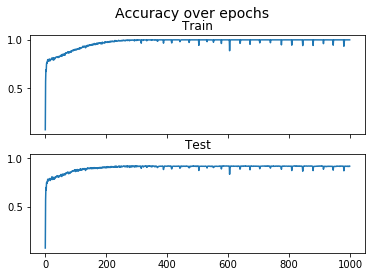

In [100]:
""" Plot """
fig, ax = plt.subplots(2, sharex=True, sharey=True)
ax[0].plot(scores_train)
ax[0].set_title('Train')
ax[1].plot(scores_test)
ax[1].set_title('Test')
fig.suptitle("Accuracy over epochs", fontsize=14)
plt.show()